In [2]:
import glob
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import folium
import geopandas
import geopy
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import KFold
import statsmodels.api as sm
from statsmodels.formula.api import ols
from statsmodels.stats.diagnostic import linear_rainbow, het_breuschpagan
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import mean_squared_error, make_scorer
%matplotlib inline



In [3]:
pd.set_option("display.max_columns", 200)
pd.set_option("display.max_rows", 200)

In [4]:
files = glob.glob("data/raw/*.csv")
names = ['lookup', 'parcel', 'resbldg', 'rpsale']
dict_dfs = {}
for x,y in zip(names, files):
    dict_dfs[x] = pd.read_csv(y, dtype=str)
lookup_df = dict_dfs['lookup']
parcel_df = dict_dfs['parcel']
resbldg_df = dict_dfs['resbldg']
rpsale_df = dict_dfs['rpsale']

In [893]:
from geopy.geocoders import Nominatim
locator = Nominatim(user_agent='myGeocoder')
location = locator.geocode('2435  S  354TH                     ST       , KING COUNTY, WA, USA')
print('Latitude = {}, Longitude = {}'.format(location.latitude, location.longitude))

Latitude = 47.28493, Longitude = -122.30216590825634


In [651]:
kent = [47.3844953, -122.1426915]

In [382]:
map2 = folium.Map(
    location=[47.5837012,-122.3984634],
    tiles='cartodbpositron',
    zoom_start=12,
)
for_map.apply(lambda row:folium.CircleMarker(location=[row["latitude"], row["longitude"]], popup=row['SalePrice']).add_to(map2), axis=1)


10        <folium.vector_layers.CircleMarker object at 0...
11        <folium.vector_layers.CircleMarker object at 0...
21        <folium.vector_layers.CircleMarker object at 0...
28        <folium.vector_layers.CircleMarker object at 0...
34        <folium.vector_layers.CircleMarker object at 0...
                                ...                        
251216    <folium.vector_layers.CircleMarker object at 0...
251219    <folium.vector_layers.CircleMarker object at 0...
251258    <folium.vector_layers.CircleMarker object at 0...
251269    <folium.vector_layers.CircleMarker object at 0...
251295    <folium.vector_layers.CircleMarker object at 0...
Length: 13955, dtype: object

First with an explore of the dataframes one by one and see which columns could potentially be dropped, important to remember this project is going to be focussed on home improvements. Some other columns will be kept for exploratory data analysis purposes. For example, you can not improve your home by changing its zipcode or location but it may be interesting to explore patterns in house prices by location regardless.

In [16]:
parcel_df.head()

,Unnamed: 0,Major,Minor,PropName,PlatName,PlatLot,PlatBlock,Range,Township,Section,QuarterSection,PropType,Area,SubArea,SpecArea,SpecSubArea,DistrictName,LevyCode,CurrentZoning,HBUAsIfVacant,HBUAsImproved,PresentUse,SqFtLot,WaterSystem,SewerSystem,Access,Topography,StreetSurface,RestrictiveSzShape,InadequateParking,PcntUnusable,Unbuildable,MtRainier,Olympics,Cascades,Territorial,SeattleSkyline,PugetSound,LakeWashington,LakeSammamish,SmallLakeRiverCreek,OtherView,WfntLocation,WfntFootage,WfntBank,WfntPoorQuality,WfntRestrictedAccess,WfntAccessRights,WfntProximityInfluence,TidelandShoreland,LotDepthFactor,TrafficNoise,AirportNoise,PowerLines,OtherNuisances,NbrBldgSites,Contamination,DNRLease,AdjacentGolfFairway,AdjacentGreenbelt,HistoricSite,CurrentUseDesignation,NativeGrowthProtEsmt,Easements,OtherDesignation,DeedRestrictions,DevelopmentRightsPurch,CoalMineHazard,CriticalDrainage,ErosionHazard,LandfillBuffer,HundredYrFloodPlain,SeismicHazard,LandslideHazard,SteepSlopeHazard,Stream,Wetland,SpeciesOfConcern,SensitiveAreaTract,WaterProblems,TranspConcurrency,OtherProblems
0,0,807841,0410,,SUMMER RIDGE DIV NO. 02,41,,6,25,22,SW,R,35,2,NaN,NaN,SAMMAMISH,2187,R4,1,1,2,7424,2,2,4,0,1,0,0,0,False,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,0,0,0,0,N,N,0,0,N,N,N,0,0,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N
1,2,755080,0015,,SANDER'S TO GILMAN PK & SALMON BAY,3,1,3,25,11,NW,R,19,1,NaN,NaN,SEATTLE,0010,SF 5000,1,1,2,5000,2,2,4,0,1,0,0,0,False,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,0,0,0,0,N,N,0,0,N,N,N,0,0,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N
2,3,888600,0135,,VASHON GARDENS ADD,21,,3,22,8,NE,R,100,3,NaN,NaN,KING COUNTY,4055,RA5,1,1,2,277041,2,1,4,0,1,0,2,0,False,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,0,0,0,0,N,N,0,0,N,N,N,0,0,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N
3,6,022603,9181,,NaN,,,3,26,2,NW,R,1,1,NaN,NaN,SHORELINE,2263,R6,1,1,2,10560,2,2,4,0,1,0,0,0,False,0,2,0,2,0,2,0,0,0,0,0,0,0,0,0,N,N,0,0,0,0,N,N,0,0,N,N,N,0,0,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N
4,7,229670,0160,,ELDORADO NORTH,16,,5,26,19,SW,R,37,2,NaN,NaN,KIRKLAND,1708,RSA 6,1,1,2,9853,2,2,4,0,1,0,2,0,False,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,0,0,0,0,N,N,0,0,N,N,N,0,0,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N


In [21]:
def concat_col(df, newcol, col1, col2):
    df[newcol] = df[col1].str.strip() + df[col2].str.strip()

In [22]:
concat_col(parcel_df, 'id', 'Major', 'Minor')

In [23]:
parcel_df.head()

,Unnamed: 0,Major,Minor,PropName,PlatName,PlatLot,PlatBlock,Range,Township,Section,QuarterSection,PropType,Area,SubArea,SpecArea,SpecSubArea,DistrictName,LevyCode,CurrentZoning,HBUAsIfVacant,HBUAsImproved,PresentUse,SqFtLot,WaterSystem,SewerSystem,Access,Topography,StreetSurface,RestrictiveSzShape,InadequateParking,PcntUnusable,Unbuildable,MtRainier,Olympics,Cascades,Territorial,SeattleSkyline,PugetSound,LakeWashington,LakeSammamish,SmallLakeRiverCreek,OtherView,WfntLocation,WfntFootage,WfntBank,WfntPoorQuality,WfntRestrictedAccess,WfntAccessRights,WfntProximityInfluence,TidelandShoreland,LotDepthFactor,TrafficNoise,AirportNoise,PowerLines,OtherNuisances,NbrBldgSites,Contamination,DNRLease,AdjacentGolfFairway,AdjacentGreenbelt,HistoricSite,CurrentUseDesignation,NativeGrowthProtEsmt,Easements,OtherDesignation,DeedRestrictions,DevelopmentRightsPurch,CoalMineHazard,CriticalDrainage,ErosionHazard,LandfillBuffer,HundredYrFloodPlain,SeismicHazard,LandslideHazard,SteepSlopeHazard,Stream,Wetland,SpeciesOfConcern,SensitiveAreaTract,WaterProblems,TranspConcurrency,OtherProblems,id
0,0,807841,0410,,SUMMER RIDGE DIV NO. 02,41,,6,25,22,SW,R,35,2,NaN,NaN,SAMMAMISH,2187,R4,1,1,2,7424,2,2,4,0,1,0,0,0,False,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,0,0,0,0,N,N,0,0,N,N,N,0,0,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,8078410410
1,2,755080,0015,,SANDER'S TO GILMAN PK & SALMON BAY,3,1,3,25,11,NW,R,19,1,NaN,NaN,SEATTLE,0010,SF 5000,1,1,2,5000,2,2,4,0,1,0,0,0,False,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,0,0,0,0,N,N,0,0,N,N,N,0,0,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,7550800015
2,3,888600,0135,,VASHON GARDENS ADD,21,,3,22,8,NE,R,100,3,NaN,NaN,KING COUNTY,4055,RA5,1,1,2,277041,2,1,4,0,1,0,2,0,False,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,0,0,0,0,N,N,0,0,N,N,N,0,0,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,8886000135
3,6,022603,9181,,NaN,,,3,26,2,NW,R,1,1,NaN,NaN,SHORELINE,2263,R6,1,1,2,10560,2,2,4,0,1,0,0,0,False,0,2,0,2,0,2,0,0,0,0,0,0,0,0,0,N,N,0,0,0,0,N,N,0,0,N,N,N,0,0,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,0226039181
4,7,229670,0160,,ELDORADO NORTH,16,,5,26,19,SW,R,37,2,NaN,NaN,KIRKLAND,1708,RSA 6,1,1,2,9853,2,2,4,0,1,0,2,0,False,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,0,0,0,0,N,N,0,0,N,N,N,0,0,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,2296700160


In [20]:
parcel_df.columns

Index(['Unnamed: 0', 'Major', 'Minor', 'PropName', 'PlatName', 'PlatLot',
       'PlatBlock', 'Range', 'Township', 'Section', 'QuarterSection',
       'PropType', 'Area', 'SubArea', 'SpecArea', 'SpecSubArea',
       'DistrictName', 'LevyCode', 'CurrentZoning', 'HBUAsIfVacant',
       'HBUAsImproved', 'PresentUse', 'SqFtLot', 'WaterSystem', 'SewerSystem',
       'Access', 'Topography', 'StreetSurface', 'RestrictiveSzShape',
       'InadequateParking', 'PcntUnusable', 'Unbuildable', 'MtRainier',
       'Olympics', 'Cascades', 'Territorial', 'SeattleSkyline', 'PugetSound',
       'LakeWashington', 'LakeSammamish', 'SmallLakeRiverCreek', 'OtherView',
       'WfntLocation', 'WfntFootage', 'WfntBank', 'WfntPoorQuality',
       'WfntRestrictedAccess', 'WfntAccessRights', 'WfntProximityInfluence',
       'TidelandShoreland', 'LotDepthFactor', 'TrafficNoise', 'AirportNoise',
       'PowerLines', 'OtherNuisances', 'NbrBldgSites', 'Contamination',
       'DNRLease', 'AdjacentGolfFairway', 'Adjace

Okay...a lot of columns,  first I will merge all the dataframes together using unique identifier (Major + Minor), keep only property types I am interested in (homes) and then filter for only data in 2019 as per project brief. This may make it easier to drop columns depending on the distribution of values within the new data. 

In [24]:
resbldg_df.head()

,Major,Minor,BldgNbr,NbrLivingUnits,Address,BuildingNumber,Fraction,DirectionPrefix,StreetName,StreetType,DirectionSuffix,ZipCode,Stories,BldgGrade,BldgGradeVar,SqFt1stFloor,SqFtHalfFloor,SqFt2ndFloor,SqFtUpperFloor,SqFtUnfinFull,SqFtUnfinHalf,SqFtTotLiving,SqFtTotBasement,SqFtFinBasement,FinBasementGrade,SqFtGarageBasement,SqFtGarageAttached,DaylightBasement,SqFtOpenPorch,SqFtEnclosedPorch,SqFtDeck,HeatSystem,HeatSource,BrickStone,ViewUtilization,Bedrooms,BathHalfCount,Bath3qtrCount,BathFullCount,FpSingleStory,FpMultiStory,FpFreestanding,FpAdditional,YrBuilt,YrRenovated,PcntComplete,Obsolescence,PcntNetCondition,Condition,AddnlCost
0,009800,0720,1,1,27719 SE 26TH WAY 98075,27719,,SE,26TH,WAY,,98075,2,11,0,1970,0,2130,0,0,0,4100,0,0,0,0,750,,0,0,0,5,2,0,,4,1,0,3,3,0,0,0,2001,0,0,0,0,3,0
1,009802,0140,1,1,2829 277TH TER SE 98075,2829,,,277TH,TER,SE,98075,2,10,0,1610,0,1400,0,0,0,3010,0,0,0,0,660,,380,0,0,5,2,0,,4,1,2,2,3,0,0,0,2004,0,0,0,0,3,0
2,009830,0020,1,1,1715 298TH CRESENT SE,1715,,,298TH CRESENT,,SE,NaN,2,10,0,2520,0,2560,0,0,0,5080,0,0,0,0,1020,,360,0,270,5,2,0,,4,0,0,5,1,0,0,0,2017,0,0,0,0,3,0
3,009830,0160,1,1,1861 297TH WAY SE 98024,1861,,,297TH,WAY,SE,98024,2,10,0,2210,0,1860,0,0,0,4070,0,0,0,0,1000,N,690,0,0,5,2,0,N,4,1,0,3,2,0,0,0,2013,0,0,0,0,3,0
4,010050,0180,1,1,35410 25TH PL S 98003,35410,,,25TH,PL,S,98003,2,7,0,910,0,700,0,0,0,1610,0,0,0,0,440,,60,0,0,5,2,0,,3,1,1,1,1,0,0,0,1994,0,0,0,0,4,0


In [25]:
concat_col(resbldg_df, 'id', 'Major', 'Minor')

In [26]:
rpsale_df.head()

,ExciseTaxNbr,Major,Minor,DocumentDate,SalePrice,RecordingNbr,Volume,Page,PlatNbr,PlatType,PlatLot,PlatBlock,SellerName,BuyerName,PropertyType,PrincipalUse,SaleInstrument,AFForestLand,AFCurrentUseLand,AFNonProfitUse,AFHistoricProperty,SaleReason,PropertyClass,SaleWarning
0,2857854,198920,1430,03/28/2017,0,20170410000541,,,,,,,AD APARTMENTS LLC ...,SEATTLE CITY OF ...,3,7,15,N,N,N,N,16,2,20 31
1,2743355,638580,0110,07/14/2015,190000,20150715002686,,,,,,,GINGRICH AUDREY B ...,NATION FRED I ...,3,6,3,N,N,N,N,1,8,15
2,2999169,919715,0200,07/08/2019,192000,20190712001080,,,,,,,WAGNERESTATES LLC ...,SCHAFFER CORBIN ...,3,2,3,N,N,N,N,1,3,
3,2841697,894677,0240,12/21/2016,818161,20161228000896,,,,,,,QUADRANT CORPORATION ...,KANG JING ...,2,6,3,N,N,N,N,1,8,
4,2826129,445872,0260,10/03/2016,0,20161004000511,,,,,,,MARCH CARL J + SUSAN A ...,MARCH CARL J + SUSAN A REVOCABLE LIVING TRUST ...,3,2,15,N,N,N,N,18,3,18 31


In [27]:
concat_col(rpsale_df, 'id', 'Major', 'Minor')

In [42]:
print(len(parcel_df))
print(len(rpsale_df))
print(len(resbldg_df))

205199
351067
181510


In [43]:
merge_df = resbldg_df.merge(parcel_df, on='id', how='inner')

In [44]:
len(merge_df)

181510

In [56]:
total_df = merge_df.merge(rpsale_df, how='left', on='id')

In [46]:
total_df.isna().sum()

Major_x                        0
Minor_x                        0
BldgNbr                        0
NbrLivingUnits                 0
Address                        0
BuildingNumber                 0
Fraction                       0
DirectionPrefix              604
StreetName                     0
StreetType                     0
DirectionSuffix              604
ZipCode                    39980
Stories                        0
BldgGrade                      0
BldgGradeVar                   0
SqFt1stFloor                   0
SqFtHalfFloor                  0
SqFt2ndFloor                   0
SqFtUpperFloor                 0
SqFtUnfinFull                  0
SqFtUnfinHalf                  0
SqFtTotLiving                  0
SqFtTotBasement                0
SqFtFinBasement                0
FinBasementGrade               0
SqFtGarageBasement             0
SqFtGarageAttached             0
DaylightBasement               0
SqFtOpenPorch                  0
SqFtEnclosedPorch              0
SqFtDeck  

In [57]:
len(total_df)

251300

Drop duplicates on ID and saleprice columns as they do not offer anything to the analysis

In [58]:
total_df.drop_duplicates(subset=['SalePrice','id'], keep='last', inplace=True)

In [59]:
len(total_df)

232669

In [60]:
len(total_df[total_df['SalePrice']=='0'])

63207

Not interested in entries where sale price is 0, so let's remove these.

In [61]:
total_df = total_df[total_df['SalePrice']!='0']

In [62]:
len(total_df)

169462

In [63]:
total_df.head()

,Major_x,Minor_x,BldgNbr,NbrLivingUnits,Address,BuildingNumber,Fraction,DirectionPrefix,StreetName,StreetType,DirectionSuffix,ZipCode,Stories,BldgGrade,BldgGradeVar,SqFt1stFloor,SqFtHalfFloor,SqFt2ndFloor,SqFtUpperFloor,SqFtUnfinFull,SqFtUnfinHalf,SqFtTotLiving,SqFtTotBasement,SqFtFinBasement,FinBasementGrade,SqFtGarageBasement,SqFtGarageAttached,DaylightBasement,SqFtOpenPorch,SqFtEnclosedPorch,SqFtDeck,HeatSystem,HeatSource,BrickStone,ViewUtilization,Bedrooms,BathHalfCount,Bath3qtrCount,BathFullCount,FpSingleStory,FpMultiStory,FpFreestanding,FpAdditional,YrBuilt,YrRenovated,PcntComplete,Obsolescence,PcntNetCondition,Condition,AddnlCost,id,Unnamed: 0,Major_y,Minor_y,PropName,PlatName,PlatLot_x,PlatBlock_x,Range,Township,Section,QuarterSection,PropType,Area,SubArea,SpecArea,SpecSubArea,DistrictName,LevyCode,CurrentZoning,HBUAsIfVacant,HBUAsImproved,PresentUse,SqFtLot,WaterSystem,SewerSystem,Access,Topography,StreetSurface,RestrictiveSzShape,InadequateParking,PcntUnusable,Unbuildable,MtRainier,Olympics,Cascades,Territorial,SeattleSkyline,PugetSound,LakeWashington,LakeSammamish,SmallLakeRiverCreek,OtherView,WfntLocation,WfntFootage,WfntBank,WfntPoorQuality,WfntRestrictedAccess,WfntAccessRights,WfntProximityInfluence,TidelandShoreland,LotDepthFactor,TrafficNoise,AirportNoise,PowerLines,OtherNuisances,NbrBldgSites,Contamination,DNRLease,AdjacentGolfFairway,AdjacentGreenbelt,HistoricSite,CurrentUseDesignation,NativeGrowthProtEsmt,Easements,OtherDesignation,DeedRestrictions,DevelopmentRightsPurch,CoalMineHazard,CriticalDrainage,ErosionHazard,LandfillBuffer,HundredYrFloodPlain,SeismicHazard,LandslideHazard,SteepSlopeHazard,Stream,Wetland,SpeciesOfConcern,SensitiveAreaTract,WaterProblems,TranspConcurrency,OtherProblems,ExciseTaxNbr,Major,Minor,DocumentDate,SalePrice,RecordingNbr,Volume,Page,PlatNbr,PlatType,PlatLot_y,PlatBlock_y,SellerName,BuyerName,PropertyType,PrincipalUse,SaleInstrument,AFForestLand,AFCurrentUseLand,AFNonProfitUse,AFHistoricProperty,SaleReason,PropertyClass,SaleWarning
0,009800,0720,1,1,27719 SE 26TH WAY 98075,27719,,SE,26TH,WAY,,98075,2,11,0,1970,0,2130,0,0,0,4100,0,0,0,0,750,,0,0,0,5,2,0,,4,1,0,3,3,0,0,0,2001,0,0,0,0,3,0,0098000720,71581,009800,0720,,ALDARRA DIV NO. 01,72,,7,24,7,NW,R,69,6,NaN,NaN,SAMMAMISH,2198,R1,1,1,2,16647,2,2,4,0,1,0,2,0,False,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,0,0,1,0,N,N,0,0,N,N,N,0,0,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,2936583,009800,0720,06/14/2018,1300000,20180618000684,,,,,,,AYRES DOUGLAS W ...,HIGGIE JOHN ...,11,6,3,N,N,N,N,1,8,
5,009830,0020,1,1,1715 298TH CRESENT SE,1715,,,298TH CRESENT,,SE,NaN,2,10,0,2520,0,2560,0,0,0,5080,0,0,0,0,1020,,360,0,270,5,2,0,,4,0,0,5,1,0,0,0,2017,0,0,0,0,3,0,0098300020,495068,009830,0020,,ALDARRA RIDGE,2,,7,24,5,SW,R,71,10,NaN,NaN,KING COUNTY,6626,RA5SO,1,1,2,128161,2,1,3,0,1,0,2,0,False,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,0,0,0,0,N,N,0,0,N,N,N,0,0,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,2922038,009830,0020,03/22/2018,1849000,20180330001320,,,,,,,LEXINGTON DEVELOPMENT INC ...,LARSEN GUY P+JODI ...,2,6,3,N,N,N,N,1,8,
6,009830,0160,1,1,1861 297TH WAY SE 98024,1861,,,297TH,WAY,SE,98024,2,10,0,2210,0,1860,0,0,0,4070,0,0,0,0,1000,N,690,0,0,5,2,0,N,4,1,0,3,2,0,0,0,2013,0,0,0,0,3,0,0098300160,169209,009830,0160,,ALDARRA RIDGE,16,,7,24,5,SW,R,71,10,NaN,NaN,KING COUNTY,6626,RA5SO,1,1,2,131325,2,1,3,0,1,0,0,0,False,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,0,0,0,0,N,N,0,0,N,N,N,0,0,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,2733643,009830,0160,05/26/2015,1229000,20150529002205,,,,,,,LEXINGTON DEVELOPMENT INC ...,SPROULL LANDON JAY+TAMMY ALEXIS SUTTERFIELD ...,2,6,3,N,N,N,N,1,8,
7,010050,0180,1,1,35410 25TH PL S 98003,35410,,,25TH,PL,S,98003,2,7,0,910,0,700,0,0,0,1610,0,0,0,0,440,,60,0,0,5,2,0,,3,1,1,1,1,0,0,0,1994,0,0,0,0,4,0,0100500180,398480,010050,0180,,ALDER GLEN,18,,4,21,28,NE,R,55,15,NaN,NaN,KING COUNTY,3490,R4,1,1,2,7470,2,2,4,0,1,0,2,0,False,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,0,0,0,0,N,N,0,0,N,N,N,0,0,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,2808722,010050,0180,07/07/2

In [65]:
total_df['Date'] = pd.to_datetime(total_df['DocumentDate'], format='%m/%d/%Y')
total_df['Date'] = pd.DatetimeIndex(total_df['Date']).year

In [66]:
total_df.head()

,Major_x,Minor_x,BldgNbr,NbrLivingUnits,Address,BuildingNumber,Fraction,DirectionPrefix,StreetName,StreetType,DirectionSuffix,ZipCode,Stories,BldgGrade,BldgGradeVar,SqFt1stFloor,SqFtHalfFloor,SqFt2ndFloor,SqFtUpperFloor,SqFtUnfinFull,SqFtUnfinHalf,SqFtTotLiving,SqFtTotBasement,SqFtFinBasement,FinBasementGrade,SqFtGarageBasement,SqFtGarageAttached,DaylightBasement,SqFtOpenPorch,SqFtEnclosedPorch,SqFtDeck,HeatSystem,HeatSource,BrickStone,ViewUtilization,Bedrooms,BathHalfCount,Bath3qtrCount,BathFullCount,FpSingleStory,FpMultiStory,FpFreestanding,FpAdditional,YrBuilt,YrRenovated,PcntComplete,Obsolescence,PcntNetCondition,Condition,AddnlCost,id,Unnamed: 0,Major_y,Minor_y,PropName,PlatName,PlatLot_x,PlatBlock_x,Range,Township,Section,QuarterSection,PropType,Area,SubArea,SpecArea,SpecSubArea,DistrictName,LevyCode,CurrentZoning,HBUAsIfVacant,HBUAsImproved,PresentUse,SqFtLot,WaterSystem,SewerSystem,Access,Topography,StreetSurface,RestrictiveSzShape,InadequateParking,PcntUnusable,Unbuildable,MtRainier,Olympics,Cascades,Territorial,SeattleSkyline,PugetSound,LakeWashington,LakeSammamish,SmallLakeRiverCreek,OtherView,WfntLocation,WfntFootage,WfntBank,WfntPoorQuality,WfntRestrictedAccess,WfntAccessRights,WfntProximityInfluence,TidelandShoreland,LotDepthFactor,TrafficNoise,AirportNoise,PowerLines,OtherNuisances,NbrBldgSites,Contamination,DNRLease,AdjacentGolfFairway,AdjacentGreenbelt,HistoricSite,CurrentUseDesignation,NativeGrowthProtEsmt,Easements,OtherDesignation,DeedRestrictions,DevelopmentRightsPurch,CoalMineHazard,CriticalDrainage,ErosionHazard,LandfillBuffer,HundredYrFloodPlain,SeismicHazard,LandslideHazard,SteepSlopeHazard,Stream,Wetland,SpeciesOfConcern,SensitiveAreaTract,WaterProblems,TranspConcurrency,OtherProblems,ExciseTaxNbr,Major,Minor,DocumentDate,SalePrice,RecordingNbr,Volume,Page,PlatNbr,PlatType,PlatLot_y,PlatBlock_y,SellerName,BuyerName,PropertyType,PrincipalUse,SaleInstrument,AFForestLand,AFCurrentUseLand,AFNonProfitUse,AFHistoricProperty,SaleReason,PropertyClass,SaleWarning,Date
0,009800,0720,1,1,27719 SE 26TH WAY 98075,27719,,SE,26TH,WAY,,98075,2,11,0,1970,0,2130,0,0,0,4100,0,0,0,0,750,,0,0,0,5,2,0,,4,1,0,3,3,0,0,0,2001,0,0,0,0,3,0,0098000720,71581,009800,0720,,ALDARRA DIV NO. 01,72,,7,24,7,NW,R,69,6,NaN,NaN,SAMMAMISH,2198,R1,1,1,2,16647,2,2,4,0,1,0,2,0,False,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,0,0,1,0,N,N,0,0,N,N,N,0,0,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,2936583,009800,0720,06/14/2018,1300000,20180618000684,,,,,,,AYRES DOUGLAS W ...,HIGGIE JOHN ...,11,6,3,N,N,N,N,1,8,,2018
5,009830,0020,1,1,1715 298TH CRESENT SE,1715,,,298TH CRESENT,,SE,NaN,2,10,0,2520,0,2560,0,0,0,5080,0,0,0,0,1020,,360,0,270,5,2,0,,4,0,0,5,1,0,0,0,2017,0,0,0,0,3,0,0098300020,495068,009830,0020,,ALDARRA RIDGE,2,,7,24,5,SW,R,71,10,NaN,NaN,KING COUNTY,6626,RA5SO,1,1,2,128161,2,1,3,0,1,0,2,0,False,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,0,0,0,0,N,N,0,0,N,N,N,0,0,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,2922038,009830,0020,03/22/2018,1849000,20180330001320,,,,,,,LEXINGTON DEVELOPMENT INC ...,LARSEN GUY P+JODI ...,2,6,3,N,N,N,N,1,8,,2018
6,009830,0160,1,1,1861 297TH WAY SE 98024,1861,,,297TH,WAY,SE,98024,2,10,0,2210,0,1860,0,0,0,4070,0,0,0,0,1000,N,690,0,0,5,2,0,N,4,1,0,3,2,0,0,0,2013,0,0,0,0,3,0,0098300160,169209,009830,0160,,ALDARRA RIDGE,16,,7,24,5,SW,R,71,10,NaN,NaN,KING COUNTY,6626,RA5SO,1,1,2,131325,2,1,3,0,1,0,0,0,False,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,0,0,0,0,N,N,0,0,N,N,N,0,0,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,2733643,009830,0160,05/26/2015,1229000,20150529002205,,,,,,,LEXINGTON DEVELOPMENT INC ...,SPROULL LANDON JAY+TAMMY ALEXIS SUTTERFIELD ...,2,6,3,N,N,N,N,1,8,,2015
7,010050,0180,1,1,35410 25TH PL S 98003,35410,,,25TH,PL,S,98003,2,7,0,910,0,700,0,0,0,1610,0,0,0,0,440,,60,0,0,5,2,0,,3,1,1,1,1,0,0,0,1994,0,0,0,0,4,0,0100500180,398480,010050,0180,,ALDER GLEN,18,,4,21,28,NE,R,55,15,NaN,NaN,KING COUNTY,3490,R4,1,1,2,7470,2,2,4,0,1,0,2,0,False,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,0,0,0,0,N,N,0,0,N,N,N,0,0,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,2808722

In [67]:
total_df = total_df[total_df['Date']==2019]

In [68]:
len(total_df)

29150

In [70]:
data_2019_homes = total_df[total_df['PropertyType']=='11']

cutting data down so only including property type 11 which according to the lookup table is household, single family unit. Looking at the value_counts for this column, there isn't alot of other residential property types anyway.

In [71]:
total_df.PropertyType.value_counts()

11    18451
3      7516
2      1344
10     1261
1       132
0       124
12      110
14       95
91       42
5        28
18       15
13        8
4         6
96        4
83        3
99        2
65        2
94        2
59        2
6         2
23        1
Name: PropertyType, dtype: int64

Now to create an address column, to convert the lat and longtitude, it may be useful.

In [72]:
data_2019_homes.StreetType.value_counts()

AVE       7422
ST        5201
PL        3350
CT         675
WAY        553
DR         479
LN         266
RD         246
BLVD        88
            42
PKWY        30
TER         27
CIR         22
HWY         15
LOOP        11
KY           9
WALK         6
CRES         5
AVCT         3
TRL          1
Name: StreetType, dtype: int64

In [74]:
data_2019_homes.StreetType.map({'AVE': 'avenue', 'ST': 'street', 'PL': 'place', 'CT': 'court',\
                                'DR': 'drive', 'LN': 'lane', 'RD':'road', 'BLVD': 'boulevard', 'PKWY': 'parkway',\
                                'TER':'terrace', 'CRES': 'cresent', 'KY':'KY', 'WALK':'WALK'})

10        NaN
11        NaN
17        NaN
21        NaN
28        NaN
         ... 
251219    NaN
251225    NaN
251258    NaN
251269    NaN
251295    NaN
Name: StreetType, Length: 18451, dtype: object

In [75]:
data_2019_homes.head()

,Major_x,Minor_x,BldgNbr,NbrLivingUnits,Address,BuildingNumber,Fraction,DirectionPrefix,StreetName,StreetType,DirectionSuffix,ZipCode,Stories,BldgGrade,BldgGradeVar,SqFt1stFloor,SqFtHalfFloor,SqFt2ndFloor,SqFtUpperFloor,SqFtUnfinFull,SqFtUnfinHalf,SqFtTotLiving,SqFtTotBasement,SqFtFinBasement,FinBasementGrade,SqFtGarageBasement,SqFtGarageAttached,DaylightBasement,SqFtOpenPorch,SqFtEnclosedPorch,SqFtDeck,HeatSystem,HeatSource,BrickStone,ViewUtilization,Bedrooms,BathHalfCount,Bath3qtrCount,BathFullCount,FpSingleStory,FpMultiStory,FpFreestanding,FpAdditional,YrBuilt,YrRenovated,PcntComplete,Obsolescence,PcntNetCondition,Condition,AddnlCost,id,Unnamed: 0,Major_y,Minor_y,PropName,PlatName,PlatLot_x,PlatBlock_x,Range,Township,Section,QuarterSection,PropType,Area,SubArea,SpecArea,SpecSubArea,DistrictName,LevyCode,CurrentZoning,HBUAsIfVacant,HBUAsImproved,PresentUse,SqFtLot,WaterSystem,SewerSystem,Access,Topography,StreetSurface,RestrictiveSzShape,InadequateParking,PcntUnusable,Unbuildable,MtRainier,Olympics,Cascades,Territorial,SeattleSkyline,PugetSound,LakeWashington,LakeSammamish,SmallLakeRiverCreek,OtherView,WfntLocation,WfntFootage,WfntBank,WfntPoorQuality,WfntRestrictedAccess,WfntAccessRights,WfntProximityInfluence,TidelandShoreland,LotDepthFactor,TrafficNoise,AirportNoise,PowerLines,OtherNuisances,NbrBldgSites,Contamination,DNRLease,AdjacentGolfFairway,AdjacentGreenbelt,HistoricSite,CurrentUseDesignation,NativeGrowthProtEsmt,Easements,OtherDesignation,DeedRestrictions,DevelopmentRightsPurch,CoalMineHazard,CriticalDrainage,ErosionHazard,LandfillBuffer,HundredYrFloodPlain,SeismicHazard,LandslideHazard,SteepSlopeHazard,Stream,Wetland,SpeciesOfConcern,SensitiveAreaTract,WaterProblems,TranspConcurrency,OtherProblems,ExciseTaxNbr,Major,Minor,DocumentDate,SalePrice,RecordingNbr,Volume,Page,PlatNbr,PlatType,PlatLot_y,PlatBlock_y,SellerName,BuyerName,PropertyType,PrincipalUse,SaleInstrument,AFForestLand,AFCurrentUseLand,AFNonProfitUse,AFHistoricProperty,SaleReason,PropertyClass,SaleWarning,Date
10,010050,0380,1,1,2435 S 354TH ST 98003,2435,,S,354TH,ST,,98003,1,7,0,1480,0,0,0,0,0,1480,0,0,0,0,440,,80,0,120,5,2,0,,3,0,0,2,1,0,0,0,1994,0,0,0,0,5,0,0100500380,359968,010050,0380,,ALDER GLEN,38,,4,21,28,NE,R,55,15,NaN,NaN,KING COUNTY,3490,R4,1,1,2,6446,2,2,4,0,1,0,2,0,False,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,0,0,0,0,N,N,0,0,N,N,N,0,0,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,3025506,010050,0380,12/12/2019,445000,20191213001173,,,,,,,VOVK CONSTRUCTION INC. ...,CENIDO AZHJELI ...,11,6,3,N,N,N,N,1,8,,2019
11,010050,0380,1,1,2435 S 354TH ST 98003,2435,,S,354TH,ST,,98003,1,7,0,1480,0,0,0,0,0,1480,0,0,0,0,440,,80,0,120,5,2,0,,3,0,0,2,1,0,0,0,1994,0,0,0,0,5,0,0100500380,359968,010050,0380,,ALDER GLEN,38,,4,21,28,NE,R,55,15,NaN,NaN,KING COUNTY,3490,R4,1,1,2,6446,2,2,4,0,1,0,2,0,False,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,0,0,0,0,N,N,0,0,N,N,N,0,0,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,3005732,010050,0380,08/16/2019,311000,20190819001381,,,,,,,GRAY DEANNA ...,VOVK CONSTRUCTION INC ...,11,6,3,N,N,N,N,1,8,26,2019
17,017900,0315,1,1,12254 43RD AVE S 98178,12254,,,43RD,AVE,S,98178,1,5,0,550,0,0,0,0,0,550,0,0,0,0,0,,0,0,0,1,1,0,,2,0,1,0,0,0,0,0,1942,0,0,0,0,3,0,0179000315,315201,017900,0315,,ALLENTOWN ADD,18,2,4,23,10,SE,R,24,5,NaN,NaN,TUKWILA,2408,LDR,1,1,2,4000,2,1,4,0,1,0,2,0,False,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,0,0,0,0,N,N,0,0,N,N,N,0,0,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,3024301,017900,0315,12/05/2019,188500,20191206000920,,,,,,,GEARHART PHILLIP E+CHARLENE L ...,KELLER ROBERT T ...,11,6,3,N,N,N,N,1,8,,2019
21,018800,0095,1,1,1602 LAKEVIEW BLVD E 98102,1602,,,LAKEVIEW,BLVD,E,98102,2,9,0,660,0,595,0,0,0,1540,380,285,8,0,0,Y,0,0,155,1,3,0,Y,3,1,1,1,0,1,0,0,1984,0,0,0,0,3,0,0188000095,245005,018800,0095,Half of Duplex,ALLMOND ADD REPLAT,7,2,4,25,20,SE,R,13,3,NaN,NaN,SEATTLE,0010,LR2 (M),1,1,29,3117,2,2,4,1,1,0,0,0,False,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,0,0,3,0,N,N,0,0,N,N,N,0,0,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,3011585,018800,0095,08/30/2019,73000

In [76]:
data_2019_homes.isna().sum()

Major_x                       0
Minor_x                       0
BldgNbr                       0
NbrLivingUnits                0
Address                       0
BuildingNumber                0
Fraction                      0
DirectionPrefix              14
StreetName                    0
StreetType                    0
DirectionSuffix              14
ZipCode                    2418
Stories                       0
BldgGrade                     0
BldgGradeVar                  0
SqFt1stFloor                  0
SqFtHalfFloor                 0
SqFt2ndFloor                  0
SqFtUpperFloor                0
SqFtUnfinFull                 0
SqFtUnfinHalf                 0
SqFtTotLiving                 0
SqFtTotBasement               0
SqFtFinBasement               0
FinBasementGrade              0
SqFtGarageBasement            0
SqFtGarageAttached            0
DaylightBasement              0
SqFtOpenPorch                 0
SqFtEnclosedPorch             0
SqFtDeck                      0
HeatSyst

In [84]:
data_2019_homes['StreetType']= data_2019_homes['StreetType'].str.strip()

<ipython-input-84-ed352c2e1613>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_2019_homes['StreetType']= data_2019_homes['StreetType'].str.strip()


In [89]:
data_2019_homes['StreetType'] = data_2019_homes.StreetType.map({'AVE': 'avenue', 'ST': 'street', 'PL': 'place', 'CT': 'court', 'DR': 'drive', 'LN': 'lane', 'RD':'road'\
                    , 'BLVD': 'boulevard', 'PKWY': 'parkway', 'TER':'terrace', 'CRES': 'crescent'})

<ipython-input-89-b5d7fbb2e445>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_2019_homes['StreetType'] = data_2019_homes.StreetType.map({'AVE': 'avenue', 'ST': 'street', 'PL': 'place', 'CT': 'court', 'DR': 'drive', 'LN': 'lane', 'RD':'road'\


In [87]:
data_2019_homes.head()

,Major_x,Minor_x,BldgNbr,NbrLivingUnits,Address,BuildingNumber,Fraction,DirectionPrefix,StreetName,StreetType,DirectionSuffix,ZipCode,Stories,BldgGrade,BldgGradeVar,SqFt1stFloor,SqFtHalfFloor,SqFt2ndFloor,SqFtUpperFloor,SqFtUnfinFull,SqFtUnfinHalf,SqFtTotLiving,SqFtTotBasement,SqFtFinBasement,FinBasementGrade,SqFtGarageBasement,SqFtGarageAttached,DaylightBasement,SqFtOpenPorch,SqFtEnclosedPorch,SqFtDeck,HeatSystem,HeatSource,BrickStone,ViewUtilization,Bedrooms,BathHalfCount,Bath3qtrCount,BathFullCount,FpSingleStory,FpMultiStory,FpFreestanding,FpAdditional,YrBuilt,YrRenovated,PcntComplete,Obsolescence,PcntNetCondition,Condition,AddnlCost,id,Unnamed: 0,Major_y,Minor_y,PropName,PlatName,PlatLot_x,PlatBlock_x,Range,Township,Section,QuarterSection,PropType,Area,SubArea,SpecArea,SpecSubArea,DistrictName,LevyCode,CurrentZoning,HBUAsIfVacant,HBUAsImproved,PresentUse,SqFtLot,WaterSystem,SewerSystem,Access,Topography,StreetSurface,RestrictiveSzShape,InadequateParking,PcntUnusable,Unbuildable,MtRainier,Olympics,Cascades,Territorial,SeattleSkyline,PugetSound,LakeWashington,LakeSammamish,SmallLakeRiverCreek,OtherView,WfntLocation,WfntFootage,WfntBank,WfntPoorQuality,WfntRestrictedAccess,WfntAccessRights,WfntProximityInfluence,TidelandShoreland,LotDepthFactor,TrafficNoise,AirportNoise,PowerLines,OtherNuisances,NbrBldgSites,Contamination,DNRLease,AdjacentGolfFairway,AdjacentGreenbelt,HistoricSite,CurrentUseDesignation,NativeGrowthProtEsmt,Easements,OtherDesignation,DeedRestrictions,DevelopmentRightsPurch,CoalMineHazard,CriticalDrainage,ErosionHazard,LandfillBuffer,HundredYrFloodPlain,SeismicHazard,LandslideHazard,SteepSlopeHazard,Stream,Wetland,SpeciesOfConcern,SensitiveAreaTract,WaterProblems,TranspConcurrency,OtherProblems,ExciseTaxNbr,Major,Minor,DocumentDate,SalePrice,RecordingNbr,Volume,Page,PlatNbr,PlatType,PlatLot_y,PlatBlock_y,SellerName,BuyerName,PropertyType,PrincipalUse,SaleInstrument,AFForestLand,AFCurrentUseLand,AFNonProfitUse,AFHistoricProperty,SaleReason,PropertyClass,SaleWarning,Date
10,010050,0380,1,1,2435 S 354TH ST 98003,2435,,S,354TH,ST,,98003,1,7,0,1480,0,0,0,0,0,1480,0,0,0,0,440,,80,0,120,5,2,0,,3,0,0,2,1,0,0,0,1994,0,0,0,0,5,0,0100500380,359968,010050,0380,,ALDER GLEN,38,,4,21,28,NE,R,55,15,NaN,NaN,KING COUNTY,3490,R4,1,1,2,6446,2,2,4,0,1,0,2,0,False,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,0,0,0,0,N,N,0,0,N,N,N,0,0,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,3025506,010050,0380,12/12/2019,445000,20191213001173,,,,,,,VOVK CONSTRUCTION INC. ...,CENIDO AZHJELI ...,11,6,3,N,N,N,N,1,8,,2019
11,010050,0380,1,1,2435 S 354TH ST 98003,2435,,S,354TH,ST,,98003,1,7,0,1480,0,0,0,0,0,1480,0,0,0,0,440,,80,0,120,5,2,0,,3,0,0,2,1,0,0,0,1994,0,0,0,0,5,0,0100500380,359968,010050,0380,,ALDER GLEN,38,,4,21,28,NE,R,55,15,NaN,NaN,KING COUNTY,3490,R4,1,1,2,6446,2,2,4,0,1,0,2,0,False,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,0,0,0,0,N,N,0,0,N,N,N,0,0,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,3005732,010050,0380,08/16/2019,311000,20190819001381,,,,,,,GRAY DEANNA ...,VOVK CONSTRUCTION INC ...,11,6,3,N,N,N,N,1,8,26,2019
17,017900,0315,1,1,12254 43RD AVE S 98178,12254,,,43RD,AVE,S,98178,1,5,0,550,0,0,0,0,0,550,0,0,0,0,0,,0,0,0,1,1,0,,2,0,1,0,0,0,0,0,1942,0,0,0,0,3,0,0179000315,315201,017900,0315,,ALLENTOWN ADD,18,2,4,23,10,SE,R,24,5,NaN,NaN,TUKWILA,2408,LDR,1,1,2,4000,2,1,4,0,1,0,2,0,False,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,0,0,0,0,N,N,0,0,N,N,N,0,0,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,3024301,017900,0315,12/05/2019,188500,20191206000920,,,,,,,GEARHART PHILLIP E+CHARLENE L ...,KELLER ROBERT T ...,11,6,3,N,N,N,N,1,8,,2019
21,018800,0095,1,1,1602 LAKEVIEW BLVD E 98102,1602,,,LAKEVIEW,BLVD,E,98102,2,9,0,660,0,595,0,0,0,1540,380,285,8,0,0,Y,0,0,155,1,3,0,Y,3,1,1,1,0,1,0,0,1984,0,0,0,0,3,0,0188000095,245005,018800,0095,Half of Duplex,ALLMOND ADD REPLAT,7,2,4,25,20,SE,R,13,3,NaN,NaN,SEATTLE,0010,LR2 (M),1,1,29,3117,2,2,4,1,1,0,0,0,False,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,0,0,3,0,N,N,0,0,N,N,N,0,0,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,3011585,018800,0095,08/30/2019,73000

In [90]:
data_2019_homes.head()

,Major_x,Minor_x,BldgNbr,NbrLivingUnits,Address,BuildingNumber,Fraction,DirectionPrefix,StreetName,StreetType,DirectionSuffix,ZipCode,Stories,BldgGrade,BldgGradeVar,SqFt1stFloor,SqFtHalfFloor,SqFt2ndFloor,SqFtUpperFloor,SqFtUnfinFull,SqFtUnfinHalf,SqFtTotLiving,SqFtTotBasement,SqFtFinBasement,FinBasementGrade,SqFtGarageBasement,SqFtGarageAttached,DaylightBasement,SqFtOpenPorch,SqFtEnclosedPorch,SqFtDeck,HeatSystem,HeatSource,BrickStone,ViewUtilization,Bedrooms,BathHalfCount,Bath3qtrCount,BathFullCount,FpSingleStory,FpMultiStory,FpFreestanding,FpAdditional,YrBuilt,YrRenovated,PcntComplete,Obsolescence,PcntNetCondition,Condition,AddnlCost,id,Unnamed: 0,Major_y,Minor_y,PropName,PlatName,PlatLot_x,PlatBlock_x,Range,Township,Section,QuarterSection,PropType,Area,SubArea,SpecArea,SpecSubArea,DistrictName,LevyCode,CurrentZoning,HBUAsIfVacant,HBUAsImproved,PresentUse,SqFtLot,WaterSystem,SewerSystem,Access,Topography,StreetSurface,RestrictiveSzShape,InadequateParking,PcntUnusable,Unbuildable,MtRainier,Olympics,Cascades,Territorial,SeattleSkyline,PugetSound,LakeWashington,LakeSammamish,SmallLakeRiverCreek,OtherView,WfntLocation,WfntFootage,WfntBank,WfntPoorQuality,WfntRestrictedAccess,WfntAccessRights,WfntProximityInfluence,TidelandShoreland,LotDepthFactor,TrafficNoise,AirportNoise,PowerLines,OtherNuisances,NbrBldgSites,Contamination,DNRLease,AdjacentGolfFairway,AdjacentGreenbelt,HistoricSite,CurrentUseDesignation,NativeGrowthProtEsmt,Easements,OtherDesignation,DeedRestrictions,DevelopmentRightsPurch,CoalMineHazard,CriticalDrainage,ErosionHazard,LandfillBuffer,HundredYrFloodPlain,SeismicHazard,LandslideHazard,SteepSlopeHazard,Stream,Wetland,SpeciesOfConcern,SensitiveAreaTract,WaterProblems,TranspConcurrency,OtherProblems,ExciseTaxNbr,Major,Minor,DocumentDate,SalePrice,RecordingNbr,Volume,Page,PlatNbr,PlatType,PlatLot_y,PlatBlock_y,SellerName,BuyerName,PropertyType,PrincipalUse,SaleInstrument,AFForestLand,AFCurrentUseLand,AFNonProfitUse,AFHistoricProperty,SaleReason,PropertyClass,SaleWarning,Date
10,010050,0380,1,1,2435 S 354TH ST 98003,2435,,S,354TH,street,,98003,1,7,0,1480,0,0,0,0,0,1480,0,0,0,0,440,,80,0,120,5,2,0,,3,0,0,2,1,0,0,0,1994,0,0,0,0,5,0,0100500380,359968,010050,0380,,ALDER GLEN,38,,4,21,28,NE,R,55,15,NaN,NaN,KING COUNTY,3490,R4,1,1,2,6446,2,2,4,0,1,0,2,0,False,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,0,0,0,0,N,N,0,0,N,N,N,0,0,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,3025506,010050,0380,12/12/2019,445000,20191213001173,,,,,,,VOVK CONSTRUCTION INC. ...,CENIDO AZHJELI ...,11,6,3,N,N,N,N,1,8,,2019
11,010050,0380,1,1,2435 S 354TH ST 98003,2435,,S,354TH,street,,98003,1,7,0,1480,0,0,0,0,0,1480,0,0,0,0,440,,80,0,120,5,2,0,,3,0,0,2,1,0,0,0,1994,0,0,0,0,5,0,0100500380,359968,010050,0380,,ALDER GLEN,38,,4,21,28,NE,R,55,15,NaN,NaN,KING COUNTY,3490,R4,1,1,2,6446,2,2,4,0,1,0,2,0,False,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,0,0,0,0,N,N,0,0,N,N,N,0,0,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,3005732,010050,0380,08/16/2019,311000,20190819001381,,,,,,,GRAY DEANNA ...,VOVK CONSTRUCTION INC ...,11,6,3,N,N,N,N,1,8,26,2019
17,017900,0315,1,1,12254 43RD AVE S 98178,12254,,,43RD,avenue,S,98178,1,5,0,550,0,0,0,0,0,550,0,0,0,0,0,,0,0,0,1,1,0,,2,0,1,0,0,0,0,0,1942,0,0,0,0,3,0,0179000315,315201,017900,0315,,ALLENTOWN ADD,18,2,4,23,10,SE,R,24,5,NaN,NaN,TUKWILA,2408,LDR,1,1,2,4000,2,1,4,0,1,0,2,0,False,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,0,0,0,0,N,N,0,0,N,N,N,0,0,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,3024301,017900,0315,12/05/2019,188500,20191206000920,,,,,,,GEARHART PHILLIP E+CHARLENE L ...,KELLER ROBERT T ...,11,6,3,N,N,N,N,1,8,,2019
21,018800,0095,1,1,1602 LAKEVIEW BLVD E 98102,1602,,,LAKEVIEW,boulevard,E,98102,2,9,0,660,0,595,0,0,0,1540,380,285,8,0,0,Y,0,0,155,1,3,0,Y,3,1,1,1,0,1,0,0,1984,0,0,0,0,3,0,0188000095,245005,018800,0095,Half of Duplex,ALLMOND ADD REPLAT,7,2,4,25,20,SE,R,13,3,NaN,NaN,SEATTLE,0010,LR2 (M),1,1,29,3117,2,2,4,1,1,0,0,0,False,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,0,0,3,0,N,N,0,0,N,N,N,0,0,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,3011585,018800,0095,

In [94]:
data_2019_homes[data_2019_homes['StreetType'].isna()]

,Major_x,Minor_x,BldgNbr,NbrLivingUnits,Address,BuildingNumber,Fraction,DirectionPrefix,StreetName,StreetType,DirectionSuffix,ZipCode,Stories,BldgGrade,BldgGradeVar,SqFt1stFloor,SqFtHalfFloor,SqFt2ndFloor,SqFtUpperFloor,SqFtUnfinFull,SqFtUnfinHalf,SqFtTotLiving,SqFtTotBasement,SqFtFinBasement,FinBasementGrade,SqFtGarageBasement,SqFtGarageAttached,DaylightBasement,SqFtOpenPorch,SqFtEnclosedPorch,SqFtDeck,HeatSystem,HeatSource,BrickStone,ViewUtilization,Bedrooms,BathHalfCount,Bath3qtrCount,BathFullCount,FpSingleStory,FpMultiStory,FpFreestanding,FpAdditional,YrBuilt,YrRenovated,PcntComplete,Obsolescence,PcntNetCondition,Condition,AddnlCost,id,Unnamed: 0,Major_y,Minor_y,PropName,PlatName,PlatLot_x,PlatBlock_x,Range,Township,Section,QuarterSection,PropType,Area,SubArea,SpecArea,SpecSubArea,DistrictName,LevyCode,CurrentZoning,HBUAsIfVacant,HBUAsImproved,PresentUse,SqFtLot,WaterSystem,SewerSystem,Access,Topography,StreetSurface,RestrictiveSzShape,InadequateParking,PcntUnusable,Unbuildable,MtRainier,Olympics,Cascades,Territorial,SeattleSkyline,PugetSound,LakeWashington,LakeSammamish,SmallLakeRiverCreek,OtherView,WfntLocation,WfntFootage,WfntBank,WfntPoorQuality,WfntRestrictedAccess,WfntAccessRights,WfntProximityInfluence,TidelandShoreland,LotDepthFactor,TrafficNoise,AirportNoise,PowerLines,OtherNuisances,NbrBldgSites,Contamination,DNRLease,AdjacentGolfFairway,AdjacentGreenbelt,HistoricSite,CurrentUseDesignation,NativeGrowthProtEsmt,Easements,OtherDesignation,DeedRestrictions,DevelopmentRightsPurch,CoalMineHazard,CriticalDrainage,ErosionHazard,LandfillBuffer,HundredYrFloodPlain,SeismicHazard,LandslideHazard,SteepSlopeHazard,Stream,Wetland,SpeciesOfConcern,SensitiveAreaTract,WaterProblems,TranspConcurrency,OtherProblems,ExciseTaxNbr,Major,Minor,DocumentDate,SalePrice,RecordingNbr,Volume,Page,PlatNbr,PlatType,PlatLot_y,PlatBlock_y,SellerName,BuyerName,PropertyType,PrincipalUse,SaleInstrument,AFForestLand,AFCurrentUseLand,AFNonProfitUse,AFHistoricProperty,SaleReason,PropertyClass,SaleWarning,Date
680,009830,0030,1,1,1827 298TH CRESENT SE 98024,1827,,,298TH CRESENT,NaN,SE,98024,2,10,0,2560,0,2220,0,0,0,4780,0,0,0,0,1230,,670,0,0,7,2,0,,4,0,0,5,2,0,0,0,2016,0,0,0,0,3,0,0098300030,487615,009830,0030,,ALDARRA RIDGE,3,,7,24,5,SW,R,71,10,NaN,NaN,KING COUNTY,6626,RA5SO,1,1,2,126925,2,1,3,0,1,0,2,0,False,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,0,0,0,0,N,N,0,0,N,N,N,0,0,N,Y,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,3028536,009830,0030,12/17/2019,1625000,,,,,,,,DWORKIN STEPHEN A+CHION ANTONIA ...,HASER TIMOTHY+JENNY ...,11,6,3,N,N,N,N,1,8,,2019
1451,009800,0950,1,1,27739 SE 24TH WAY 98075,27739,,SE,24TH,NaN,,98075,2,11,0,2170,0,1970,0,0,0,4140,0,0,0,0,900,N,90,0,0,5,2,0,N,4,1,1,4,3,0,0,0,2005,0,0,0,0,3,0,0098000950,193441,009800,0950,,ALDARRA DIV NO. 01,95,,7,24,7,NW,R,69,6,NaN,NaN,SAMMAMISH,2198,R1,1,1,2,14757,2,2,4,0,1,0,2,0,False,0,0,2,2,0,0,0,0,0,0,0,0,0,0,0,N,N,0,0,0,0,N,N,0,0,N,N,Y,0,0,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,2981254,009800,0950,03/26/2019,1285500,20190408000817,,,,,,,JEROSLOW MICHAEL+HAVA ...,CLARK RICHARD T+SOLTAU-CLARK TRACI C ...,11,6,3,N,N,N,N,1,8,,2019
1492,012202,9018,1,1,20210 WESTSIDE HWY SW 98070,20210,,,WESTSIDE,NaN,SW,98070,2,7,0,1988,0,1680,0,0,0,3668,0,0,0,0,0,N,264,0,0,3,3,0,N,4,1,0,2,0,0,1,0,1986,2006,0,0,0,3,0,0122029018,194255,012202,9018,,NaN,,,2,22,1,SW,R,100,3,NaN,NaN,KING COUNTY,4045,RA5,1,1,2,209959,1,1,4,0,1,0,2,0,False,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,0,0,0,0,N,N,0,0,N,N,N,0,0,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,2986401,012202,9018,05/02/2019,680000,,,,,,,,GUILD MORTGAGE COMPANY ...,LAVIGUEUR JUDITH R+ROBERT E ...,11,6,3,N,N,N,N,1,8,,2019
1766,102504,9264,1,1,4701 SAND POINT WAY NE,4701,,,SAND POINT,NaN,NE,NaN,2,8,0,620,0,540,0,0,0,1520,570,360,8,210,0,N,0,0,60,5,2,0,,3,1,0,2,0,0,0,0,2006,0,0,0,0,3,0,1025049264,600436,102504,9264,,NaN,,,4,25,10,SW,R,44,3,NaN,NaN,SEATTLE,0010,LR3 (M),1,1,29,1669,2,2,4,0,1,1,2,0,False,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,0,0,2,0,N,N,0,0,N,N,N,0,0,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,

In [194]:
data_2019_homes['address'] = data_2019_homes['BuildingNumber'] + ' '+ data_2019_homes['DirectionPrefix']+' '\
                            + data_2019_homes['StreetName'] + ' ' + data_2019_homes['StreetType']\
                            + ' ' + data_2019_homes['DirectionSuffix'] + ',' + ' ' + data_2019_homes['DistrictName']\
                            + ', WA' + ', USA'

<ipython-input-194-22bb95d2c7a7>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_2019_homes['address'] = data_2019_homes['BuildingNumber'] + ' '+ data_2019_homes['DirectionPrefix']+' ' + data_2019_homes['StreetName'] + ' ' + data_2019_homes['StreetType']\


In [187]:
print(data_2019_homes['address'].head())

10    2435  S  354TH                     street   , ...
11    2435  S  354TH                     street   , ...
17    12254    43RD                      avenue S , ...
21    1602     LAKEVIEW                  boulevard E...
28    4520     88TH                      avenue SE, ...
Name: address, dtype: object


In [133]:
from geopy.extra.rate_limiter import RateLimiter

# 1 - conveneint function to delay between geocoding calls
geocode = RateLimiter(locator.geocode, min_delay_seconds=1)
# 2- - create location column
data_2019_homes['location'] = data_2019_homes['address'].apply(geocode)
# 3 - create longitude, laatitude and altitude from location column (returns tuple)
data_2019_homes['point'] = data_2019_homes['location'].apply(lambda loc: tuple(loc.point) if loc else None)
# 4 - split point column into latitude, longitude and altitude columns
data_2019_homes[['latitude', 'longitude', 'altitude']] = pd.DataFrame(data_2019_homes['point'].tolist(), index=data_2019_homes.index)

<ipython-input-133-e955aa18937a>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_2019_homes['location'] = data_2019_homes['address'].apply(geocode)
<ipython-input-133-e955aa18937a>:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_2019_homes['point'] = data_2019_homes['location'].apply(lambda loc: tuple(loc.point) if loc else None)
C:\Users\Andrew\anaconda3\envs\geo-env\lib\site-packages\pandas\core\frame.py:3188: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Dat

In [131]:
total_df['address'] = 0

In [132]:
total_df['address']

10        0
11        0
17        0
21        0
22        0
         ..
251269    0
251274    0
251286    0
251293    0
251295    0
Name: address, Length: 29150, dtype: int64

In [189]:
data_2019_homes.head()

,Major_x,Minor_x,BldgNbr,NbrLivingUnits,Address,BuildingNumber,Fraction,DirectionPrefix,StreetName,StreetType,DirectionSuffix,ZipCode,Stories,BldgGrade,BldgGradeVar,SqFt1stFloor,SqFtHalfFloor,SqFt2ndFloor,SqFtUpperFloor,SqFtUnfinFull,SqFtUnfinHalf,SqFtTotLiving,SqFtTotBasement,SqFtFinBasement,FinBasementGrade,SqFtGarageBasement,SqFtGarageAttached,DaylightBasement,SqFtOpenPorch,SqFtEnclosedPorch,SqFtDeck,HeatSystem,HeatSource,BrickStone,ViewUtilization,Bedrooms,BathHalfCount,Bath3qtrCount,BathFullCount,FpSingleStory,FpMultiStory,FpFreestanding,FpAdditional,YrBuilt,YrRenovated,PcntComplete,Obsolescence,PcntNetCondition,Condition,AddnlCost,id,Unnamed: 0,Major_y,Minor_y,PropName,PlatName,PlatLot_x,PlatBlock_x,Range,Township,Section,QuarterSection,PropType,Area,SubArea,SpecArea,SpecSubArea,DistrictName,LevyCode,CurrentZoning,HBUAsIfVacant,HBUAsImproved,PresentUse,SqFtLot,WaterSystem,SewerSystem,Access,Topography,StreetSurface,RestrictiveSzShape,InadequateParking,PcntUnusable,Unbuildable,MtRainier,Olympics,Cascades,Territorial,SeattleSkyline,PugetSound,LakeWashington,LakeSammamish,SmallLakeRiverCreek,OtherView,WfntLocation,WfntFootage,WfntBank,WfntPoorQuality,WfntRestrictedAccess,WfntAccessRights,WfntProximityInfluence,TidelandShoreland,LotDepthFactor,TrafficNoise,AirportNoise,PowerLines,OtherNuisances,NbrBldgSites,Contamination,DNRLease,AdjacentGolfFairway,AdjacentGreenbelt,HistoricSite,CurrentUseDesignation,NativeGrowthProtEsmt,Easements,OtherDesignation,DeedRestrictions,DevelopmentRightsPurch,CoalMineHazard,CriticalDrainage,ErosionHazard,LandfillBuffer,HundredYrFloodPlain,SeismicHazard,LandslideHazard,SteepSlopeHazard,Stream,Wetland,SpeciesOfConcern,SensitiveAreaTract,WaterProblems,TranspConcurrency,OtherProblems,ExciseTaxNbr,Major,Minor,DocumentDate,SalePrice,RecordingNbr,Volume,Page,PlatNbr,PlatType,PlatLot_y,PlatBlock_y,SellerName,BuyerName,PropertyType,PrincipalUse,SaleInstrument,AFForestLand,AFCurrentUseLand,AFNonProfitUse,AFHistoricProperty,SaleReason,PropertyClass,SaleWarning,Date,address,location,point,latitude,longitude,altitude
10,010050,0380,1,1,2435 S 354TH ST 98003,2435,,S,354TH,street,,98003,1,7,0,1480,0,0,0,0,0,1480,0,0,0,0,440,,80,0,120,5,2,0,,3,0,0,2,1,0,0,0,1994,0,0,0,0,5,0,0100500380,359968,010050,0380,,ALDER GLEN,38,,4,21,28,NE,R,55,15,NaN,NaN,KING COUNTY,3490,R4,1,1,2,6446,2,2,4,0,1,0,2,0,False,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,0,0,0,0,N,N,0,0,N,N,N,0,0,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,3025506,010050,0380,12/12/2019,445000,20191213001173,,,,,,,VOVK CONSTRUCTION INC. ...,CENIDO AZHJELI ...,11,6,3,N,N,N,N,1,8,,2019,"2435 S 354TH street , ...","(2435, South 354th Street, Emery Woods, Federa...","(47.28493, -122.30216590825634, 0.0)",47.284930,-122.302166,0.0
11,010050,0380,1,1,2435 S 354TH ST 98003,2435,,S,354TH,street,,98003,1,7,0,1480,0,0,0,0,0,1480,0,0,0,0,440,,80,0,120,5,2,0,,3,0,0,2,1,0,0,0,1994,0,0,0,0,5,0,0100500380,359968,010050,0380,,ALDER GLEN,38,,4,21,28,NE,R,55,15,NaN,NaN,KING COUNTY,3490,R4,1,1,2,6446,2,2,4,0,1,0,2,0,False,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,0,0,0,0,N,N,0,0,N,N,N,0,0,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,3005732,010050,0380,08/16/2019,311000,20190819001381,,,,,,,GRAY DEANNA ...,VOVK CONSTRUCTION INC ...,11,6,3,N,N,N,N,1,8,26,2019,"2435 S 354TH street , ...","(2435, South 354th Street, Emery Woods, Federa...","(47.28493, -122.30216590825634, 0.0)",47.284930,-122.302166,0.0
17,017900,0315,1,1,12254 43RD AVE S 98178,12254,,,43RD,avenue,S,98178,1,5,0,550,0,0,0,0,0,550,0,0,0,0,0,,0,0,0,1,1,0,,2,0,1,0,0,0,0,0,1942,0,0,0,0,3,0,0179000315,315201,017900,0315,,ALLENTOWN ADD,18,2,4,23,10,SE,R,24,5,NaN,NaN,TUKWILA,2408,LDR,1,1,2,4000,2,1,4,0,1,0,2,0,False,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,0,0,0,0,N,N,0,0,N,N,N,0,0,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,3024301,017900,0315,12/05/2019,188500,20191206000920,,,,,,,GEARHART PHILLIP E+CHARLENE L ...,KELLER ROBERT T ...,11,6,3,N,N,N,N,1,8,,2019,"12254 43RD avenue S , ...","(43rd Avenue, Gig Harbor, Pierce County, Washi...","(47.348322, -122.59

In [144]:
import folium.plugins as plugins
plugins.FastMarkerCluster(data=list(zip(map_df['latitude'].values, map_df['longitude'].values))).add_to(map1)
folium.LayerControl().add_to(map1)

In [138]:
data_2019_homes.longitude.isna().sum()

1334

In [139]:
map_df = data_2019_homes.copy()

In [140]:
map_df.to_csv('map.csv')

In [142]:
map_df.dropna(subset=['longitude'], inplace=True)

In [143]:
map_df.longitude.isna().sum()

0

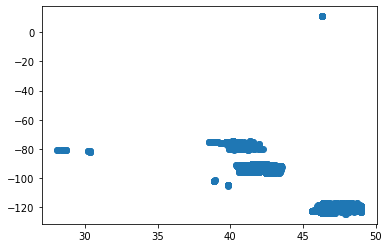

In [146]:
plt.scatter(map_df['latitude'],map_df['longitude'])

In [147]:
len(map_df)

17117

In [195]:
data_2019_homes.to_csv('address.csv')

In [197]:
data_2019_homes.head()

,Major_x,Minor_x,BldgNbr,NbrLivingUnits,Address,BuildingNumber,Fraction,DirectionPrefix,StreetName,StreetType,DirectionSuffix,ZipCode,Stories,BldgGrade,BldgGradeVar,SqFt1stFloor,SqFtHalfFloor,SqFt2ndFloor,SqFtUpperFloor,SqFtUnfinFull,SqFtUnfinHalf,SqFtTotLiving,SqFtTotBasement,SqFtFinBasement,FinBasementGrade,SqFtGarageBasement,SqFtGarageAttached,DaylightBasement,SqFtOpenPorch,SqFtEnclosedPorch,SqFtDeck,HeatSystem,HeatSource,BrickStone,ViewUtilization,Bedrooms,BathHalfCount,Bath3qtrCount,BathFullCount,FpSingleStory,FpMultiStory,FpFreestanding,FpAdditional,YrBuilt,YrRenovated,PcntComplete,Obsolescence,PcntNetCondition,Condition,AddnlCost,id,Unnamed: 0,Major_y,Minor_y,PropName,PlatName,PlatLot_x,PlatBlock_x,Range,Township,Section,QuarterSection,PropType,Area,SubArea,SpecArea,SpecSubArea,DistrictName,LevyCode,CurrentZoning,HBUAsIfVacant,HBUAsImproved,PresentUse,SqFtLot,WaterSystem,SewerSystem,Access,Topography,StreetSurface,RestrictiveSzShape,InadequateParking,PcntUnusable,Unbuildable,MtRainier,Olympics,Cascades,Territorial,SeattleSkyline,PugetSound,LakeWashington,LakeSammamish,SmallLakeRiverCreek,OtherView,WfntLocation,WfntFootage,WfntBank,WfntPoorQuality,WfntRestrictedAccess,WfntAccessRights,WfntProximityInfluence,TidelandShoreland,LotDepthFactor,TrafficNoise,AirportNoise,PowerLines,OtherNuisances,NbrBldgSites,Contamination,DNRLease,AdjacentGolfFairway,AdjacentGreenbelt,HistoricSite,CurrentUseDesignation,NativeGrowthProtEsmt,Easements,OtherDesignation,DeedRestrictions,DevelopmentRightsPurch,CoalMineHazard,CriticalDrainage,ErosionHazard,LandfillBuffer,HundredYrFloodPlain,SeismicHazard,LandslideHazard,SteepSlopeHazard,Stream,Wetland,SpeciesOfConcern,SensitiveAreaTract,WaterProblems,TranspConcurrency,OtherProblems,ExciseTaxNbr,Major,Minor,DocumentDate,SalePrice,RecordingNbr,Volume,Page,PlatNbr,PlatType,PlatLot_y,PlatBlock_y,SellerName,BuyerName,PropertyType,PrincipalUse,SaleInstrument,AFForestLand,AFCurrentUseLand,AFNonProfitUse,AFHistoricProperty,SaleReason,PropertyClass,SaleWarning,Date,address,location,point,latitude,longitude,altitude
10,010050,0380,1,1,2435 S 354TH ST 98003,2435,,S,354TH,street,,98003,1,7,0,1480,0,0,0,0,0,1480,0,0,0,0,440,,80,0,120,5,2,0,,3,0,0,2,1,0,0,0,1994,0,0,0,0,5,0,0100500380,359968,010050,0380,,ALDER GLEN,38,,4,21,28,NE,R,55,15,NaN,NaN,KING COUNTY,3490,R4,1,1,2,6446,2,2,4,0,1,0,2,0,False,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,0,0,0,0,N,N,0,0,N,N,N,0,0,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,3025506,010050,0380,12/12/2019,445000,20191213001173,,,,,,,VOVK CONSTRUCTION INC. ...,CENIDO AZHJELI ...,11,6,3,N,N,N,N,1,8,,2019,"2435 S 354TH street , ...","(2435, South 354th Street, Emery Woods, Federa...","(47.28493, -122.30216590825634, 0.0)",47.284930,-122.302166,0.0
11,010050,0380,1,1,2435 S 354TH ST 98003,2435,,S,354TH,street,,98003,1,7,0,1480,0,0,0,0,0,1480,0,0,0,0,440,,80,0,120,5,2,0,,3,0,0,2,1,0,0,0,1994,0,0,0,0,5,0,0100500380,359968,010050,0380,,ALDER GLEN,38,,4,21,28,NE,R,55,15,NaN,NaN,KING COUNTY,3490,R4,1,1,2,6446,2,2,4,0,1,0,2,0,False,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,0,0,0,0,N,N,0,0,N,N,N,0,0,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,3005732,010050,0380,08/16/2019,311000,20190819001381,,,,,,,GRAY DEANNA ...,VOVK CONSTRUCTION INC ...,11,6,3,N,N,N,N,1,8,26,2019,"2435 S 354TH street , ...","(2435, South 354th Street, Emery Woods, Federa...","(47.28493, -122.30216590825634, 0.0)",47.284930,-122.302166,0.0
17,017900,0315,1,1,12254 43RD AVE S 98178,12254,,,43RD,avenue,S,98178,1,5,0,550,0,0,0,0,0,550,0,0,0,0,0,,0,0,0,1,1,0,,2,0,1,0,0,0,0,0,1942,0,0,0,0,3,0,0179000315,315201,017900,0315,,ALLENTOWN ADD,18,2,4,23,10,SE,R,24,5,NaN,NaN,TUKWILA,2408,LDR,1,1,2,4000,2,1,4,0,1,0,2,0,False,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,0,0,0,0,N,N,0,0,N,N,N,0,0,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,3024301,017900,0315,12/05/2019,188500,20191206000920,,,,,,,GEARHART PHILLIP E+CHARLENE L ...,KELLER ROBERT T ...,11,6,3,N,N,N,N,1,8,,2019,"12254 43RD avenue S , ...","(43rd Avenue, Gig Harbor, Pierce County, Washi...","(47.348322, -122.59

In [200]:
cols_to_drop = ['Fraction','BldgGradeVar','AddnlCost', 'Unnamed: 0', 'Major_y', 'Minor_y', 'PropName', 'PlatName',\
               'PlatLot_x', 'PlatBlock_x', 'Range', 'SpecArea', 'SubArea', 'SpecSubArea', 'LevyCode', 'CurrentZoning',\
               'HBUAsIfVacant', 'HBUAsImproved', 'PresentUse','WaterSystem', 'SewerSystem','Topography', 'RestrictiveSzShape',\
               'PcntUnusable', 'Unbuildable', 'MtRainier', 'Olympics', 'Cascades', 'Territorial', 'SeattleSkyline', 'PugetSound',\
               'LakeWashington', 'LakeSammamish','SmallLakeRiverCreek', 'OtherView', 'WfntLocation', 'WfntFootage', 'WfntBank',\
               'WfntPoorQuality', 'WfntRestrictedAccess', 'WfntAccessRights', 'WfntProximityInfluence', 'TidelandShoreland',\
               'LotDepthFactor', 'AirportNoise', 'PowerLines', 'OtherNuisances', 'NbrBldgSites', 'Contamination', 'DNRLease',\
               'AdjacentGolfFairway', 'AdjacentGreenbelt', 'HistoricSite', 'CurrentUseDesignation', 'NativeGrowthProtEsmt',\
               'Easements', 'OtherDesignation', 'DeedRestrictions','DevelopmentRightsPurch', 'CoalMineHazard', 'CriticalDrainage',\
               'ErosionHazard', 'LandfillBuffer', 'HundredYrFloodPlain', 'SeismicHazard', 'LandslideHazard','SteepSlopeHazard',\
               'Stream', 'Wetland', 'SpeciesOfConcern', 'SensitiveAreaTract', 'WaterProblems', 'TranspConcurrency', 'OtherProblems',\
               'Volume','Page', 'PlatNbr', 'PlatType','PlatLot_y', 'PlatBlock_y', 'SellerName', 'BuyerName', 'PrincipalUse', 'SaleInstrument',\
               'AFForestLand', 'AFCurrentUseLand', 'AFNonProfitUse', 'AFHistoricProperty', 'SaleReason', 'SaleWarning']

In [201]:
data_2019_homes.drop(columns=cols_to_drop, inplace=True)

C:\Users\Andrew\anaconda3\envs\geo-env\lib\site-packages\pandas\core\frame.py:4305: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().drop(


In [202]:
data_2019_homes.head()

,Major_x,Minor_x,BldgNbr,NbrLivingUnits,Address,BuildingNumber,DirectionPrefix,StreetName,StreetType,DirectionSuffix,ZipCode,Stories,BldgGrade,SqFt1stFloor,SqFtHalfFloor,SqFt2ndFloor,SqFtUpperFloor,SqFtUnfinFull,SqFtUnfinHalf,SqFtTotLiving,SqFtTotBasement,SqFtFinBasement,FinBasementGrade,SqFtGarageBasement,SqFtGarageAttached,DaylightBasement,SqFtOpenPorch,SqFtEnclosedPorch,SqFtDeck,HeatSystem,HeatSource,BrickStone,ViewUtilization,Bedrooms,BathHalfCount,Bath3qtrCount,BathFullCount,FpSingleStory,FpMultiStory,FpFreestanding,FpAdditional,YrBuilt,YrRenovated,PcntComplete,Obsolescence,PcntNetCondition,Condition,id,Township,Section,QuarterSection,PropType,Area,DistrictName,SqFtLot,Access,StreetSurface,InadequateParking,TrafficNoise,ExciseTaxNbr,Major,Minor,DocumentDate,SalePrice,RecordingNbr,PropertyType,PropertyClass,Date,address,location,point,latitude,longitude,altitude
10,010050,0380,1,1,2435 S 354TH ST 98003,2435,S,354TH,street,,98003,1,7,1480,0,0,0,0,0,1480,0,0,0,0,440,,80,0,120,5,2,0,,3,0,0,2,1,0,0,0,1994,0,0,0,0,5,0100500380,21,28,NE,R,55,KING COUNTY,6446,4,1,2,0,3025506,010050,0380,12/12/2019,445000,20191213001173,11,8,2019,"2435 S 354TH street , ...","(2435, South 354th Street, Emery Woods, Federa...","(47.28493, -122.30216590825634, 0.0)",47.284930,-122.302166,0.0
11,010050,0380,1,1,2435 S 354TH ST 98003,2435,S,354TH,street,,98003,1,7,1480,0,0,0,0,0,1480,0,0,0,0,440,,80,0,120,5,2,0,,3,0,0,2,1,0,0,0,1994,0,0,0,0,5,0100500380,21,28,NE,R,55,KING COUNTY,6446,4,1,2,0,3005732,010050,0380,08/16/2019,311000,20190819001381,11,8,2019,"2435 S 354TH street , ...","(2435, South 354th Street, Emery Woods, Federa...","(47.28493, -122.30216590825634, 0.0)",47.284930,-122.302166,0.0
17,017900,0315,1,1,12254 43RD AVE S 98178,12254,,43RD,avenue,S,98178,1,5,550,0,0,0,0,0,550,0,0,0,0,0,,0,0,0,1,1,0,,2,0,1,0,0,0,0,0,1942,0,0,0,0,3,0179000315,23,10,SE,R,24,TUKWILA,4000,4,1,2,0,3024301,017900,0315,12/05/2019,188500,20191206000920,11,8,2019,"12254 43RD avenue S , ...","(43rd Avenue, Gig Harbor, Pierce County, Washi...","(47.348322, -122.595001, 0.0)",47.348322,-122.595001,0.0
21,018800,0095,1,1,1602 LAKEVIEW BLVD E 98102,1602,,LAKEVIEW,boulevard,E,98102,2,9,660,0,595,0,0,0,1540,380,285,8,0,0,Y,0,0,155,1,3,0,Y,3,1,1,1,0,1,0,0,1984,0,0,0,0,3,0188000095,25,20,SE,R,13,SEATTLE,3117,4,1,0,3,3011585,018800,0095,08/30/2019,730000,20190923002118,11,8,2019,1602 LAKEVIEW boulevard E...,"(Lakeview Boulevard, The Reserves at Lewes Lan...","(38.7362445, -75.205221, 0.0)",38.736244,-75.205221,0.0
28,019110,0310,1,1,4520 88TH AVE SE 98040,4520,,88TH,avenue,SE,98040,1,8,1390,0,0,0,0,0,2780,1390,1390,7,0,0,Y,0,0,100,5,2,0,N,6,0,1,1,0,1,0,1,1967,0,0,0,0,3,0191100310,24,18,SW,R,34,MERCER ISLAND,9525,4,1,2,0,3014553,019110,0310,10/01/2019,1055700,20191009001500,11,8,2019,"4520 88TH avenue SE, ...","(4520, 88th Avenue, Jones County, Iowa, 52323,...","(41.99720406844559, -91.04895146170551, 0.0)",41.997204,-91.048951,0.0


Need to convert all the columns that will be used for modelling into integer type

In [206]:
cols_to_convert = ['BldgGrade', 'SqFt1stFloor',
       'SqFtHalfFloor', 'SqFt2ndFloor', 'SqFtUpperFloor', 'SqFtUnfinFull',
       'SqFtUnfinHalf', 'SqFtTotLiving', 'SqFtTotBasement', 'SqFtFinBasement',
       'FinBasementGrade', 'SqFtGarageBasement', 'SqFtGarageAttached', 'SqFtOpenPorch', 'SqFtEnclosedPorch', 'SqFtDeck',
       'HeatSystem', 'HeatSource', 'Bedrooms','BathHalfCount', 'Bath3qtrCount', 'BathFullCount', \
                 'YrBuilt','YrRenovated', 'Condition', 'SqFtLot', 'Access', 'StreetSurface','InadequateParking',\
                   'TrafficNoise', 'SalePrice', 'PropertyType']

In [203]:
data_2019_homes.columns

Index(['Major_x', 'Minor_x', 'BldgNbr', 'NbrLivingUnits', 'Address',
       'BuildingNumber', 'DirectionPrefix', 'StreetName', 'StreetType',
       'DirectionSuffix', 'ZipCode', 'Stories', 'BldgGrade', 'SqFt1stFloor',
       'SqFtHalfFloor', 'SqFt2ndFloor', 'SqFtUpperFloor', 'SqFtUnfinFull',
       'SqFtUnfinHalf', 'SqFtTotLiving', 'SqFtTotBasement', 'SqFtFinBasement',
       'FinBasementGrade', 'SqFtGarageBasement', 'SqFtGarageAttached',
       'DaylightBasement', 'SqFtOpenPorch', 'SqFtEnclosedPorch', 'SqFtDeck',
       'HeatSystem', 'HeatSource', 'BrickStone', 'ViewUtilization', 'Bedrooms',
       'BathHalfCount', 'Bath3qtrCount', 'BathFullCount', 'FpSingleStory',
       'FpMultiStory', 'FpFreestanding', 'FpAdditional', 'YrBuilt',
       'YrRenovated', 'PcntComplete', 'Obsolescence', 'PcntNetCondition',
       'Condition', 'id', 'Township', 'Section', 'QuarterSection', 'PropType',
       'Area', 'DistrictName', 'SqFtLot', 'Access', 'StreetSurface',
       'InadequateParking', 'Traffi

In [ ]:
for entry in cols_to_convert:
    data_2019_homes[entry] = data_2019_homes[entry].astype(int)

In [208]:
data_2019_homes.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 18451 entries, 10 to 251295
Data columns (total 74 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   Major_x             18451 non-null  object 
 1   Minor_x             18451 non-null  object 
 2   BldgNbr             18451 non-null  object 
 3   NbrLivingUnits      18451 non-null  object 
 4   Address             18451 non-null  object 
 5   BuildingNumber      18451 non-null  object 
 6   DirectionPrefix     18437 non-null  object 
 7   StreetName          18451 non-null  object 
 8   StreetType          17789 non-null  object 
 9   DirectionSuffix     18437 non-null  object 
 10  ZipCode             16033 non-null  object 
 11  Stories             18451 non-null  object 
 12  BldgGrade           18451 non-null  int32  
 13  SqFt1stFloor        18451 non-null  int32  
 14  SqFtHalfFloor       18451 non-null  int32  
 15  SqFt2ndFloor        18451 non-null  int32  
 16  Sq

another pass at dropping columns

In [210]:
data_2019_homes.columns

Index(['Major_x', 'Minor_x', 'BldgNbr', 'NbrLivingUnits', 'Address',
       'BuildingNumber', 'DirectionPrefix', 'StreetName', 'StreetType',
       'DirectionSuffix', 'ZipCode', 'Stories', 'BldgGrade', 'SqFt1stFloor',
       'SqFtHalfFloor', 'SqFt2ndFloor', 'SqFtUpperFloor', 'SqFtUnfinFull',
       'SqFtUnfinHalf', 'SqFtTotLiving', 'SqFtTotBasement', 'SqFtFinBasement',
       'FinBasementGrade', 'SqFtGarageBasement', 'SqFtGarageAttached',
       'DaylightBasement', 'SqFtOpenPorch', 'SqFtEnclosedPorch', 'SqFtDeck',
       'HeatSystem', 'HeatSource', 'BrickStone', 'ViewUtilization', 'Bedrooms',
       'BathHalfCount', 'Bath3qtrCount', 'BathFullCount', 'FpSingleStory',
       'FpMultiStory', 'FpFreestanding', 'FpAdditional', 'YrBuilt',
       'YrRenovated', 'PcntComplete', 'Obsolescence', 'PcntNetCondition',
       'Condition', 'id', 'Township', 'Section', 'QuarterSection', 'PropType',
       'Area', 'DistrictName', 'SqFtLot', 'Access', 'StreetSurface',
       'InadequateParking', 'Traffi

In [211]:
for col in data_2019_homes.columns:
    print(col)
    print(data_2019_homes[col].value_counts())

Major_x
276760    79
814136    62
762570    52
510140    41
277060    41
          ..
804701     1
172407     1
165731     1
512695     1
942936     1
Name: Major_x, Length: 6570, dtype: int64
Minor_x
0040    354
0030    330
0020    320
0060    312
0010    298
       ... 
1197      1
9177      1
1595      1
2266      1
6855      1
Name: Minor_x, Length: 2447, dtype: int64
BldgNbr
1    18378
2       71
7        1
3        1
Name: BldgNbr, dtype: int64
NbrLivingUnits
1    18304
2      124
3       23
Name: NbrLivingUnits, dtype: int64
Address
                               14
15425   2ND AVE NE  98155       4
18203  SE 272ND ST   98042      4
3502   TROLL AVE N              3
30412   153RD AVE SE  98042     2
                               ..
8029   117TH PL SE              1
2045   80TH AVE SE  98040       1
5005 C  RENTON AVE S  98118     1
2503  NE 147TH ST   98155       1
6348   121ST PL SE  98006       1
Name: Address, Length: 18278, dtype: int64
BuildingNumber
411      16
         1

Name: DistrictName, dtype: int64
SqFtLot
5000      283
6000      241
7200      232
4000      225
8400      103
         ... 
29560       1
7029        1
254826      1
870         1
4094        1
Name: SqFtLot, Length: 8912, dtype: int64
Access
4    17294
3     1119
1       18
5       11
0        7
2        2
Name: Access, dtype: int64
StreetSurface
1    17802
2      465
0      173
3        9
4        2
Name: StreetSurface, dtype: int64
InadequateParking
2    11455
0     6978
1       18
Name: InadequateParking, dtype: int64
TrafficNoise
0    15929
1     1527
2      869
3      126
Name: TrafficNoise, dtype: int64
ExciseTaxNbr
3028365    2
2991685    1
2977202    1
3007204    1
3001605    1
          ..
2973649    1
3004192    1
2991294    1
3006587    1
3023228    1
Name: ExciseTaxNbr, Length: 18450, dtype: int64
Major
276760    79
814136    62
762570    52
510140    41
277060    41
          ..
804701     1
172407     1
165731     1
512695     1
942936     1
Name: Major, Length: 6570, d

In [212]:
cols = ['id', 'DocumentDate', 'SalePrice','Address','BuildingNumber', 'DirectionPrefix', 'StreetName', 'StreetType',
       'DirectionSuffix', 'ZipCode', 'Stories', 'BldgGrade', 'SqFt1stFloor',
       'SqFtHalfFloor', 'SqFt2ndFloor', 'SqFtUpperFloor', 'SqFtTotLiving', 'SqFtTotBasement', 'SqFtFinBasement',
       'FinBasementGrade', 'SqFtGarageBasement', 'SqFtGarageAttached',
       'DaylightBasement', 'SqFtOpenPorch', 'SqFtEnclosedPorch', 'SqFtDeck',
       'HeatSystem', 'HeatSource', 'BrickStone', 'Bedrooms',
       'BathHalfCount', 'Bath3qtrCount', 'BathFullCount', 'YrBuilt',
       'YrRenovated', 'Condition', 'Township', 'Section', 'QuarterSection',
       'Area', 'DistrictName', 'SqFtLot', 'Access', 'StreetSurface',
       'InadequateParking', 'TrafficNoise', 'PropertyType',
       'Date', 'address', 'location', 'point', 'latitude',
       'longitude', 'altitude']

In [213]:
df = data_2019_homes[cols]

In [214]:
df.head()

,id,DocumentDate,SalePrice,Address,BuildingNumber,DirectionPrefix,StreetName,StreetType,DirectionSuffix,ZipCode,Stories,BldgGrade,SqFt1stFloor,SqFtHalfFloor,SqFt2ndFloor,SqFtUpperFloor,SqFtTotLiving,SqFtTotBasement,SqFtFinBasement,FinBasementGrade,SqFtGarageBasement,SqFtGarageAttached,DaylightBasement,SqFtOpenPorch,SqFtEnclosedPorch,SqFtDeck,HeatSystem,HeatSource,BrickStone,Bedrooms,BathHalfCount,Bath3qtrCount,BathFullCount,YrBuilt,YrRenovated,Condition,Township,Section,QuarterSection,Area,DistrictName,SqFtLot,Access,StreetSurface,InadequateParking,TrafficNoise,PropertyType,Date,address,location,point,latitude,longitude,altitude
10,0100500380,12/12/2019,445000,2435 S 354TH ST 98003,2435,S,354TH,street,,98003,1,7,1480,0,0,0,1480,0,0,0,0,440,,80,0,120,5,2,0,3,0,0,2,1994,0,5,21,28,NE,55,KING COUNTY,6446,4,1,2,0,11,2019,"2435 S 354TH street , ...","(2435, South 354th Street, Emery Woods, Federa...","(47.28493, -122.30216590825634, 0.0)",47.284930,-122.302166,0.0
11,0100500380,08/16/2019,311000,2435 S 354TH ST 98003,2435,S,354TH,street,,98003,1,7,1480,0,0,0,1480,0,0,0,0,440,,80,0,120,5,2,0,3,0,0,2,1994,0,5,21,28,NE,55,KING COUNTY,6446,4,1,2,0,11,2019,"2435 S 354TH street , ...","(2435, South 354th Street, Emery Woods, Federa...","(47.28493, -122.30216590825634, 0.0)",47.284930,-122.302166,0.0
17,0179000315,12/05/2019,188500,12254 43RD AVE S 98178,12254,,43RD,avenue,S,98178,1,5,550,0,0,0,550,0,0,0,0,0,,0,0,0,1,1,0,2,0,1,0,1942,0,3,23,10,SE,24,TUKWILA,4000,4,1,2,0,11,2019,"12254 43RD avenue S , ...","(43rd Avenue, Gig Harbor, Pierce County, Washi...","(47.348322, -122.595001, 0.0)",47.348322,-122.595001,0.0
21,0188000095,08/30/2019,730000,1602 LAKEVIEW BLVD E 98102,1602,,LAKEVIEW,boulevard,E,98102,2,9,660,0,595,0,1540,380,285,8,0,0,Y,0,0,155,1,3,0,3,1,1,1,1984,0,3,25,20,SE,13,SEATTLE,3117,4,1,0,3,11,2019,1602 LAKEVIEW boulevard E...,"(Lakeview Boulevard, The Reserves at Lewes Lan...","(38.7362445, -75.205221, 0.0)",38.736244,-75.205221,0.0
28,0191100310,10/01/2019,1055700,4520 88TH AVE SE 98040,4520,,88TH,avenue,SE,98040,1,8,1390,0,0,0,2780,1390,1390,7,0,0,Y,0,0,100,5,2,0,6,0,1,1,1967,0,3,24,18,SW,34,MERCER ISLAND,9525,4,1,2,0,11,2019,"4520 88TH avenue SE, ...","(4520, 88th Avenue, Jones County, Iowa, 52323,...","(41.99720406844559, -91.04895146170551, 0.0)",41.997204,-91.048951,0.0


In [215]:
df.describe()

,SalePrice,BldgGrade,SqFt1stFloor,SqFtHalfFloor,SqFt2ndFloor,SqFtUpperFloor,SqFtTotLiving,SqFtTotBasement,SqFtFinBasement,FinBasementGrade,SqFtGarageBasement,SqFtGarageAttached,SqFtOpenPorch,SqFtEnclosedPorch,SqFtDeck,HeatSystem,HeatSource,Bedrooms,BathHalfCount,Bath3qtrCount,BathFullCount,YrBuilt,YrRenovated,Condition,SqFtLot,Access,StreetSurface,InadequateParking,TrafficNoise,PropertyType,Date,latitude,longitude,altitude
count,1.845100e+04,18451.000000,18451.000000,18451.000000,18451.000000,18451.000000,18451.000000,18451.000000,18451.000000,18451.000000,18451.000000,18451.000000,18451.000000,18451.000000,18451.000000,18451.000000,18451.000000,18451.000000,18451.000000,18451.000000,18451.000000,18451.000000,18451.000000,18451.000000,18451.000000,18451.000000,18451.000000,18451.000000,18451.000000,18451.0,18451.0,17117.000000,17117.000000,17117.0
mean,7.934760e+05,7.699854,1272.604195,45.628746,511.599913,13.001409,2144.405615,482.001843,302.843477,2.910032,84.745109,267.179123,73.250501,5.408433,136.984391,4.975828,2.091052,3.427240,0.483605,0.514498,1.578776,1974.629288,99.076039,3.461330,15220.828248,3.935288,1.017126,1.242643,0.197442,11.0,2019.0,45.084035,-105.018093,0.0
std,5.861330e+05,1.178483,499.624246,167.009427,660.044605,88.437294,967.497011,581.815963,453.055769,3.613710,183.018413,290.978880,150.680599,36.398515,212.846783,1.011672,0.566501,0.918201,0.531490,0.654808,0.697974,30.370718,434.011938,0.693022,38385.730544,0.268967,0.192908,0.969639,0.541889,0.0,0.0,2.942827,27.916692,0.0
min,1.000000e+01,1.000000,1.000000,0.000000,0.000000,0.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1900.000000,0.000000,1.000000,375.000000,0.000000,0.000000,0.000000,0.000000,11.0,2019.0,28.077030,-124.636756,0.0
25%,4.700000e+05,7.000000,960.000000,0.000000,0.000000,0.000000,1450.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,5.000000,2.000000,3.000000,0.000000,0.000000,1.000000,1954.000000,0.000000,3.000000,5041.000000,4.000000,1.000000,0.000000,0.000000,11.0,2019.0,41.830247,-122.315699,0.0
50%,6.550000e+05,8.000000,1210.000000,0.000000,0.000000,0.000000,1970.000000,0.000000,0.000000,0.000000,0.000000,220.000000,20.000000,0.000000,0.000000,5.000000,2.000000,3.000000,0.000000,0.000000,1.000000,1978.000000,0.000000,3.000000,7599.000000,4.000000,1.000000,2.000000,0.000000,11.0,2019.0,46.482883,-122.013264,0.0
75%,9.044950e+05,8.000000,1490.000000,0.000000,1018.000000,0.000000,2622.500000,950.000000,580.000000,7.000000,0.000000,480.000000,100.000000,0.000000,220.000000,5.000000,2.000000,4.000000,1.000000,1.000000,2.000000,2001.000000,0.000000,4.000000,10762.000000,4.000000,1.000000,2.000000,0.000000,11.0,2019.0,47.604393,-92.274072,0.0
max,1.605000e+07,13.000000,6923.000000,2160.000000,5110.000000,1800.000000,10910.000000,5060.000000,4590.000000,13.000000,2010.000000,3210.000000,11570.000000,1840.000000,2250.000000,8.000000,7.000000,13.000000,5.000000,6.000000,7.000000,2020.000000,2020.000000,5.000000,897336.000000,5.000000,4.000000,2.000000,3.000000,11.0,2019.0,48.998228,11.048029,0.0


In [221]:
df['SalePrice'].quantile([.01,.9])

0.01     229779.0
0.90    1325000.0
Name: SalePrice, dtype: float64

In [223]:
df = df[(df['SalePrice']>230000)&(df['SalePrice']<1325000)]

<AxesSubplot:>

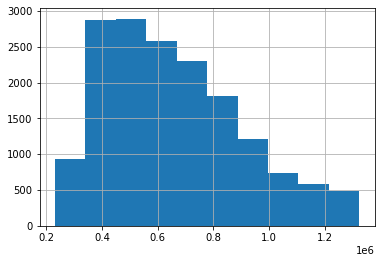

In [224]:
df.SalePrice.hist()

In [228]:
len(df)

16407

In [230]:
for col in df.columns:
    print(col)
    print(data_2019_homes[col].value_counts())

id
3122069048    4
1972202382    3
2326600220    2
7955080310    2
7557400050    2
             ..
0871000335    1
7140701350    1
2473250790    1
2787320520    1
1773101470    1
Name: id, Length: 18296, dtype: int64
DocumentDate
06/25/2019    163
06/26/2019    153
06/18/2019    138
06/24/2019    136
07/09/2019    129
             ... 
11/24/2019      1
03/31/2019      1
01/27/2019      1
02/09/2019      1
05/05/2019      1
Name: DocumentDate, Length: 357, dtype: int64
SalePrice
450000      159
650000      156
400000      146
550000      136
700000      128
           ... 
2175000       1
855080        1
14250000      1
811000        1
1941500       1
Name: SalePrice, Length: 3491, dtype: int64
Address
                               14
15425   2ND AVE NE  98155       4
18203  SE 272ND ST   98042      4
3502   TROLL AVE N              3
30412   153RD AVE SE  98042     2
                               ..
8029   117TH PL SE              1
2045   80TH AVE SE  98040       1
5005 C  RENTON A

(Nanno, Ville d'Anaunia, Comunità della Val di Non, Provincia di Trento, Trentino-Alto Adige/Südtirol, 38012, Italia, (46.3144754, 11.0480288))    662
(8th Avenue, Central Business District, First Hill, Seattle, King County, Washington, 98191, United States, (47.6135726, -122.333621))              91
(36th Avenue, Madrona, Seattle, King County, Washington, 98112, United States, (47.6179932, -122.2875913))                                          86
(12th Avenue, Capitol Hill, Seattle, King County, Washington, 98122, United States, (47.6176083, -122.3168881))                                     84
(2nd Avenue, West Edge, International District/Chinatown, Seattle, King County, Washington, 98104, United States, (47.6021499, -122.3323703))       84
                                                                                                                                                  ... 
(5415, 31st Avenue, Louisa County, Iowa, 52646, United States, (41.13733066420487, -90.9954744

In [231]:
df['SqFtTotLiving'].quantile([.01,.9])

0.01     720.0
0.90    3010.0
Name: SqFtTotLiving, dtype: float64

In [232]:
len(df[(df['SqFtTotLiving']>720)&(df['SqFtTotLiving']<3010)])

14548

In [233]:
df = df[(df['SqFtTotLiving']>720)&(df['SqFtTotLiving']<3010)]

In [234]:
df.isna().sum()

id                       0
DocumentDate             0
SalePrice                0
Address                  0
BuildingNumber           0
DirectionPrefix          7
StreetName               0
StreetType             441
DirectionSuffix          7
ZipCode               1609
Stories                  0
BldgGrade                0
SqFt1stFloor             0
SqFtHalfFloor            0
SqFt2ndFloor             0
SqFtUpperFloor           0
SqFtTotLiving            0
SqFtTotBasement          0
SqFtFinBasement          0
FinBasementGrade         0
SqFtGarageBasement       0
SqFtGarageAttached       0
DaylightBasement         0
SqFtOpenPorch            0
SqFtEnclosedPorch        0
SqFtDeck                 0
HeatSystem               0
HeatSource               0
BrickStone               0
Bedrooms                 0
BathHalfCount            0
Bath3qtrCount            0
BathFullCount            0
YrBuilt                  0
YrRenovated              0
Condition                0
Township                 0
S

In [235]:
df['renovation']= df['YrRenovated'].apply(lambda x: 1 if x > 0 else 0)

<ipython-input-235-ec83b1997142>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['renovation']= df['YrRenovated'].apply(lambda x: 1 if x > 0 else 0)


In [237]:
df.renovation.value_counts()

0    13950
1      598
Name: renovation, dtype: int64

In [238]:
len(df)

14548

In [240]:
df.to_csv('df.csv')

In [241]:
for_map = df.copy()

In [243]:
for_map.dropna(subset=['address'], inplace=True)

In [244]:
for_map.isna().sum()

id                       0
DocumentDate             0
SalePrice                0
Address                  0
BuildingNumber           0
DirectionPrefix          0
StreetName               0
StreetType               0
DirectionSuffix          0
ZipCode               1524
Stories                  0
BldgGrade                0
SqFt1stFloor             0
SqFtHalfFloor            0
SqFt2ndFloor             0
SqFtUpperFloor           0
SqFtTotLiving            0
SqFtTotBasement          0
SqFtFinBasement          0
FinBasementGrade         0
SqFtGarageBasement       0
SqFtGarageAttached       0
DaylightBasement         0
SqFtOpenPorch            0
SqFtEnclosedPorch        0
SqFtDeck                 0
HeatSystem               0
HeatSource               0
BrickStone               0
Bedrooms                 0
BathHalfCount            0
Bath3qtrCount            0
BathFullCount            0
YrBuilt                  0
YrRenovated              0
Condition                0
Township                 0
S

In [245]:
# 1 - conveneint function to delay between geocoding calls
geocode = RateLimiter(locator.geocode, min_delay_seconds=1)
# 2- - create location column
for_map['location'] = for_map['address'].apply(geocode)
# 3 - create longitude, laatitude and altitude from location column (returns tuple)
for_map['point'] = for_map['location'].apply(lambda loc: tuple(loc.point) if loc else None)
# 4 - split point column into latitude, longitude and altitude columns
for_map[['latitude', 'longitude', 'altitude']] = pd.DataFrame(for_map['point'].tolist(), index=for_map.index)



In [388]:
plugins.FastMarkerCluster(data=list(zip(for_map['latitude'].values, for_map['longitude'].values))).add_to(map1)
folium.LayerControl().add_to(map1)

In [248]:
for_map.dropna(subset=['latitude'], inplace=True)

In [387]:
map1

TypeError: Object of type Series is not JSON serializable

In [251]:
for_map.to_csv('final_map.csv')

In [252]:
len(for_map)

13955

In [253]:
for_map.head()

,id,DocumentDate,SalePrice,Address,BuildingNumber,DirectionPrefix,StreetName,StreetType,DirectionSuffix,ZipCode,Stories,BldgGrade,SqFt1stFloor,SqFtHalfFloor,SqFt2ndFloor,SqFtUpperFloor,SqFtTotLiving,SqFtTotBasement,SqFtFinBasement,FinBasementGrade,SqFtGarageBasement,SqFtGarageAttached,DaylightBasement,SqFtOpenPorch,SqFtEnclosedPorch,SqFtDeck,HeatSystem,HeatSource,BrickStone,Bedrooms,BathHalfCount,Bath3qtrCount,BathFullCount,YrBuilt,YrRenovated,Condition,Township,Section,QuarterSection,Area,DistrictName,SqFtLot,Access,StreetSurface,InadequateParking,TrafficNoise,PropertyType,Date,address,location,point,latitude,longitude,altitude,renovation
10,0100500380,12/12/2019,445000,2435 S 354TH ST 98003,2435,S,354TH,street,,98003,1,7,1480,0,0,0,1480,0,0,0,0,440,,80,0,120,5,2,0,3,0,0,2,1994,0,5,21,28,NE,55,KING COUNTY,6446,4,1,2,0,11,2019,"2435 S 354TH street , ...","(2435, South 354th Street, Emery Woods, Federa...","(47.28493, -122.30216590825634, 0.0)",47.284930,-122.302166,0.0,0
11,0100500380,08/16/2019,311000,2435 S 354TH ST 98003,2435,S,354TH,street,,98003,1,7,1480,0,0,0,1480,0,0,0,0,440,,80,0,120,5,2,0,3,0,0,2,1994,0,5,21,28,NE,55,KING COUNTY,6446,4,1,2,0,11,2019,"2435 S 354TH street , ...","(2435, South 354th Street, Emery Woods, Federa...","(47.28493, -122.30216590825634, 0.0)",47.284930,-122.302166,0.0,0
21,0188000095,08/30/2019,730000,1602 LAKEVIEW BLVD E 98102,1602,,LAKEVIEW,boulevard,E,98102,2,9,660,0,595,0,1540,380,285,8,0,0,Y,0,0,155,1,3,0,3,1,1,1,1984,0,3,25,20,SE,13,SEATTLE,3117,4,1,0,3,11,2019,1602 LAKEVIEW boulevard E...,"(1602, Lakeview Boulevard East, Capitol Hill, ...","(47.6341511, -122.322067, 0.0)",47.634151,-122.322067,0.0,0
28,0191100310,10/01/2019,1055700,4520 88TH AVE SE 98040,4520,,88TH,avenue,SE,98040,1,8,1390,0,0,0,2780,1390,1390,7,0,0,Y,0,0,100,5,2,0,6,0,1,1,1967,0,3,24,18,SW,34,MERCER ISLAND,9525,4,1,2,0,11,2019,"4520 88TH avenue SE, ...","(4520, 88th Avenue Southeast, Mercer Island, K...","(47.56507226770158, -122.22147249597593, 0.0)",47.565072,-122.221472,0.0,0
34,0179001770,12/13/2019,565000,12207 50TH AVE S 98168,12207,,50TH,avenue,S,98168,1,8,1350,0,0,0,2230,1280,880,7,400,80,Y,40,0,100,5,3,0,3,0,0,2,2015,0,3,23,10,SE,24,TUKWILA,7820,4,1,2,0,11,2019,"12207 50TH avenue S , ...","(12207, 50th Avenue South, Allentown, Tukwila,...","(47.4939413, -122.27219090205394, 0.0)",47.493941,-122.272191,0.0,0


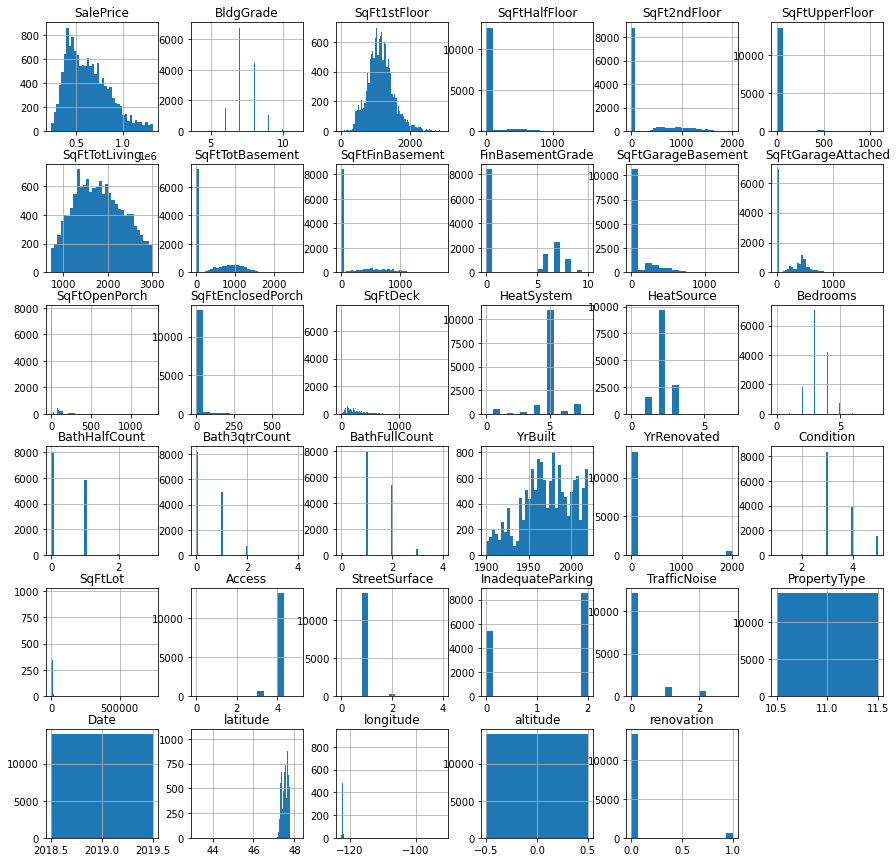

In [259]:
for_map.hist(figsize=(15,15), bins='auto');

lets have yet another drop of columns which will not help this study.

In [263]:
for_map.drop(columns=['altitude', 'Date', 'PropertyType'], inplace=True)

<ipython-input-264-ab8e86a3277a>:3: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  mask = np.triu(np.ones_like(corr, dtype=np.bool))


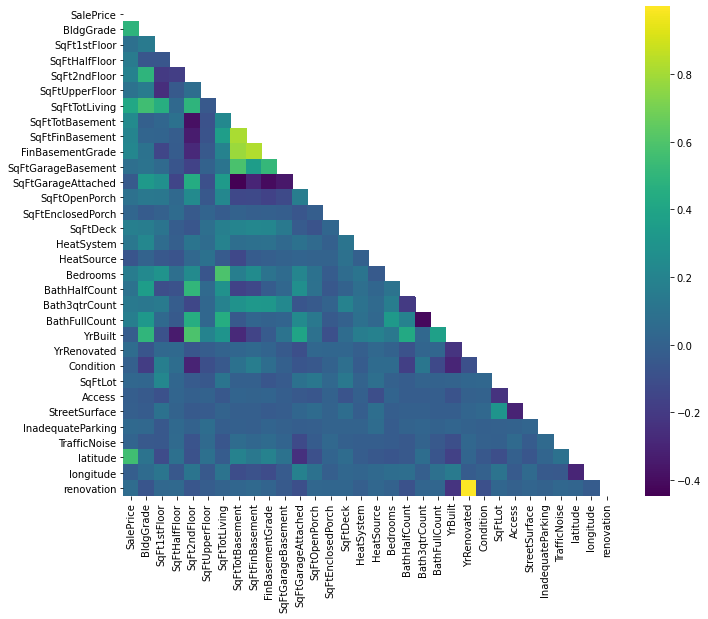

In [264]:
corr = for_map.corr()
# The mask is not necessary, but corr() has duplicate values on either side of the diagonal
mask = np.triu(np.ones_like(corr, dtype=np.bool))

fig1, ax1 = plt.subplots(figsize=(11, 9))
sns.heatmap(corr, mask=mask, ax=ax1, cmap="viridis");

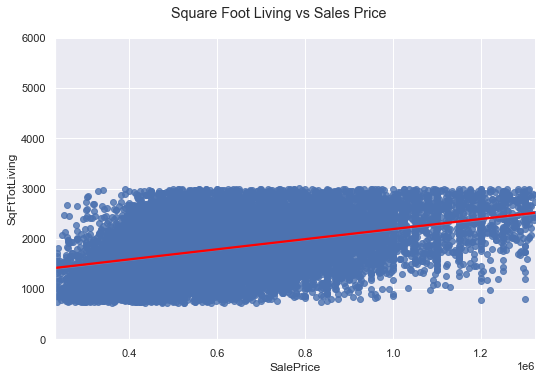

In [268]:

sns.set()
ax = sns.lmplot(x="SalePrice", y="SqFtTotLiving", data=df, height = 5, aspect=1.5, line_kws={'color': 'red'});
ax.fig.suptitle('Square Foot Living vs Sales Price',y=1.05);
ax.set(ylim=(0, 6000))

In [269]:
# save absolute value of correlation matrix as a data frame
# converts all values to absolute value
# stacks the row:column pairs into a multindex
# reset the index to set the multindex to seperate columns
# sort values. 0 is the column automatically generated by the stacking

df=for_map.corr().abs().stack().reset_index().sort_values(0, ascending=False)

# zip the variable name columns (Which were only named level_0 and level_1 by default) in a new column named "pairs"
df['pairs'] = list(zip(df.level_0, df.level_1))

# set index to pairs
df.set_index(['pairs'], inplace = True)

#d rop level columns
df.drop(columns=['level_1', 'level_0'], inplace = True)

# rename correlation column as cc rather than 0
df.columns = ['cc']

# drop duplicates. This could be dangerous if you have variables perfectly correlated with variables other than themselves.
# for the sake of exercise, kept it in.
df.drop_duplicates(inplace=True)

df[(df.cc>.75) & (df.cc <1)]

In [270]:
df[(df.cc>.75) & (df.cc <1)]

,cc
pairs,
"(renovation, YrRenovated)",0.999955
"(FinBasementGrade, SqFtFinBasement)",0.830263
"(SqFtTotBasement, SqFtFinBasement)",0.817728
"(SqFtTotBasement, FinBasementGrade)",0.781321


I will drop FinBasementGrade and SqFtFinBasement as they will be are highly correlated with each other and this will introduce multicollinearity to any model

In [ ]:
transform = lambda x: 0 if x == 0 else 1
df['gender_cat'] = df.gender.apply(transform)

In [271]:
for_map.drop(columns=['FinBasementGrade', 'SqFtFinBasement'], inplace=True)

## First model 

In [273]:
first_model = for_map[["SalePrice", "SqFtTotLiving"]].copy()

In [274]:
first_model = ols(formula="SalePrice ~ SqFtTotLiving", data=for_map)
first_m_results = first_model.fit()

In [276]:
first_m_results.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              SalePrice   R-squared:                       0.171
Model:                            OLS   Adj. R-squared:                  0.171
Method:                 Least Squares   F-statistic:                     2872.
Date:                Mon, 01 Mar 2021   Prob (F-statistic):               0.00
Time:                        13:50:57   Log-Likelihood:            -1.9074e+05
No. Observations:               13955   AIC:                         3.815e+05
Df Residuals:                   13953   BIC:                         3.815e+05
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
=================================================================================
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
Intercept      3.215e+05   6056.473     53.088      0.000     3.1e+05    3.33e+05
SqFtTotLiving   170.8405      3.188     53.592      0.000     164.592     177.089
==============================================================================
Omnibus:                      674.788   Durbin-Watson:                   1.680
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              762.835
Skew:                           0.564   Prob(JB):                    2.25e-166
Kurtosis:                       2.797   Cond. No.                     6.51e+03
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 6.51e+03. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

Ok, as expected with a simple model, only 17% of the variance in sales price is explained by the model. Now lets check the assumptions of a linear regression model and more importantly that it is being honored here.

In [277]:
rainbow_statistic, rainbow_p_value = linear_rainbow(first_m_results)
print("Rainbow statistic:", rainbow_statistic)
print("Rainbow p-value:", rainbow_p_value)

Rainbow statistic: 1.0493400530553143
Rainbow p-value: 0.022153297007750282


The null hypothesis is that the model is linearly predicted by the features, alternative hypothesis is that it is not. Thus returning a low p-value means that the current model violates the linearity assumption.

In [278]:
y = for_map["SalePrice"]
y_hat = first_m_results.predict()

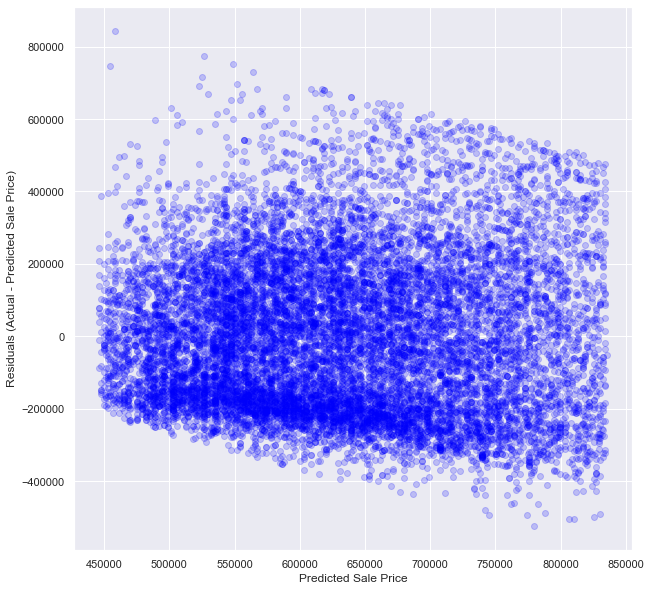

In [280]:
fig2, ax2 = plt.subplots(figsize=(10,10))
ax2.set(xlabel="Predicted Sale Price",
        ylabel="Residuals (Actual - Predicted Sale Price)")
ax2.scatter(x=y_hat, y=y-y_hat, color="blue", alpha=0.2);

It appears the model is not homoscedastic, it can be confirmed using the Bresch-Pagan test in which the null hypothesis is homoscedasticisity and thus returning a low p-value means the model violates this assumtpion

In [281]:
lm, lm_p_value, fvalue, f_p_value = het_breuschpagan(y-y_hat, for_map[["SqFtTotLiving"]])
print("Lagrange Multiplier p-value:", lm_p_value)
print("F-statistic p-value:", f_p_value)

Lagrange Multiplier p-value: nan
F-statistic p-value: 0.0


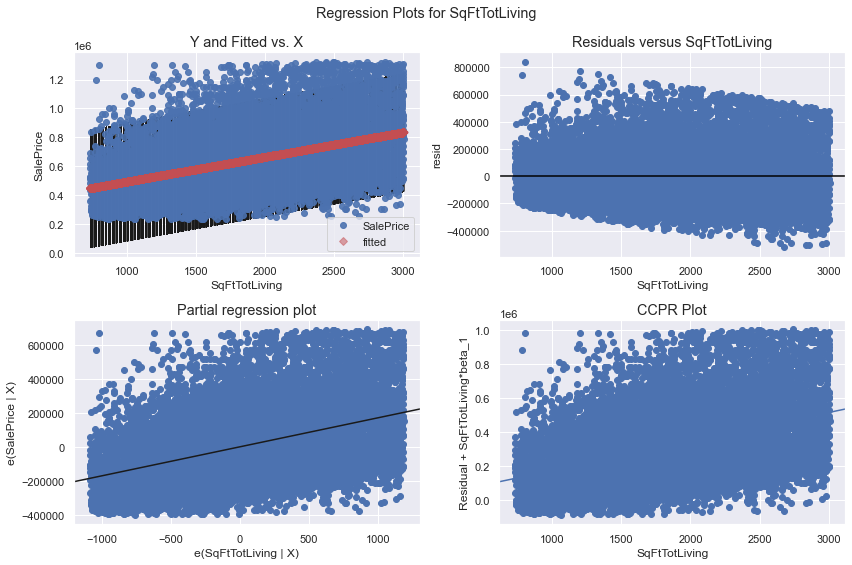

In [283]:
sm.graphics.plot_regress_exog(first_m_results, 'SqFtTotLiving', fig=plt.figure(figsize=(12, 8)));

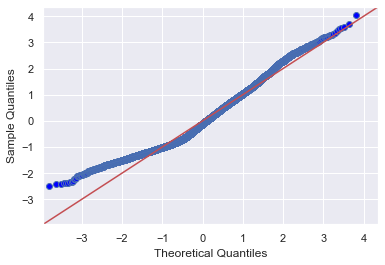

In [285]:
sm.graphics.qqplot(first_m_results.resid, line='45', fit=True);

# Second Model 

In [288]:
second_model_df = for_map[["SalePrice", "SqFtTotLiving", 'SqFt1stFloor']].copy()

In [289]:
second_model = ols(formula="SalePrice ~ SqFtTotLiving + SqFt1stFloor", data=second_model_df)
second_results = second_model.fit()
second_results.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              SalePrice   R-squared:                       0.185
Model:                            OLS   Adj. R-squared:                  0.185
Method:                 Least Squares   F-statistic:                     1584.
Date:                Mon, 01 Mar 2021   Prob (F-statistic):               0.00
Time:                        14:29:15   Log-Likelihood:            -1.9062e+05
No. Observations:               13955   AIC:                         3.812e+05
Df Residuals:                   13952   BIC:                         3.813e+05
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
=================================================================================
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
Intercept      3.706e+05   6769.594     54.744      0.000    3.57e+05    3.84e+05
SqFtTotLiving   196.3773      3.555     55.246      0.000     189.410     203.345
SqFt1stFloor    -81.9841      5.225    -15.692      0.000     -92.225     -71.743
==============================================================================
Omnibus:                      658.192   Durbin-Watson:                   1.700
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              752.223
Skew:                           0.566   Prob(JB):                    4.54e-164
Kurtosis:                       2.884   Cond. No.                     8.64e+03
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 8.64e+03. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

In [290]:
rainbow_statistic, rainbow_p_value = linear_rainbow(second_results)
print("Rainbow statistic:", rainbow_statistic)
print("Rainbow p-value:", rainbow_p_value)

Rainbow statistic: 1.0469182727066115
Rainbow p-value: 0.027769883203039185


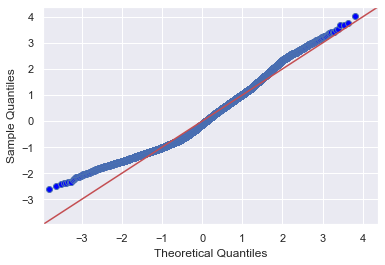

In [291]:
sm.graphics.qqplot(second_results.resid, line='45', fit=True);

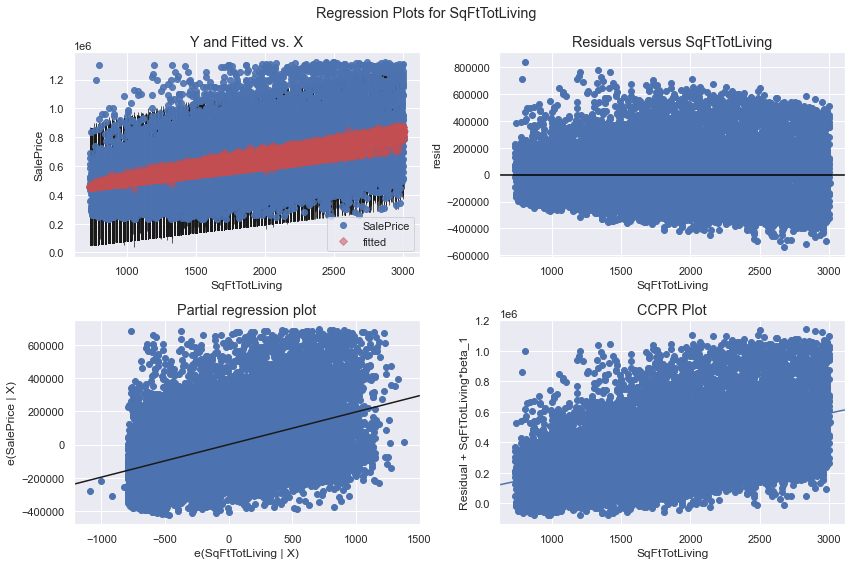

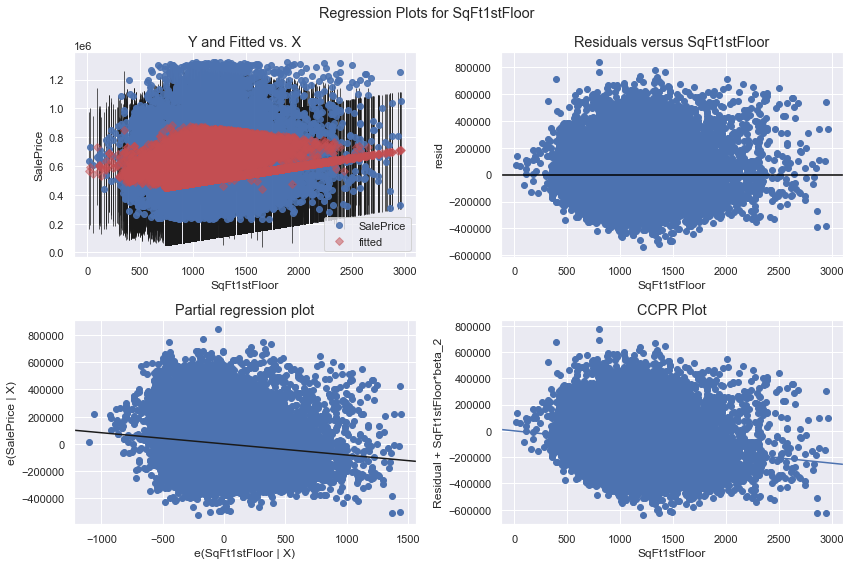

In [294]:
sm.graphics.plot_regress_exog(second_results, 'SqFtTotLiving', fig=plt.figure(figsize=(12, 8)));
sm.graphics.plot_regress_exog(second_results, 'SqFt1stFloor', fig=plt.figure(figsize=(12, 8)));

In [295]:
import math

In [ ]:
import math
from math import sin, cos, sqrt, atan2, radians

# approximate radius of earth in km
R = 6373.0

lat1 = radians(52.2296756)
lon1 = radians(21.0122287)
lat2 = radians(52.406374)
lon2 = radians(16.9251681)

dlon = lon2 - lon1
dlat = lat2 - lat1

a = sin(dlat / 2)**2 + cos(lat1) * cos(lat2) * sin(dlon / 2)**2
c = 2 * atan2(sqrt(a), sqrt(1 - a))

distance = R * c

print("Result:", distance)
print("Should be:", 278.546, "km")

1. most expensive house in mercer island is in 5330 Butterworth Rd, Mercer Island, Washington
2. most expensive house in medina is in medina 7887 Overlake Drive West - I will add a column that provides distance to both
3. NE Laurelcrest Lane has the most expensive house in Seattle. 

In [302]:
from math import sin, cos, sqrt, atan2, radians
from haversine import haversine

In [ ]:
R = 6373.0

In [305]:
# calculate the distance from the most expensive areas of king county
for_map['lat_long'] = tuple(zip(for_map.latitude, for_map.longitude))
    
laurelcrest = [47.6560723, -122.2725167]
medina = [47.6160689485921,-122.23362543624816] 
mercer = [47.55621241561222, -122.2129871659772]


def calc_distances(lat_long, area, df):
    """
    Calculate the haversine distances from the locations in lat_long and city
    Parameters:
    lat_long: pd.series of lat/long tuples
    city: the lat/long tuple of a city
    """
    dists = []
    for loc in lat_long:
        dists.append(haversine((area),(loc),unit='km'))
    return pd.Series(dists, index=df.index)

for_map['laurelcrest'] = calc_distances(for_map['lat_long'], laurelcrest)
for_map['medina'] = calc_distances(for_map['lat_long'], medina)
for_map['mercer'] = calc_distances(for_map['lat_long'], mercer)


for_map['dist_to_exp'] = for_map[['laurelcrest', 'medina', 'mercer']].min(axis=1, numeric_only=True)

for_map.drop(['laurelcrest', 'medina', 'mercer'], axis=1, inplace=True)

In [602]:
def calc_distances(lat_long, area, df):
    """
    Calculate the haversine distances from the locations in lat_long and city
    Parameters:
    lat_long: pd.series of lat/long tuples
    city: the lat/long tuple of a city
    """
    dists = []
    for loc in lat_long:
        dists.append(haversine((area),(loc),unit='km'))
    return pd.Series(dists, index=df.index)

In [306]:
for_map.head()

,id,DocumentDate,SalePrice,Address,BuildingNumber,DirectionPrefix,StreetName,StreetType,DirectionSuffix,ZipCode,Stories,BldgGrade,SqFt1stFloor,SqFtHalfFloor,SqFt2ndFloor,SqFtUpperFloor,SqFtTotLiving,SqFtTotBasement,SqFtGarageBasement,SqFtGarageAttached,DaylightBasement,SqFtOpenPorch,SqFtEnclosedPorch,SqFtDeck,HeatSystem,HeatSource,BrickStone,Bedrooms,BathHalfCount,Bath3qtrCount,BathFullCount,YrBuilt,YrRenovated,Condition,Township,Section,QuarterSection,Area,DistrictName,SqFtLot,Access,StreetSurface,InadequateParking,TrafficNoise,address,location,point,latitude,longitude,renovation,lat_long,dist_to_exp
10,0100500380,12/12/2019,445000,2435 S 354TH ST 98003,2435,S,354TH,street,,98003,1,7,1480,0,0,0,1480,0,0,440,,80,0,120,5,2,0,3,0,0,2,1994,0,5,21,28,NE,55,KING COUNTY,6446,4,1,2,0,"2435 S 354TH street , ...","(2435, South 354th Street, Emery Woods, Federa...","(47.28493, -122.30216590825634, 0.0)",47.284930,-122.302166,0,"(47.28493, -122.30216590825634)",30.902423
11,0100500380,08/16/2019,311000,2435 S 354TH ST 98003,2435,S,354TH,street,,98003,1,7,1480,0,0,0,1480,0,0,440,,80,0,120,5,2,0,3,0,0,2,1994,0,5,21,28,NE,55,KING COUNTY,6446,4,1,2,0,"2435 S 354TH street , ...","(2435, South 354th Street, Emery Woods, Federa...","(47.28493, -122.30216590825634, 0.0)",47.284930,-122.302166,0,"(47.28493, -122.30216590825634)",30.902423
21,0188000095,08/30/2019,730000,1602 LAKEVIEW BLVD E 98102,1602,,LAKEVIEW,boulevard,E,98102,2,9,660,0,595,0,1540,380,0,0,Y,0,0,155,1,3,0,3,1,1,1,1984,0,3,25,20,SE,13,SEATTLE,3117,4,1,0,3,1602 LAKEVIEW boulevard E...,"(1602, Lakeview Boulevard East, Capitol Hill, ...","(47.6341511, -122.322067, 0.0)",47.634151,-122.322067,0,"(47.6341511, -122.322067)",4.440804
28,0191100310,10/01/2019,1055700,4520 88TH AVE SE 98040,4520,,88TH,avenue,SE,98040,1,8,1390,0,0,0,2780,1390,0,0,Y,0,0,100,5,2,0,6,0,1,1,1967,0,3,24,18,SW,34,MERCER ISLAND,9525,4,1,2,0,"4520 88TH avenue SE, ...","(4520, 88th Avenue Southeast, Mercer Island, K...","(47.56507226770158, -122.22147249597593, 0.0)",47.565072,-122.221472,0,"(47.56507226770158, -122.22147249597593)",1.173010
34,0179001770,12/13/2019,565000,12207 50TH AVE S 98168,12207,,50TH,avenue,S,98168,1,8,1350,0,0,0,2230,1280,400,80,Y,40,0,100,5,3,0,3,0,0,2,2015,0,3,23,10,SE,24,TUKWILA,7820,4,1,2,0,"12207 50TH avenue S , ...","(12207, 50th Avenue South, Allentown, Tukwila,...","(47.4939413, -122.27219090205394, 0.0)",47.493941,-122.272191,0,"(47.4939413, -122.27219090205394)",8.228406


# Third Model - adding distance to expensive area

In [307]:
third_model_df = for_map[["SalePrice", "SqFtTotLiving", 'SqFt1stFloor', 'dist_to_exp']].copy()

In [308]:
outcome = 'SalePrice'
predictors = third_model_df.drop('SalePrice', axis=1)
pred_sum = '+'.join(predictors.columns)
formula = outcome + '~' + pred_sum
model = ols(formula=formula, data=third_model_df).fit()
model.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              SalePrice   R-squared:                       0.230
Model:                            OLS   Adj. R-squared:                  0.230
Method:                 Least Squares   F-statistic:                     1387.
Date:                Mon, 01 Mar 2021   Prob (F-statistic):               0.00
Time:                        15:15:54   Log-Likelihood:            -1.9022e+05
No. Observations:               13955   AIC:                         3.805e+05
Df Residuals:                   13951   BIC:                         3.805e+05
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
=================================================================================
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
Intercept      3.905e+05   6619.077     59.003      0.000    3.78e+05    4.04e+05
SqFtTotLiving   196.7781      3.456     56.938      0.000     190.004     203.552
SqFt1stFloor    -71.7914      5.092    -14.098      0.000     -81.773     -61.810
dist_to_exp   -2196.2326     77.238    -28.435      0.000   -2347.629   -2044.836
==============================================================================
Omnibus:                     8185.295   Durbin-Watson:                   1.728
Prob(Omnibus):                  0.000   Jarque-Bera (JB):           770986.754
Skew:                           1.937   Prob(JB):                         0.00
Kurtosis:                      39.207   Cond. No.                     8.69e+03
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 8.69e+03. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

In [309]:
for_map.ZipCode.value_counts()

98042         436
98023         436
98058         380
98034         346
98115         345
98117         342
98038         336
98133         306
98118         298
98001         297
98103         296
98052         277
98155         272
98003         249
98031         247
98059         242
98056         239
98125         238
98126         225
98106         224
98168         224
98092         212
98198         206
98146         205
98006         202
98178         201
98116         199
98002         192
98033         186
98022         181
98030         180
98074         180
98008         178
98177         176
98028         175
98122         168
98055         168
98144         162
98199         147
98136         147
98045         145
98107         144
98072         141
98166         137
98108         137
98105         132
98011         132
98029         129
98027         126
98053         123
98188         108
98112         105
98032         101
98065          98
98075          94
98119     

In [334]:
ohe_experiment = for_map.copy()
ohe_experiment.isna().sum()
ohe_experiment.dropna(subset=['ZipCode'], inplace=True)


In [316]:
def df_ohe(data, col, prefix=''):
    """
    Create One Hot Encoded (OHE) features for a column and 
    return the updated dataframe
    
    Parameters:
    data: dataframe
    col: column in dataframe for OHE process
    prefix: prefix to add the the new columns
    """
    dummies = pd.get_dummies(data[col],
                            prefix=prefix,
                            drop_first=True)
    data = data.drop(col, axis=1)
    data = pd.concat([data, dummies], axis=1)
    return data

In [335]:
model_4 = df_ohe(ohe_experiment, 'ZipCode', 'ohe')

In [324]:
my_list = model_4.columns.values.tolist()
my_list

['id',
 'DocumentDate',
 'SalePrice',
 'Address',
 'BuildingNumber',
 'DirectionPrefix',
 'StreetName',
 'StreetType',
 'DirectionSuffix',
 'Stories',
 'BldgGrade',
 'SqFt1stFloor',
 'SqFtHalfFloor',
 'SqFt2ndFloor',
 'SqFtUpperFloor',
 'SqFtTotLiving',
 'SqFtTotBasement',
 'SqFtGarageBasement',
 'SqFtGarageAttached',
 'DaylightBasement',
 'SqFtOpenPorch',
 'SqFtEnclosedPorch',
 'SqFtDeck',
 'HeatSystem',
 'HeatSource',
 'BrickStone',
 'Bedrooms',
 'BathHalfCount',
 'Bath3qtrCount',
 'BathFullCount',
 'YrBuilt',
 'YrRenovated',
 'Condition',
 'Township',
 'Section',
 'QuarterSection',
 'Area',
 'DistrictName',
 'SqFtLot',
 'Access',
 'StreetSurface',
 'InadequateParking',
 'TrafficNoise',
 'address',
 'location',
 'point',
 'latitude',
 'longitude',
 'renovation',
 'lat_long',
 'dist_to_exp',
 'ohe_98001',
 'ohe_98002',
 'ohe_98003',
 'ohe_98004',
 'ohe_98005',
 'ohe_98006',
 'ohe_98007',
 'ohe_98008',
 'ohe_98010',
 'ohe_98011',
 'ohe_98014',
 'ohe_98019',
 'ohe_98022',
 'ohe_98023',


In [337]:
outcome = 'SalePrice'
predictors = model_4[['SqFtTotLiving', 'SqFt1stFloor','dist_to_exp', 'ohe_98001', 'ohe_98002', 'ohe_98003', 'ohe_98004',\
                      'ohe_98005', 'ohe_98006', 'ohe_98007', 'ohe_98008', 'ohe_98010', 'ohe_98011', 'ohe_98014', 'ohe_98019',\
                       'ohe_98022', 'ohe_98023', 'ohe_98023-7841', 'ohe_98024', 'ohe_98027', 'ohe_98028', 'ohe_98028-6100',\
                      'ohe_98029', 'ohe_98030', 'ohe_98031', 'ohe_98032', 'ohe_98033', 'ohe_98034', 'ohe_98034-2540',\
                      'ohe_98038', 'ohe_98039', 'ohe_98040', 'ohe_98042', 'ohe_98042-3001', 'ohe_98045', 'ohe_98047',\
                      'ohe_98050', 'ohe_98051', 'ohe_98052', 'ohe_98053', 'ohe_98055', 'ohe_98056', 'ohe_98057',\
                      'ohe_98058', 'ohe_98058 ', 'ohe_98058-5344', 'ohe_98059', 'ohe_98065', 'ohe_98070', 'ohe_98072',\
                      'ohe_98074','ohe_98074-3908', 'ohe_98074-6745', 'ohe_98075', 'ohe_98075-8010', 'ohe_98077', 'ohe_98092',\
                      'ohe_98102', 'ohe_98103', 'ohe_98103-8173', 'ohe_98105', 'ohe_98106', 'ohe_98107', 'ohe_98108',\
                      'ohe_98109', 'ohe_98112', 'ohe_98113','ohe_98115', 'ohe_98116', 'ohe_98117', 'ohe_98118',\
                      'ohe_98119', 'ohe_98122', 'ohe_98125', 'ohe_98126', 'ohe_98133', 'ohe_98134', 'ohe_98136', 'ohe_98144',\
                      'ohe_98146', 'ohe_98148', 'ohe_98155', 'ohe_98166','ohe_98168', 'ohe_98177', 'ohe_98178', \
                      'ohe_98188', 'ohe_98198', 'ohe_98199', 'ohe_98224', 'ohe_98354', 'ohe_988122']]


In [326]:
model_4.isna().sum()

id                    0
DocumentDate          0
SalePrice             0
Address               0
BuildingNumber        0
DirectionPrefix       0
StreetName            0
StreetType            0
DirectionSuffix       0
Stories               0
BldgGrade             0
SqFt1stFloor          0
SqFtHalfFloor         0
SqFt2ndFloor          0
SqFtUpperFloor        0
SqFtTotLiving         0
SqFtTotBasement       0
SqFtGarageBasement    0
SqFtGarageAttached    0
DaylightBasement      0
SqFtOpenPorch         0
SqFtEnclosedPorch     0
SqFtDeck              0
HeatSystem            0
HeatSource            0
BrickStone            0
Bedrooms              0
BathHalfCount         0
Bath3qtrCount         0
BathFullCount         0
YrBuilt               0
YrRenovated           0
Condition             0
Township              0
Section               0
QuarterSection        0
Area                  0
DistrictName          0
SqFtLot               0
Access                0
StreetSurface         0
InadequateParkin

In [338]:
import statsmodels.api as sm
predictors_int = sm.add_constant(predictors)
model4 = sm.OLS(ohe_experiment['SalePrice'],predictors_int).fit()
model4.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              SalePrice   R-squared:                       0.757
Model:                            OLS   Adj. R-squared:                  0.755
Method:                 Least Squares   F-statistic:                     418.5
Date:                Mon, 01 Mar 2021   Prob (F-statistic):               0.00
Time:                        16:08:59   Log-Likelihood:            -1.6282e+05
No. Observations:               12468   AIC:                         3.258e+05
Df Residuals:                   12375   BIC:                         3.265e+05
Df Model:                          92                                         
Covariance Type:            nonrobust                                         
==================================================================================
                     coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------
const           4.371e+05   1.14e+05      3.831      0.000    2.13e+05    6.61e+05
SqFtTotLiving    170.7970      2.197     77.746      0.000     166.491     175.103
SqFt1stFloor      29.1020      3.521      8.266      0.000      22.201      36.003
dist_to_exp       17.2906     47.737      0.362      0.717     -76.282     110.863
ohe_98001      -3.803e+05   1.14e+05     -3.329      0.001   -6.04e+05   -1.56e+05
ohe_98002      -3.868e+05   1.14e+05     -3.383      0.001   -6.11e+05   -1.63e+05
ohe_98003      -3.775e+05   1.14e+05     -3.304      0.001   -6.01e+05   -1.54e+05
ohe_98004         3.4e+05   1.15e+05      2.946      0.003    1.14e+05    5.66e+05
ohe_98005       1.292e+05   1.15e+05      1.121      0.262   -9.67e+04    3.55e+05
ohe_98006       3.964e+04   1.14e+05      0.347      0.729   -1.84e+05    2.64e+05
ohe_98007       1.283e+04   1.15e+05      0.112      0.911   -2.12e+05    2.38e+05
ohe_98008       2.834e+04   1.14e+05      0.248      0.804   -1.96e+05    2.52e+05
ohe_98010      -2.896e+05   1.16e+05     -2.502      0.012   -5.17e+05   -6.28e+04
ohe_98011      -1.569e+05   1.14e+05     -1.371      0.171   -3.81e+05    6.75e+04
ohe_98014      -1.832e+05   1.15e+05     -1.594      0.111   -4.09e+05    4.22e+04
ohe_98019      -2.074e+05   1.15e+05     -1.809      0.071   -4.32e+05    1.74e+04
ohe_98022      -3.486e+05   1.14e+05     -3.048      0.002   -5.73e+05   -1.24e+05
ohe_98023      -3.971e+05   1.14e+05     -3.479      0.001   -6.21e+05   -1.73e+05
ohe_98023-7841 -4.084e+05   1.61e+05     -2.532      0.011   -7.25e+05   -9.22e+04
ohe_98024      -1.049e+05   1.16e+05     -0.906      0.365   -3.32e+05    1.22e+05
ohe_98027      -9.162e+04   1.14e+05     -0.800      0.424   -3.16e+05    1.33e+05
ohe_98028      -1.647e+05   1.14e+05     -1.440      0.150   -3.89e+05    5.95e+04
ohe_98028-6100 -1.241e+05   1.61e+05     -0.770      0.441    -4.4e+05    1.92e+05
ohe_98029        -1.7e+04   1.14e+05     -0.149      0.882   -2.41e+05    2.07e+05
ohe_98030      -3.644e+05   1.14e+05     -3.187      0.001   -5.88e+05    -1.4e+05
ohe_98031      -3.539e+05   1.14e+05     -3.098      0.002   -5.78e+05    -1.3e+05
ohe_98032      -3.822e+05   1.15e+05     -3.336      0.001   -6.07e+05   -1.58e+05
ohe_98033       1.032e+05   1.14e+05      0.902      0.367   -1.21e+05    3.27e+05
ohe_98034      -9.166e+04   1.14e+05     -0.803      0.422   -3.15e+05    1.32e+05
ohe_98034-2540  -8.21e+04   1.61e+05     -0.509      0.611   -3.98e+05    2.34e+05
ohe_98038      -3.195e+05   1.14e+05     -2.798      0.005   -5.43e+05   -9.56e+04
ohe_98039       3.391e+05    1.4e+05      2.428      0.015    6.54e+04    6.13e+05
ohe_98040        2.68e+05   1.15e+05      2.331      0.020    4.26e+04    4.93e+05
ohe_98042      -3.544e+05   1.14e+05     -3.105      0.002   -5.78e+05   -1.31e+05
ohe_98042-30

In [339]:
y = ohe_experiment["SalePrice"]
y_hat = model4.predict()

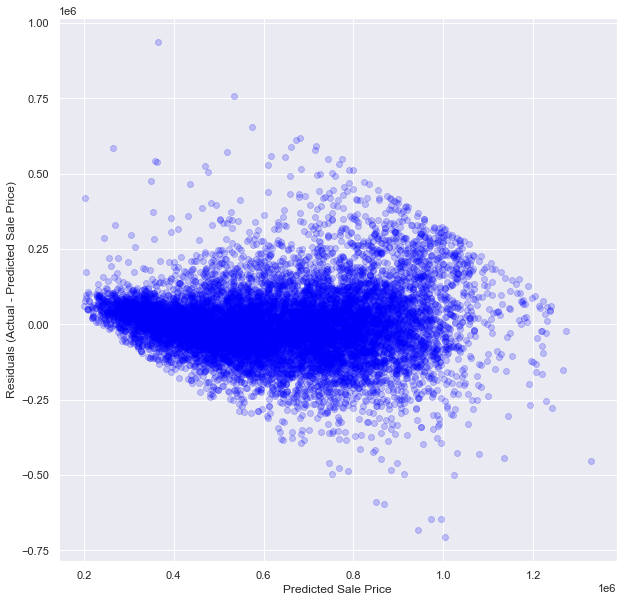

In [340]:
fig2, ax2 = plt.subplots(figsize=(10,10))
ax2.set(xlabel="Predicted Sale Price",
        ylabel="Residuals (Actual - Predicted Sale Price)")
ax2.scatter(x=y_hat, y=y-y_hat, color="blue", alpha=0.2);

In [342]:
model_4.head()

,id,DocumentDate,SalePrice,Address,BuildingNumber,DirectionPrefix,StreetName,StreetType,DirectionSuffix,Stories,BldgGrade,SqFt1stFloor,SqFtHalfFloor,SqFt2ndFloor,SqFtUpperFloor,SqFtTotLiving,SqFtTotBasement,SqFtGarageBasement,SqFtGarageAttached,DaylightBasement,SqFtOpenPorch,SqFtEnclosedPorch,SqFtDeck,HeatSystem,HeatSource,BrickStone,Bedrooms,BathHalfCount,Bath3qtrCount,BathFullCount,YrBuilt,YrRenovated,Condition,Township,Section,QuarterSection,Area,DistrictName,SqFtLot,Access,StreetSurface,InadequateParking,TrafficNoise,address,location,point,latitude,longitude,renovation,lat_long,dist_to_exp,ohe_98001,ohe_98002,ohe_98003,ohe_98004,ohe_98005,ohe_98006,ohe_98007,ohe_98008,ohe_98010,ohe_98011,ohe_98014,ohe_98019,ohe_98022,ohe_98023,ohe_98023-7841,ohe_98024,ohe_98027,ohe_98028,ohe_98028-6100,ohe_98029,ohe_98030,ohe_98031,ohe_98032,ohe_98033,ohe_98034,ohe_98034-2540,ohe_98038,ohe_98039,ohe_98040,ohe_98042,ohe_98042-3001,ohe_98045,ohe_98047,ohe_98050,ohe_98051,ohe_98052,ohe_98053,ohe_98055,ohe_98056,ohe_98057,ohe_98058,ohe_98058,ohe_98058-5344,ohe_98059,ohe_98065,ohe_98070,ohe_98072,ohe_98074,ohe_98074-3908,ohe_98074-6745,ohe_98075,ohe_98075-8010,ohe_98077,ohe_98092,ohe_98102,ohe_98103,ohe_98103-8173,ohe_98105,ohe_98106,ohe_98107,ohe_98108,ohe_98109,ohe_98112,ohe_98113,ohe_98115,ohe_98116,ohe_98117,ohe_98118,ohe_98119,ohe_98122,ohe_98125,ohe_98126,ohe_98133,ohe_98134,ohe_98136,ohe_98144,ohe_98146,ohe_98148,ohe_98155,ohe_98166,ohe_98168,ohe_98177,ohe_98178,ohe_98188,ohe_98198,ohe_98199,ohe_98224,ohe_98354,ohe_988122
10,0100500380,12/12/2019,445000,2435 S 354TH ST 98003,2435,S,354TH,street,,1,7,1480,0,0,0,1480,0,0,440,,80,0,120,5,2,0,3,0,0,2,1994,0,5,21,28,NE,55,KING COUNTY,6446,4,1,2,0,"2435 S 354TH street , ...","(2435, South 354th Street, Emery Woods, Federa...","(47.28493, -122.30216590825634, 0.0)",47.284930,-122.302166,0,"(47.28493, -122.30216590825634)",30.902423,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
11,0100500380,08/16/2019,311000,2435 S 354TH ST 98003,2435,S,354TH,street,,1,7,1480,0,0,0,1480,0,0,440,,80,0,120,5,2,0,3,0,0,2,1994,0,5,21,28,NE,55,KING COUNTY,6446,4,1,2,0,"2435 S 354TH street , ...","(2435, South 354th Street, Emery Woods, Federa...","(47.28493, -122.30216590825634, 0.0)",47.284930,-122.302166,0,"(47.28493, -122.30216590825634)",30.902423,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
21,0188000095,08/30/2019,730000,1602 LAKEVIEW BLVD E 98102,1602,,LAKEVIEW,boulevard,E,2,9,660,0,595,0,1540,380,0,0,Y,0,0,155,1,3,0,3,1,1,1,1984,0,3,25,20,SE,13,SEATTLE,3117,4,1,0,3,1602 LAKEVIEW boulevard E...,"(1602, Lakeview Boulevard East, Capitol Hill, ...","(47.6341511, -122.322067, 0.0)",47.634151,-122.322067,0,"(47.6341511, -122.322067)",4.440804,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
28,0191100310,10/01/2019,1055700,4520 88TH AVE SE 98040,4520,,88TH,avenue,SE,1,8,1390,0,0,0,2780,1390,0,0,Y,0,0,100,5,2,0,6,0,1,1,1967,0,3,24,18,SW,34,MERCER ISLAND,9525,4,1,2,0,"4520 88TH avenue SE, ...","(4520, 88th Avenue Southeast, Mercer Island, K...","(47.56507226770158, -122.22147249597593, 0.0)",47.565072,-122.221472,0,"(47.56507226770158, -122.22147249597593)",1.173010,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
34,0179001770,12/13/2019,565000,12207 50TH AVE S 98168,12207,,50TH,avenue,S,1,8,1350,0,0,0,2230,1280,400,80,Y,40,0,100,5,3,0,3,0,0,2,2015,0,3,23,10,SE,24,TUKWILA,7820,4,1,2,0,"12207 50TH avenue S , ...","(12207, 50th Avenue South, Allentown, Tukwila,...","(47.4939413, -122.27219090205394, 0.0)

In [344]:
ohe_experiment.ZipCode 

dtype('O')

In [370]:
# model_5_df = for_map.copy()
# model_5_df.dropna(subset=['ZipCode'], inplace=True)

continuous = [ 'SalePrice','SqFt1stFloor', 'SqFtTotLiving', 'dist_to_exp']
categoricals = ['ZipCode', 'BldgGrade', 'HeatSystem', 'Condition']

# # for_map[categoricals]
kc_cont = model_5_df[continuous]
# kc_cat = for_map[categoricals]

# # log features
log_names = [f'{column}_log' for column in kc_cont.columns]

kc_log = np.log(kc_cont)
kc_log.columns = log_names

def normalize(feature):
    return (feature - feature.mean()) / feature.std()

kc_log_norm = kc_log.apply(normalize)



In [406]:
cat_df = for_map[categoricals]
cat_df.dropna(subset=['ZipCode'], inplace=True)
cat_df.head()
encoder = OneHotEncoder(drop='first', sparse=False)
encoder.fit(cat_df)
cat_df = encoder.transform(cat_df)
cat_df = pd.DataFrame(cat_df, columns = encoder.get_feature_names())

<ipython-input-406-4bc39d069e4f>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cat_df.dropna(subset=['ZipCode'], inplace=True)


,ZipCode,BldgGrade,HeatSystem,Condition
10,98003,7,5,5
11,98003,7,5,5
21,98102,9,1,3
28,98040,8,5,3
34,98168,8,5,3


In [407]:
encoder = OneHotEncoder(drop='first', sparse=False)
encoder.fit(cat_df)
cat_df = encoder.transform(cat_df)
cat_df = pd.DataFrame(cat_df, columns = encoder.get_feature_names())

In [408]:
cat_df.head()

,x0_98001,x0_98002,x0_98003,x0_98004,x0_98005,x0_98006,x0_98007,x0_98008,x0_98010,x0_98011,x0_98014,x0_98019,x0_98022,x0_98023,x0_98023-7841,x0_98024,x0_98027,x0_98028,x0_98028-6100,x0_98029,x0_98030,x0_98031,x0_98032,x0_98033,x0_98034,x0_98034-2540,x0_98038,x0_98039,x0_98040,x0_98042,x0_98042-3001,x0_98045,x0_98047,x0_98050,x0_98051,x0_98052,x0_98053,x0_98055,x0_98056,x0_98057,x0_98058,x0_98058,x0_98058-5344,x0_98059,x0_98065,x0_98070,x0_98072,x0_98074,x0_98074-3908,x0_98074-6745,x0_98075,x0_98075-8010,x0_98077,x0_98092,x0_98102,x0_98103,x0_98103-8173,x0_98105,x0_98106,x0_98107,x0_98108,x0_98109,x0_98112,x0_98113,x0_98115,x0_98116,x0_98117,x0_98118,x0_98119,x0_98122,x0_98125,x0_98126,x0_98133,x0_98134,x0_98136,x0_98144,x0_98146,x0_98148,x0_98155,x0_98166,x0_98168,x0_98177,x0_98178,x0_98188,x0_98198,x0_98199,x0_98224,x0_98354,x0_988122,x1_5,x1_6,x1_7,x1_8,x1_9,x1_10,x1_11,x2_1,x2_2,x2_3,x2_4,x2_5,x2_6,x2_7,x2_8,x3_2,x3_3,x3_4,x3_5
0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
1,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0


In [423]:
encoder.categories_[0]

array(['91844', '98001', '98002', '98003', '98004', '98005', '98006',
       '98007', '98008', '98010', '98011', '98014', '98019', '98022',
       '98023', '98023-7841', '98024', '98027', '98028', '98028-6100',
       '98029', '98030', '98031', '98032', '98033', '98034', '98034-2540',
       '98038', '98039', '98040', '98042', '98042-3001', '98045', '98047',
       '98050', '98051', '98052', '98053', '98055', '98056', '98057',
       '98058', '98058 ', '98058-5344', '98059', '98065', '98070',
       '98072', '98074', '98074-3908', '98074-6745', '98075',
       '98075-8010', '98077', '98092', '98102', '98103', '98103-8173',
       '98105', '98106', '98107', '98108', '98109', '98112', '98113',
       '98115', '98116', '98117', '98118', '98119', '98122', '98125',
       '98126', '98133', '98134', '98136', '98144', '98146', '98148',
       '98155', '98166', '98168', '98177', '98178', '98188', '98198',
       '98199', '98224', '98354', '988122'], dtype=object)

([array(['98003', '98003', '98102', ..., '98023', '98032', '98074'],
        dtype=object),
  array([7, 7, 9, ..., 8, 7, 8]),
  array([5, 5, 1, ..., 5, 5, 5]),
  array([5, 5, 3, ..., 4, 3, 4])],
 12468,
 4)

In [416]:
check = for_map[categoricals]

In [431]:
[check.ZipCode.unique()]

ValueError: operands could not be broadcast together with shapes (91,) (90,) 

In [371]:
kc_ohe = pd.get_dummies(model_5_df[categoricals], prefix=categoricals, drop_first=True)

preprocessed = pd.concat([kc_log_norm, kc_ohe], axis=1)

X = preprocessed.drop('SalePrice_log', axis=1)
y = preprocessed['SalePrice_log']

In [372]:
preprocessed.head()

,SalePrice_log,SqFt1stFloor_log,SqFtTotLiving_log,dist_to_exp_log,ZipCode_98001,ZipCode_98002,ZipCode_98003,ZipCode_98004,ZipCode_98005,ZipCode_98006,ZipCode_98007,ZipCode_98008,ZipCode_98010,ZipCode_98011,ZipCode_98014,ZipCode_98019,ZipCode_98022,ZipCode_98023,ZipCode_98023-7841,ZipCode_98024,ZipCode_98027,ZipCode_98028,ZipCode_98028-6100,ZipCode_98029,ZipCode_98030,ZipCode_98031,ZipCode_98032,ZipCode_98033,ZipCode_98034,ZipCode_98034-2540,ZipCode_98038,ZipCode_98039,ZipCode_98040,ZipCode_98042,ZipCode_98042-3001,ZipCode_98045,ZipCode_98047,ZipCode_98050,ZipCode_98051,ZipCode_98052,ZipCode_98053,ZipCode_98055,ZipCode_98056,ZipCode_98057,ZipCode_98058,ZipCode_98058,ZipCode_98058-5344,ZipCode_98059,ZipCode_98065,ZipCode_98070,ZipCode_98072,ZipCode_98074,ZipCode_98074-3908,ZipCode_98074-6745,ZipCode_98075,ZipCode_98075-8010,ZipCode_98077,ZipCode_98092,ZipCode_98102,ZipCode_98103,ZipCode_98103-8173,ZipCode_98105,ZipCode_98106,ZipCode_98107,ZipCode_98108,ZipCode_98109,ZipCode_98112,ZipCode_98113,ZipCode_98115,ZipCode_98116,ZipCode_98117,ZipCode_98118,ZipCode_98119,ZipCode_98122,ZipCode_98125,ZipCode_98126,ZipCode_98133,ZipCode_98134,ZipCode_98136,ZipCode_98144,ZipCode_98146,ZipCode_98148,ZipCode_98155,ZipCode_98166,ZipCode_98168,ZipCode_98177,ZipCode_98178,ZipCode_98188,ZipCode_98198,ZipCode_98199,ZipCode_98224,ZipCode_98354,ZipCode_988122,BldgGrade_11,BldgGrade_4,BldgGrade_5,BldgGrade_6,BldgGrade_7,BldgGrade_8,BldgGrade_9,HeatSystem_1,HeatSystem_2,HeatSystem_3,HeatSystem_4,HeatSystem_5,HeatSystem_6,HeatSystem_7,HeatSystem_8,Condition_2,Condition_3,Condition_4,Condition_5
10,-0.750477,0.825528,-0.440672,1.452217,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1
11,-1.728147,0.825528,-0.440672,1.452217,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1
21,0.600187,-1.739872,-0.317908,-1.504096,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,1,0,0
28,1.606873,0.626224,1.506763,-3.532771,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,1,0,0
34,-0.098977,0.533466,0.825759,-0.564237,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,1,0,0


In [374]:
predictors_int = sm.add_constant(X)
model5 = sm.OLS(y,predictors_int).fit()
model5.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:          SalePrice_log   R-squared:                       0.815
Model:                            OLS   Adj. R-squared:                  0.813
Method:                 Least Squares   F-statistic:                     490.2
Date:                Mon, 01 Mar 2021   Prob (F-statistic):               0.00
Time:                        17:13:00   Log-Likelihood:                -7173.3
No. Observations:               12468   AIC:                         1.457e+04
Df Residuals:                   12356   BIC:                         1.540e+04
Df Model:                         111                                         
Covariance Type:            nonrobust                                         
======================================================================================
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  0.8263      0.498      1.661      0.097      -0.149       1.802
SqFt1stFloor_log       0.0603      0.005     11.969      0.000       0.050       0.070
SqFtTotLiving_log      0.3046      0.006     54.887      0.000       0.294       0.315
dist_to_exp_log       -0.2433      0.015    -16.718      0.000      -0.272      -0.215
ZipCode_98001         -1.1740      0.434     -2.702      0.007      -2.026      -0.322
ZipCode_98002         -1.2953      0.435     -2.978      0.003      -2.148      -0.443
ZipCode_98003         -1.2055      0.435     -2.774      0.006      -2.057      -0.354
ZipCode_98004          0.8053      0.438      1.840      0.066      -0.052       1.663
ZipCode_98005          0.2106      0.437      0.482      0.630      -0.645       1.067
ZipCode_98006         -0.1145      0.433     -0.264      0.792      -0.964       0.735
ZipCode_98007          0.0846      0.435      0.194      0.846      -0.768       0.938
ZipCode_98008          0.2199      0.434      0.507      0.612      -0.630       1.070
ZipCode_98010         -0.7266      0.440     -1.650      0.099      -1.590       0.137
ZipCode_98011         -0.3105      0.434     -0.715      0.475      -1.162       0.541
ZipCode_98014         -0.0951      0.437     -0.218      0.828      -0.952       0.762
ZipCode_98019         -0.1956      0.436     -0.449      0.654      -1.050       0.659
ZipCode_98022         -0.8566      0.436     -1.965      0.049      -1.711      -0.002
ZipCode_98023         -1.2431      0.434     -2.862      0.004      -2.095      -0.392
ZipCode_98023-7841    -1.3790      0.612     -2.252      0.024      -2.580      -0.179
ZipCode_98024          0.1485      0.440      0.338      0.736      -0.714       1.011
ZipCode_98027         -0.0398      0.434     -0.092      0.927      -0.891       0.812
ZipCode_98028         -0.3485      0.434     -0.803      0.422      -1.199       0.502
ZipCode_98028-6100    -0.2355      0.612     -0.385      0.700      -1.434       0.963
ZipCode_98029          0.1858      0.434      0.428      0.669      -0.666       1.037
ZipCode_98030         -1.1163      0.434     -2.569      0.010      -1.968      -0.265
ZipCode_98031         -1.1704      0.434     -2.698      0.007      -2.021      -0.320
ZipCode_98032         -1.2925      0.435     -2.969      0.003      -2.146      -0.439
ZipCode_98033          0.4311      0.433      0.995      0.320      -0.419       1.281
ZipCode_98034         -0.1091      0.433     -0.252      0.801      -0.958       0.740
ZipCode_98034-2540    -0.1729      0.611     -0.283      0.777      -1.371       1.025
ZipCode_98038         -0.8023      0.434     -1.848      0.065      -1.653       0.049
ZipCode_98039          1.0716      0.530      2.023      0.043       0.033       2.110
ZipCode_98040          0.2375      0.4

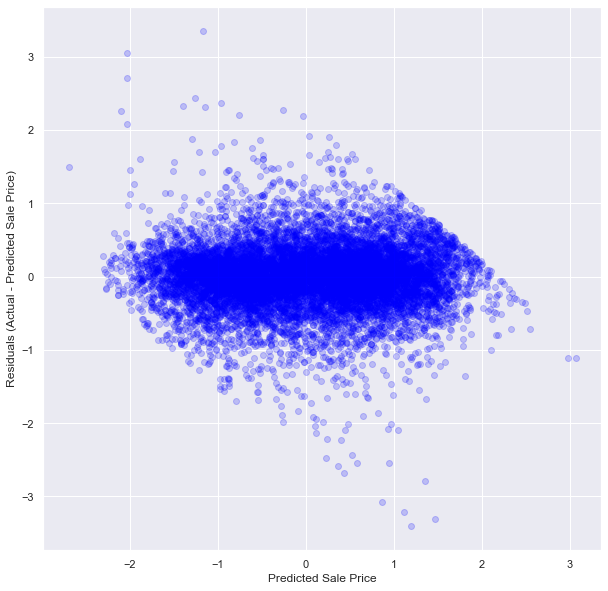

In [375]:
y_hat = model5.predict() 
fig2, ax2 = plt.subplots(figsize=(10,10))
ax2.set(xlabel="Predicted Sale Price",
        ylabel="Residuals (Actual - Predicted Sale Price)")
ax2.scatter(x=y_hat, y=y-y_hat, color="blue", alpha=0.2);

In [378]:
model_5_df.shape

(12468, 52)

In [379]:
len(for_map.ZipCode.value_counts())

90

In [380]:
X.shape

(12468, 111)

In [397]:
#Create base map zoomed in to Indiana
map3=folium.Map(location=[47.5837012,-122.3984634],  tiles=None, zoom_start=7)
folium.TileLayer('cartodbpositron', name='COVID-19 Services').add_to(map3)

#Make Marker Cluster Group layer
mcg = folium.plugins.MarkerCluster(control=False)
map3.add_child(mcg)

#Create layer of markers
#Set marker popups to display name and address of service
for row in for_map.iterrows():
    row_values=row[1]
    location=[row_values['latitude'], row_values['longitude']]
    popup=popup=('$' + str(row_values['SalePrice'])+'<br>'+'<br>'+ row_values['Address']+
                 '<br>'+'<br>'+row_values['DistrictName'])
    marker=folium.Marker(location=location, popup=popup, min_width=2000)
    marker.add_to(mcg)

#Add layer control
folium.LayerControl().add_to(map3)

map3

In [432]:
for_map.head()

,id,DocumentDate,SalePrice,Address,BuildingNumber,DirectionPrefix,StreetName,StreetType,DirectionSuffix,ZipCode,Stories,BldgGrade,SqFt1stFloor,SqFtHalfFloor,SqFt2ndFloor,SqFtUpperFloor,SqFtTotLiving,SqFtTotBasement,SqFtGarageBasement,SqFtGarageAttached,DaylightBasement,SqFtOpenPorch,SqFtEnclosedPorch,SqFtDeck,HeatSystem,HeatSource,BrickStone,Bedrooms,BathHalfCount,Bath3qtrCount,BathFullCount,YrBuilt,YrRenovated,Condition,Township,Section,QuarterSection,Area,DistrictName,SqFtLot,Access,StreetSurface,InadequateParking,TrafficNoise,address,location,point,latitude,longitude,renovation,lat_long,dist_to_exp
10,0100500380,12/12/2019,445000,2435 S 354TH ST 98003,2435,S,354TH,street,,98003,1,7,1480,0,0,0,1480,0,0,440,,80,0,120,5,2,0,3,0,0,2,1994,0,5,21,28,NE,55,KING COUNTY,6446,4,1,2,0,"2435 S 354TH street , ...","(2435, South 354th Street, Emery Woods, Federa...","(47.28493, -122.30216590825634, 0.0)",47.284930,-122.302166,0,"(47.28493, -122.30216590825634)",30.902423
11,0100500380,08/16/2019,311000,2435 S 354TH ST 98003,2435,S,354TH,street,,98003,1,7,1480,0,0,0,1480,0,0,440,,80,0,120,5,2,0,3,0,0,2,1994,0,5,21,28,NE,55,KING COUNTY,6446,4,1,2,0,"2435 S 354TH street , ...","(2435, South 354th Street, Emery Woods, Federa...","(47.28493, -122.30216590825634, 0.0)",47.284930,-122.302166,0,"(47.28493, -122.30216590825634)",30.902423
21,0188000095,08/30/2019,730000,1602 LAKEVIEW BLVD E 98102,1602,,LAKEVIEW,boulevard,E,98102,2,9,660,0,595,0,1540,380,0,0,Y,0,0,155,1,3,0,3,1,1,1,1984,0,3,25,20,SE,13,SEATTLE,3117,4,1,0,3,1602 LAKEVIEW boulevard E...,"(1602, Lakeview Boulevard East, Capitol Hill, ...","(47.6341511, -122.322067, 0.0)",47.634151,-122.322067,0,"(47.6341511, -122.322067)",4.440804
28,0191100310,10/01/2019,1055700,4520 88TH AVE SE 98040,4520,,88TH,avenue,SE,98040,1,8,1390,0,0,0,2780,1390,0,0,Y,0,0,100,5,2,0,6,0,1,1,1967,0,3,24,18,SW,34,MERCER ISLAND,9525,4,1,2,0,"4520 88TH avenue SE, ...","(4520, 88th Avenue Southeast, Mercer Island, K...","(47.56507226770158, -122.22147249597593, 0.0)",47.565072,-122.221472,0,"(47.56507226770158, -122.22147249597593)",1.173010
34,0179001770,12/13/2019,565000,12207 50TH AVE S 98168,12207,,50TH,avenue,S,98168,1,8,1350,0,0,0,2230,1280,400,80,Y,40,0,100,5,3,0,3,0,0,2,2015,0,3,23,10,SE,24,TUKWILA,7820,4,1,2,0,"12207 50TH avenue S , ...","(12207, 50th Avenue South, Allentown, Tukwila,...","(47.4939413, -122.27219090205394, 0.0)",47.493941,-122.272191,0,"(47.4939413, -122.27219090205394)",8.228406


In [433]:
for_map.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 13955 entries, 10 to 251295
Data columns (total 52 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   id                  13955 non-null  object 
 1   DocumentDate        13955 non-null  object 
 2   SalePrice           13955 non-null  int32  
 3   Address             13955 non-null  object 
 4   BuildingNumber      13955 non-null  object 
 5   DirectionPrefix     13955 non-null  object 
 6   StreetName          13955 non-null  object 
 7   StreetType          13955 non-null  object 
 8   DirectionSuffix     13955 non-null  object 
 9   ZipCode             12468 non-null  object 
 10  Stories             13955 non-null  object 
 11  BldgGrade           13955 non-null  int32  
 12  SqFt1stFloor        13955 non-null  int32  
 13  SqFtHalfFloor       13955 non-null  int32  
 14  SqFt2ndFloor        13955 non-null  int32  
 15  SqFtUpperFloor      13955 non-null  int32  
 16  Sq

In [438]:
for_map['DaylightBasement'] = for_map['DaylightBasement'].str.strip()

In [441]:
for_map['DaylightBasement'].value_counts()

N    5857
     4545
Y    3551
y       2
Name: DaylightBasement, dtype: int64

In [445]:
for_map['DaylightBasement']= for_map['DaylightBasement'].str.replace('', 'N')

In [446]:
for_map['DaylightBasement'].value_counts()

NNN    5857
N      4545
NYN    3551
NyN       2
Name: DaylightBasement, dtype: int64

In [447]:
di = {'NNN': "N", 'N': "N", 'NYN': 'Y', 'NyN': 'Y'}
for_map['DaylightBasement'] = for_map['DaylightBasement'].map(di)





In [448]:
for_map['DaylightBasement'].value_counts()

N    10402
Y     3553
Name: DaylightBasement, dtype: int64

In [449]:
for_map['has_basement'] = np.where( ( (for_map['SqFtTotBasement'] > 0 ) | (for_map['DaylightBasement'] == 'Y' ) ) , 1, 0)

In [450]:
for_map[['has_basement', 'DaylightBasement', 'SqFtTotBasement']]

,has_basement,DaylightBasement,SqFtTotBasement
10,0,N,0
11,0,N,0
21,1,Y,380
28,1,Y,1390
34,1,Y,1280
...,...,...,...
251216,1,Y,1340
251219,1,Y,620
251258,0,N,0
251269,0,N,0


In [451]:
for_map['has_garage'] = np.where( ( (for_map['SqFtGarageAttached'] > 0 ) | (for_map['SqFtGarageBasement'] > 0 ) ) , 1, 0)

In [452]:
for_map['has_porch'] = np.where( ( (for_map['SqFtOpenPorch'] > 0 ) | (for_map['SqFtEnclosedPorch'] > 0 ) ) , 1, 0)

In [459]:
for_map['has_deck'] = np.where((for_map['SqFtDeck'] > 0 ), 1, 0)

add in waterfront location as this will maybe explain some of the outliers in the residuals.

In [466]:
final = for_map.copy()

In [467]:
final.isna().sum()
final.dropna(subset=['ZipCode'], inplace=True)

In [468]:
final.isna().sum()

id                    0
DocumentDate          0
SalePrice             0
Address               0
BuildingNumber        0
DirectionPrefix       0
StreetName            0
StreetType            0
DirectionSuffix       0
ZipCode               0
Stories               0
BldgGrade             0
SqFt1stFloor          0
SqFtHalfFloor         0
SqFt2ndFloor          0
SqFtUpperFloor        0
SqFtTotLiving         0
SqFtTotBasement       0
SqFtGarageBasement    0
SqFtGarageAttached    0
DaylightBasement      0
SqFtOpenPorch         0
SqFtEnclosedPorch     0
SqFtDeck              0
HeatSystem            0
HeatSource            0
BrickStone            0
Bedrooms              0
BathHalfCount         0
Bath3qtrCount         0
BathFullCount         0
YrBuilt               0
YrRenovated           0
Condition             0
Township              0
Section               0
QuarterSection        0
Area                  0
DistrictName          0
SqFtLot               0
Access                0
StreetSurface   

lets map the heat system column 

In [469]:
final.HeatSystem.value_counts()

5    9994
4     958
7     715
1     392
6     243
3     118
2      33
8       8
0       7
Name: HeatSystem, dtype: int64

In [458]:
final.describe()

,SalePrice,BldgGrade,SqFt1stFloor,SqFtHalfFloor,SqFt2ndFloor,SqFtUpperFloor,SqFtTotLiving,SqFtTotBasement,SqFtGarageBasement,SqFtGarageAttached,SqFtOpenPorch,SqFtEnclosedPorch,SqFtDeck,HeatSystem,HeatSource,Bedrooms,BathHalfCount,Bath3qtrCount,BathFullCount,YrBuilt,YrRenovated,Condition,SqFtLot,Access,StreetSurface,InadequateParking,TrafficNoise,latitude,longitude,renovation,dist_to_exp,has_basement,has_garage,has_porch
count,1.246800e+04,12468.000000,12468.000000,12468.000000,12468.000000,12468.000000,12468.000000,12468.000000,12468.000000,12468.000000,12468.000000,12468.000000,12468.000000,12468.000000,12468.000000,12468.000000,12468.000000,12468.000000,12468.000000,12468.000000,12468.000000,12468.000000,12468.000000,12468.000000,12468.000000,12468.000000,12468.000000,12468.000000,12468.000000,12468.000000,12468.000000,12468.000000,12468.000000,12468.000000
mean,6.261859e+05,7.302053,1196.356112,47.649423,280.999599,4.774543,1794.382740,461.164100,85.009464,221.215030,47.486606,5.681264,122.122955,4.903834,2.074030,3.277109,0.397899,0.472409,1.402791,1966.731553,93.183109,3.557668,13375.568415,3.944578,1.021094,1.216795,0.194257,47.538656,-122.225289,0.046599,14.680172,0.489814,0.663539,0.444017
std,2.303142e+05,0.825249,363.573486,157.344563,458.455656,48.766682,547.912033,525.844492,173.132344,253.438846,85.319441,33.505732,183.631719,0.949249,0.598966,0.804933,0.500182,0.600360,0.566092,27.350827,421.523928,0.719256,31805.488268,0.245715,0.171680,0.975804,0.533434,0.154019,0.302163,0.210787,23.103353,0.499916,0.472518,0.496876
min,2.310000e+05,4.000000,50.000000,0.000000,0.000000,0.000000,730.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1900.000000,0.000000,1.000000,519.000000,0.000000,0.000000,0.000000,0.000000,43.204296,-122.524667,0.000000,0.192945,0.000000,0.000000,0.000000
25%,4.390000e+05,7.000000,950.000000,0.000000,0.000000,0.000000,1360.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,5.000000,2.000000,3.000000,0.000000,0.000000,1.000000,1950.000000,0.000000,3.000000,5249.000000,4.000000,1.000000,0.000000,0.000000,47.418162,-122.333507,0.000000,7.688659,0.000000,0.000000,0.000000
50%,5.940000e+05,7.000000,1170.000000,0.000000,0.000000,0.000000,1770.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,5.000000,2.000000,3.000000,0.000000,0.000000,1.000000,1968.000000,0.000000,3.000000,7677.500000,4.000000,1.000000,2.000000,0.000000,47.546991,-122.266125,0.000000,12.077851,0.000000,1.000000,0.000000
75%,7.750000e+05,8.000000,1390.000000,0.000000,610.000000,0.000000,2200.000000,940.000000,0.000000,440.000000,70.000000,0.000000,200.000000,5.000000,2.000000,4.000000,1.000000,1.000000,2.000000,1987.000000,0.000000,4.000000,10210.500000,4.000000,1.000000,2.000000,0.000000,47.675734,-122.150076,0.000000,20.689734,1.000000,1.000000,1.000000
max,1.324000e+06,11.000000,2960.000000,1530.000000,1820.000000,830.000000,3007.000000,2610.000000,1386.000000,1790.000000,1270.000000,670.000000,1750.000000,8.000000,7.000000,8.000000,3.000000,4.000000,4.000000,2020.000000,2020.000000,5.000000,739213.000000,5.000000,3.000000,2.000000,3.000000,48.157815,-91.962606,1.000000,2395.638889,1.000000,1.000000,1.000000


In [519]:
binary_cols = ['has_porch', 'has_basement','has_garage', 'renovation', 'has_deck', 'MtRainier','Olympics', 'Cascades', 'Territorial',\
               'SeattleSkyline', 'PugetSound','LakeWashington', 'LakeSammamish', 'SmallLakeRiverCreek', 'OtherView',\
               'WfntLocation']

In [475]:
heating = {1:'floor_wall',2:'gravity',3:'radiant',4:'elec_bb',5:'forced_air',6:'hot_water',7:'heat_pump',8:'other', 0: 'forced_air'}                                       
final.HeatSystem = final.HeatSystem.map(heating)

adding fireplaces and waterfront as think they may improve R^2

In [471]:
final.reset_index(drop=True)

,id,DocumentDate,SalePrice,Address,BuildingNumber,DirectionPrefix,StreetName,StreetType,DirectionSuffix,ZipCode,Stories,BldgGrade,SqFt1stFloor,SqFtHalfFloor,SqFt2ndFloor,SqFtUpperFloor,SqFtTotLiving,SqFtTotBasement,SqFtGarageBasement,SqFtGarageAttached,DaylightBasement,SqFtOpenPorch,SqFtEnclosedPorch,SqFtDeck,HeatSystem,HeatSource,BrickStone,Bedrooms,BathHalfCount,Bath3qtrCount,BathFullCount,YrBuilt,YrRenovated,Condition,Township,Section,QuarterSection,Area,DistrictName,SqFtLot,Access,StreetSurface,InadequateParking,TrafficNoise,address,location,point,latitude,longitude,renovation,lat_long,dist_to_exp,has_basement,has_garage,has_porch,has_deck
0,0100500380,12/12/2019,445000,2435 S 354TH ST 98003,2435,S,354TH,street,,98003,1,7,1480,0,0,0,1480,0,0,440,N,80,0,120,5,2,0,3,0,0,2,1994,0,5,21,28,NE,55,KING COUNTY,6446,4,1,2,0,"2435 S 354TH street , ...","(2435, South 354th Street, Emery Woods, Federa...","(47.28493, -122.30216590825634, 0.0)",47.284930,-122.302166,0,"(47.28493, -122.30216590825634)",30.902423,0,1,1,1
1,0100500380,08/16/2019,311000,2435 S 354TH ST 98003,2435,S,354TH,street,,98003,1,7,1480,0,0,0,1480,0,0,440,N,80,0,120,5,2,0,3,0,0,2,1994,0,5,21,28,NE,55,KING COUNTY,6446,4,1,2,0,"2435 S 354TH street , ...","(2435, South 354th Street, Emery Woods, Federa...","(47.28493, -122.30216590825634, 0.0)",47.284930,-122.302166,0,"(47.28493, -122.30216590825634)",30.902423,0,1,1,1
2,0188000095,08/30/2019,730000,1602 LAKEVIEW BLVD E 98102,1602,,LAKEVIEW,boulevard,E,98102,2,9,660,0,595,0,1540,380,0,0,Y,0,0,155,1,3,0,3,1,1,1,1984,0,3,25,20,SE,13,SEATTLE,3117,4,1,0,3,1602 LAKEVIEW boulevard E...,"(1602, Lakeview Boulevard East, Capitol Hill, ...","(47.6341511, -122.322067, 0.0)",47.634151,-122.322067,0,"(47.6341511, -122.322067)",4.440804,1,0,0,1
3,0191100310,10/01/2019,1055700,4520 88TH AVE SE 98040,4520,,88TH,avenue,SE,98040,1,8,1390,0,0,0,2780,1390,0,0,Y,0,0,100,5,2,0,6,0,1,1,1967,0,3,24,18,SW,34,MERCER ISLAND,9525,4,1,2,0,"4520 88TH avenue SE, ...","(4520, 88th Avenue Southeast, Mercer Island, K...","(47.56507226770158, -122.22147249597593, 0.0)",47.565072,-122.221472,0,"(47.56507226770158, -122.22147249597593)",1.173010,1,0,0,1
4,0179001770,12/13/2019,565000,12207 50TH AVE S 98168,12207,,50TH,avenue,S,98168,1,8,1350,0,0,0,2230,1280,400,80,Y,40,0,100,5,3,0,3,0,0,2,2015,0,3,23,10,SE,24,TUKWILA,7820,4,1,2,0,"12207 50TH avenue S , ...","(12207, 50th Avenue South, Allentown, Tukwila,...","(47.4939413, -122.27219090205394, 0.0)",47.493941,-122.272191,0,"(47.4939413, -122.27219090205394)",8.228406,1,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12463,8732130710,08/14/2019,402000,33016 37TH CT SW 98023,33016,,37TH,court,SW,98023,1,7,1370,0,0,0,1880,770,260,260,Y,0,0,100,5,2,0,3,1,1,1,1978,0,4,21,14,SE,53,FEDERAL WAY,8000,4,1,2,0,"33016 37TH court SW, F...","(33016, 37th Court Southwest, Federal Way, Kin...","(47.30618975, -122.37830583329233, 0.0)",47.306190,-122.378306,0,"(47.30618975, -122.37830583329233)",30.455695,1,1,0,1
12464,8732131030,03/18/2019,425000,3603 SW 328TH PL 98023,3603,SW,328TH,place,,98023,1,8,1480,0,0,0,2510,1340,310,220,Y,0,0,140,5,2,0,4,0,1,2,1978,0,4,21,14,SE,53,FEDERAL WAY,9680,4,1,2,0,"3603 SW 328TH place , F...","(3603, Southwest 328th Place, Twin Lakes, Fede...","(47.30734555, -122.3784705015324, 0.0)",47.307346,-122.378471,0,"(47.30734555, -122.3784705015324)",30.343446,1,1,0,1
12465,8732180020,09/19/2019,391000,32602 47TH AVE SW 98023,32602,,47TH,avenue,SW,98023,1,8,1290,0,0,0,1910,620,0,0,Y,70,0,100,5,2,0,3,1,1,1,1985,0,4,21,14,NW,52,FEDERAL WAY,7210,4,1,2,0,"32602 47TH avenue SW, ...","(32602, 47th Avenue Southwest, Twin Lakes, Fed...","(47.309835750000005, -122.39243931558289, 0.0)",47.309836,-122.392439,0,"(47.309835750000005, -122.39243931558289)",30.540625,1,0,1,1
12466,1951600190,05/07/2019,309000,25643 29TH AVE S 98

In [472]:
final.isna().sum()

id                    0
DocumentDate          0
SalePrice             0
Address               0
BuildingNumber        0
DirectionPrefix       0
StreetName            0
StreetType            0
DirectionSuffix       0
ZipCode               0
Stories               0
BldgGrade             0
SqFt1stFloor          0
SqFtHalfFloor         0
SqFt2ndFloor          0
SqFtUpperFloor        0
SqFtTotLiving         0
SqFtTotBasement       0
SqFtGarageBasement    0
SqFtGarageAttached    0
DaylightBasement      0
SqFtOpenPorch         0
SqFtEnclosedPorch     0
SqFtDeck              0
HeatSystem            0
HeatSource            0
BrickStone            0
Bedrooms              0
BathHalfCount         0
Bath3qtrCount         0
BathFullCount         0
YrBuilt               0
YrRenovated           0
Condition             0
Township              0
Section               0
QuarterSection        0
Area                  0
DistrictName          0
SqFtLot               0
Access                0
StreetSurface   

In [476]:
final.head()

,id,DocumentDate,SalePrice,Address,BuildingNumber,DirectionPrefix,StreetName,StreetType,DirectionSuffix,ZipCode,Stories,BldgGrade,SqFt1stFloor,SqFtHalfFloor,SqFt2ndFloor,SqFtUpperFloor,SqFtTotLiving,SqFtTotBasement,SqFtGarageBasement,SqFtGarageAttached,DaylightBasement,SqFtOpenPorch,SqFtEnclosedPorch,SqFtDeck,HeatSystem,HeatSource,BrickStone,Bedrooms,BathHalfCount,Bath3qtrCount,BathFullCount,YrBuilt,YrRenovated,Condition,Township,Section,QuarterSection,Area,DistrictName,SqFtLot,Access,StreetSurface,InadequateParking,TrafficNoise,address,location,point,latitude,longitude,renovation,lat_long,dist_to_exp,has_basement,has_garage,has_porch,has_deck
10,0100500380,12/12/2019,445000,2435 S 354TH ST 98003,2435,S,354TH,street,,98003,1,7,1480,0,0,0,1480,0,0,440,N,80,0,120,forced_air,2,0,3,0,0,2,1994,0,5,21,28,NE,55,KING COUNTY,6446,4,1,2,0,"2435 S 354TH street , ...","(2435, South 354th Street, Emery Woods, Federa...","(47.28493, -122.30216590825634, 0.0)",47.284930,-122.302166,0,"(47.28493, -122.30216590825634)",30.902423,0,1,1,1
11,0100500380,08/16/2019,311000,2435 S 354TH ST 98003,2435,S,354TH,street,,98003,1,7,1480,0,0,0,1480,0,0,440,N,80,0,120,forced_air,2,0,3,0,0,2,1994,0,5,21,28,NE,55,KING COUNTY,6446,4,1,2,0,"2435 S 354TH street , ...","(2435, South 354th Street, Emery Woods, Federa...","(47.28493, -122.30216590825634, 0.0)",47.284930,-122.302166,0,"(47.28493, -122.30216590825634)",30.902423,0,1,1,1
21,0188000095,08/30/2019,730000,1602 LAKEVIEW BLVD E 98102,1602,,LAKEVIEW,boulevard,E,98102,2,9,660,0,595,0,1540,380,0,0,Y,0,0,155,floor_wall,3,0,3,1,1,1,1984,0,3,25,20,SE,13,SEATTLE,3117,4,1,0,3,1602 LAKEVIEW boulevard E...,"(1602, Lakeview Boulevard East, Capitol Hill, ...","(47.6341511, -122.322067, 0.0)",47.634151,-122.322067,0,"(47.6341511, -122.322067)",4.440804,1,0,0,1
28,0191100310,10/01/2019,1055700,4520 88TH AVE SE 98040,4520,,88TH,avenue,SE,98040,1,8,1390,0,0,0,2780,1390,0,0,Y,0,0,100,forced_air,2,0,6,0,1,1,1967,0,3,24,18,SW,34,MERCER ISLAND,9525,4,1,2,0,"4520 88TH avenue SE, ...","(4520, 88th Avenue Southeast, Mercer Island, K...","(47.56507226770158, -122.22147249597593, 0.0)",47.565072,-122.221472,0,"(47.56507226770158, -122.22147249597593)",1.173010,1,0,0,1
34,0179001770,12/13/2019,565000,12207 50TH AVE S 98168,12207,,50TH,avenue,S,98168,1,8,1350,0,0,0,2230,1280,400,80,Y,40,0,100,forced_air,3,0,3,0,0,2,2015,0,3,23,10,SE,24,TUKWILA,7820,4,1,2,0,"12207 50TH avenue S , ...","(12207, 50th Avenue South, Allentown, Tukwila,...","(47.4939413, -122.27219090205394, 0.0)",47.493941,-122.272191,0,"(47.4939413, -122.27219090205394)",8.228406,1,1,1,1


In [481]:
water_df = parcel_df[['id','WfntLocation']].copy()

In [496]:
view_df = parcel_df[['id','MtRainier','Olympics', 'Cascades', 'Territorial', 'SeattleSkyline', 'PugetSound',
       'LakeWashington', 'LakeSammamish', 'SmallLakeRiverCreek', 'OtherView']].copy()

In [502]:
for col in view_df.columns[1:]:
    print(col)
    print(view_df[col].value_counts())

MtRainier
0    203231
1      1968
Name: MtRainier, dtype: int64
Olympics
0    200034
1      5165
Name: Olympics, dtype: int64
Cascades
0    199532
1      5667
Name: Cascades, dtype: int64
Territorial
0    184894
1     20305
Name: Territorial, dtype: int64
SeattleSkyline
0    203329
1      1870
Name: SeattleSkyline, dtype: int64
PugetSound
0    198843
1      6356
Name: PugetSound, dtype: int64
LakeWashington
0    199293
1      5906
Name: LakeWashington, dtype: int64
LakeSammamish
0    203893
1      1306
Name: LakeSammamish, dtype: int64
SmallLakeRiverCreek
0    202948
1      2251
Name: SmallLakeRiverCreek, dtype: int64
OtherView
0    204026
1      1173
Name: OtherView, dtype: int64


In [498]:
for col in view_df.columns[1:]:
    view_df[col] = view_df[col].astype(int)



In [499]:
transform = lambda x: 0 if x == 0 else 1
for col in view_df.columns[1:]:
    view_df[col] = view_df[col].apply(transform)

In [489]:
parcel_df.columns

Index(['Unnamed: 0', 'Major', 'Minor', 'PropName', 'PlatName', 'PlatLot',
       'PlatBlock', 'Range', 'Township', 'Section', 'QuarterSection',
       'PropType', 'Area', 'SubArea', 'SpecArea', 'SpecSubArea',
       'DistrictName', 'LevyCode', 'CurrentZoning', 'HBUAsIfVacant',
       'HBUAsImproved', 'PresentUse', 'SqFtLot', 'WaterSystem', 'SewerSystem',
       'Access', 'Topography', 'StreetSurface', 'RestrictiveSzShape',
       'InadequateParking', 'PcntUnusable', 'Unbuildable', 'MtRainier',
       'Olympics', 'Cascades', 'Territorial', 'SeattleSkyline', 'PugetSound',
       'LakeWashington', 'LakeSammamish', 'SmallLakeRiverCreek', 'OtherView',
       'WfntLocation', 'WfntFootage', 'WfntBank', 'WfntPoorQuality',
       'WfntRestrictedAccess', 'WfntAccessRights', 'WfntProximityInfluence',
       'TidelandShoreland', 'LotDepthFactor', 'TrafficNoise', 'AirportNoise',
       'PowerLines', 'OtherNuisances', 'NbrBldgSites', 'Contamination',
       'DNRLease', 'AdjacentGolfFairway', 'Adjace

In [483]:
len(water_df)

205199

In [484]:
len(final)

12468

In [485]:
final_water = final.merge(water_df, how='left', on='id')

12468

In [488]:
final_water.WfntLocation.value_counts()

0    12378
8       37
9       24
3       22
6        4
1        2
7        1
Name: WfntLocation, dtype: int64

In [506]:
final_wft_view = final_water.merge(view_df,how='left', on='id')

In [501]:
len(final_wft_view)

12468

In [507]:
final_wft_view.WfntLocation.value_counts()

0    12378
8       37
9       24
3       22
6        4
1        2
7        1
Name: WfntLocation, dtype: int64

In [508]:
final_wft_view['WfntLocation'] = final_wft_view['WfntLocation'].astype(int)

In [509]:
final_wft_view.WfntLocation = final_wft_view.WfntLocation.apply(transform)

In [510]:
final_wft_view['WfntLocation'].value_counts()

0    12378
1       90
Name: WfntLocation, dtype: int64

In [513]:
final_wft_view.isna().sum()

id                     0
DocumentDate           0
SalePrice              0
Address                0
BuildingNumber         0
DirectionPrefix        0
StreetName             0
StreetType             0
DirectionSuffix        0
ZipCode                0
Stories                0
BldgGrade              0
SqFt1stFloor           0
SqFtHalfFloor          0
SqFt2ndFloor           0
SqFtUpperFloor         0
SqFtTotLiving          0
SqFtTotBasement        0
SqFtGarageBasement     0
SqFtGarageAttached     0
DaylightBasement       0
SqFtOpenPorch          0
SqFtEnclosedPorch      0
SqFtDeck               0
HeatSystem             0
HeatSource             0
BrickStone             0
Bedrooms               0
BathHalfCount          0
Bath3qtrCount          0
BathFullCount          0
YrBuilt                0
YrRenovated            0
Condition              0
Township               0
Section                0
QuarterSection         0
Area                   0
DistrictName           0
SqFtLot                0


In [577]:
# model_5_df = for_map.copy()
# model_5_df.dropna(subset=['ZipCode'], inplace=True)

continuous = ['SalePrice','SqFt1stFloor', 'SqFtTotLiving', 'dist_to_exp']
categoricals = ['ZipCode', 'BldgGrade', 'HeatSystem', 'Condition']
for col in categoricals:
    final_wft_view[col] = final_wft_view[col].astype(str)
# # for_map[categoricals]
kc_cont = final_wft_view[continuous]
# kc_cat = for_map[categoricals]

# # log features
log_names = [f'{column}_log' for column in kc_cont.columns]

kc_log = np.log(kc_cont)
kc_log.columns = log_names

def normalize(feature):
    return (feature - feature.mean()) / feature.std()

kc_log_norm = kc_log.apply(normalize)

kc_bin = final_wft_view[binary_cols]

kc_ohe = pd.get_dummies(final_wft_view[categoricals], prefix=categoricals, drop_first=True)

preprocessed = pd.concat([kc_log_norm, kc_ohe, kc_bin], axis=1)

preprocessed.head()

X6 = preprocessed.drop('SalePrice_log', axis=1)
y6 = preprocessed['SalePrice_log']

predictors_int6 = sm.add_constant(X6)
model6 = sm.OLS(y6,predictors_int6).fit()
model6.summary()

MissingDataError: exog contains inf or nans

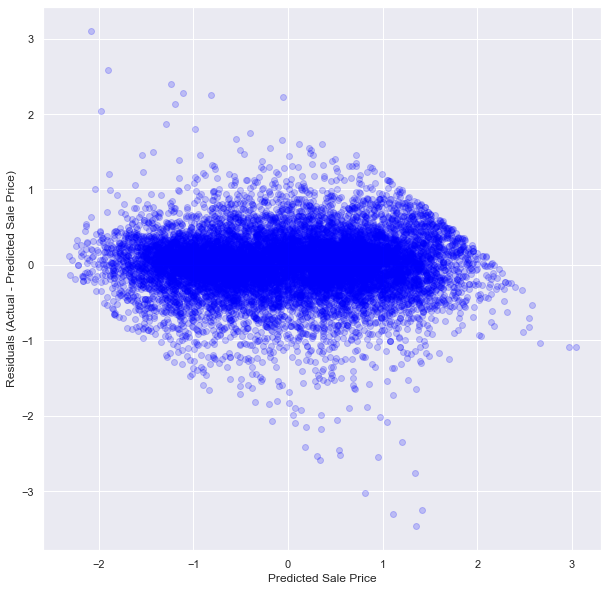

In [521]:
y_hat6 = model6.predict() 
fig3, ax3 = plt.subplots(figsize=(10,10))
ax3.set(xlabel="Predicted Sale Price",
        ylabel="Residuals (Actual - Predicted Sale Price)")
ax3.scatter(x=y_hat6, y=y6-y_hat6, color="blue", alpha=0.2);

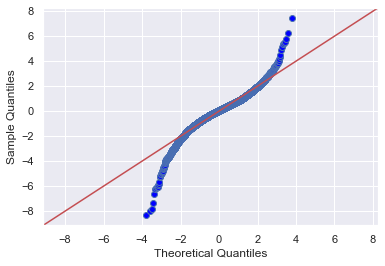

In [522]:
sm.graphics.qqplot(model6.resid, line='45', fit=True);

In [806]:
# continuous7 = ['SalePrice','SqFt1stFloor', 'SqFtTotLiving', 'dist_to_exp']
# categoricals7 = ['ZipCode', 'BldgGrade', 'HeatSystem', 'Condition']

def get_model(cont, binary, cat, df):
    
    ''' takes in list of continuous features (cont)
        list of binary features (binary) a list of categorical features (cat)
        and a dataframe, it returns a linear regression model using sm.OLS'''
    for col in cat:
        df[col] = df[col].astype(str)
    
    kc_cont = df[cont]
    log_names = [f'{column}_log' for column in kc_cont.columns]
    kc_log = np.log(kc_cont)
    kc_log.columns = log_names
    kc_log_norm = kc_log.apply(normalize)
    
    kc_bin = df[binary]
    
    kc_ohe = pd.get_dummies(df[cat], prefix=cat, drop_first=True)
    
    kc_log_norm.hist(bins='auto')
    
    preprocessed = pd.concat([kc_log_norm, kc_ohe, kc_bin], axis=1)
    X = preprocessed.drop('SalePrice_log', axis=1)
    y = preprocessed['SalePrice_log']
    
    predictors_int = sm.add_constant(X)
    
    model = sm.OLS(y,predictors_int).fit()
    
    return model, X, y



<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:          SalePrice_log   R-squared:                       0.966
Model:                            OLS   Adj. R-squared:                  0.966
Method:                 Least Squares   F-statistic:                     2788.
Date:                Tue, 02 Mar 2021   Prob (F-statistic):               0.00
Time:                        16:55:20   Log-Likelihood:                 3448.8
No. Observations:               12468   AIC:                            -6642.
Df Residuals:                   12340   BIC:                            -5690.
Df Model:                         127                                         
Covariance Type:            nonrobust                                         
=========================================================================================
                            coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                   -15.5860      0.161    -96.724      0.000     -15.902     -15.270
SqFt1stFloor_log          0.0429      0.004     10.554      0.000       0.035       0.051
SqFtTotLiving_log         0.2358      0.005     49.908      0.000       0.227       0.245
dist_to_exp_log          -0.0111      0.006     -1.812      0.070      -0.023       0.001
ZipCode_91844             0.6654      0.183      3.642      0.000       0.307       1.024
ZipCode_98001            -0.1416      0.014     -9.881      0.000      -0.170      -0.113
ZipCode_98002            -0.2063      0.016    -12.566      0.000      -0.238      -0.174
ZipCode_98003            -0.1543      0.015    -10.268      0.000      -0.184      -0.125
ZipCode_98004             1.0799      0.030     35.858      0.000       1.021       1.139
ZipCode_98005             0.7459      0.028     26.469      0.000       0.691       0.801
ZipCode_98006             0.6242      0.016     38.482      0.000       0.592       0.656
ZipCode_98007             0.6442      0.023     27.637      0.000       0.599       0.690
ZipCode_98008             0.6607      0.017     38.933      0.000       0.627       0.694
ZipCode_98010            -0.0233      0.033     -0.702      0.483      -0.089       0.042
ZipCode_98011             0.3715      0.019     19.928      0.000       0.335       0.408
ZipCode_98014             0.3522      0.027     13.226      0.000       0.300       0.404
ZipCode_98019             0.3277      0.023     14.140      0.000       0.282       0.373
ZipCode_98022            -0.0946      0.017     -5.660      0.000      -0.127      -0.062
ZipCode_98023            -0.1908      0.013    -14.640      0.000      -0.216      -0.165
ZipCode_98023-7841       -0.2446      0.183     -1.338      0.181      -0.603       0.114
ZipCode_98024             0.4679      0.034     13.741      0.000       0.401       0.535
ZipCode_98027             0.4626      0.019     24.918      0.000       0.426       0.499
ZipCode_98028             0.3643      0.017     21.561      0.000       0.331       0.397
ZipCode_98028-6100        0.4173      0.183      2.283      0.022       0.059       0.776
ZipCode_98029             0.5551      0.018     30.206      0.000       0.519       0.591
ZipCode_98030            -0.0675      0.017     -4.028      0.000      -0.100      -0.035
ZipCode_98031            -0.0520      0.015     -3.439      0.001      -0.082      -0.022
ZipCode_98032            -0.1511      0.021     -7.363      0.000      -0.191      -0.111
ZipCode_98033             0.7788      0.016     47.270      0.000       0.747       0.811
ZipCode_98034             0.5104      0.014     37.080      0.000       0.483       0.537
ZipCode_98034-2540        0.5282      0.183      2.891      0.004       0.170       0.886
ZipCode_98038          

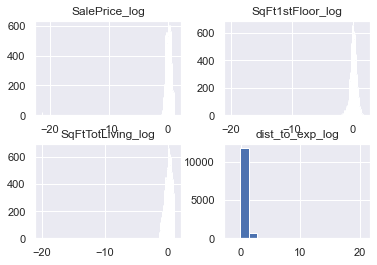

In [621]:
model7, y7 = get_model(continuous, binary_cols, categoricals, final_wft_view)
model7.summary()

In [535]:
def residual_plot(model, y):
    y_hat = model.predict()
    fig3, ax3 = plt.subplots(figsize=(10,10))
    ax3.set(xlabel="Predicted Sale Price",
        ylabel="Residuals (Actual - Predicted Sale Price)")
    ax3.scatter(x=y_hat, y=y-y_hat, color="blue", alpha=0.2);
  

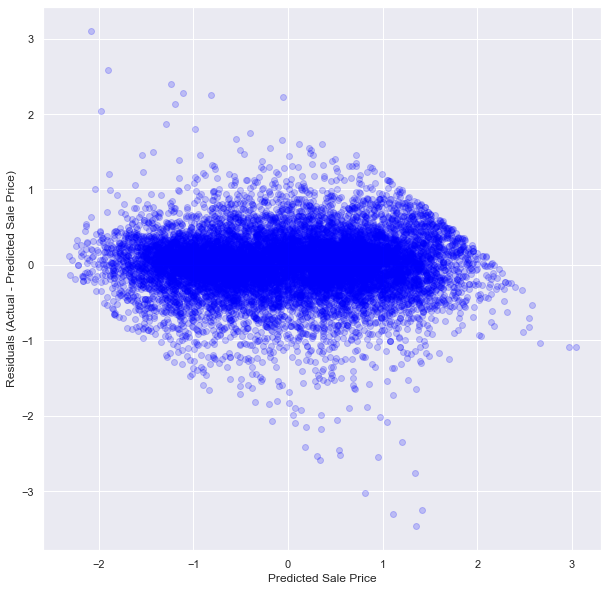

In [536]:
residual_plot(model7, y7)

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:          SalePrice_log   R-squared:                       0.825
Model:                            OLS   Adj. R-squared:                  0.823
Method:                 Least Squares   F-statistic:                     441.1
Date:                Tue, 02 Mar 2021   Prob (F-statistic):               0.00
Time:                        17:14:16   Log-Likelihood:                -6919.8
No. Observations:               12655   AIC:                         1.411e+04
Df Residuals:                   12520   BIC:                         1.511e+04
Df Model:                         134                                         
Covariance Type:            nonrobust                                         
=========================================================================================
                            coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                     0.5668      0.503      1.126      0.260      -0.420       1.553
SqFt1stFloor_log          0.0516      0.005     10.352      0.000       0.042       0.061
SqFtTotLiving_log         0.2946      0.007     44.251      0.000       0.282       0.308
dist_to_exp_log          -0.2701      0.015    -17.670      0.000      -0.300      -0.240
ZipCode_98001            -1.1653      0.423     -2.755      0.006      -1.994      -0.336
ZipCode_98002            -1.2756      0.423     -3.012      0.003      -2.106      -0.445
ZipCode_98003            -1.1833      0.423     -2.797      0.005      -2.013      -0.354
ZipCode_98004             0.7624      0.426      1.791      0.073      -0.072       1.597
ZipCode_98005             0.1831      0.425      0.431      0.666      -0.650       1.016
ZipCode_98006            -0.1766      0.422     -0.419      0.675      -1.003       0.650
ZipCode_98007             0.0595      0.423      0.141      0.888      -0.770       0.889
ZipCode_98008             0.1944      0.422      0.461      0.645      -0.633       1.021
ZipCode_98010            -0.8628      0.429     -2.012      0.044      -1.703      -0.022
ZipCode_98011            -0.3111      0.423     -0.736      0.462      -1.139       0.517
ZipCode_98014            -0.1461      0.425     -0.343      0.731      -0.980       0.688
ZipCode_98019            -0.1863      0.424     -0.439      0.661      -1.018       0.646
ZipCode_98022            -0.8982      0.425     -2.116      0.034      -1.730      -0.066
ZipCode_98023            -1.2269      0.423     -2.901      0.004      -2.056      -0.398
ZipCode_98023-7841       -1.3609      0.596     -2.283      0.022      -2.529      -0.193
ZipCode_98024             0.0879      0.428      0.205      0.837      -0.751       0.927
ZipCode_98027            -0.0604      0.423     -0.143      0.886      -0.889       0.768
ZipCode_98028            -0.3714      0.422     -0.880      0.379      -1.199       0.456
ZipCode_98028-6100       -0.1937      0.595     -0.326      0.745      -1.360       0.972
ZipCode_98029             0.1760      0.423      0.416      0.677      -0.653       1.005
ZipCode_98030            -1.1022      0.423     -2.606      0.009      -1.931      -0.273
ZipCode_98031            -1.1543      0.422     -2.734      0.006      -1.982      -0.327
ZipCode_98032            -1.2898      0.424     -3.044      0.002      -2.120      -0.459
ZipCode_98033             0.3856      0.422      0.915      0.360      -0.441       1.212
ZipCode_98034            -0.1281      0.421     -0.304      0.761      -0.954       0.698
ZipCode_98034-2540       -0.2087      0.595     -0.351      0.726      -1.375       0.957
ZipCode_98038            -0.7975      0.423     -1.887      0.059      -1.626       0.031
ZipCode_98039          

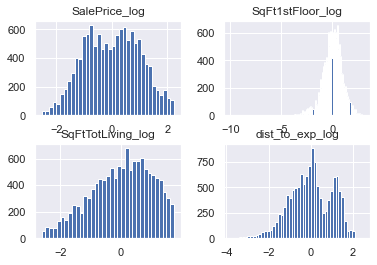

In [646]:
continuous8 = ['SalePrice', 'SqFt1stFloor', 'SqFtTotLiving', 'dist_to_exp']# continuous7 = ['SalePrice',, 'SqFtTotLiving', ]
# categoricals7 = ['ZipCode', , , ]
categoricals8 = ['ZipCode', 'HeatSystem','Condition', 'BldgGrade', 'Bedrooms']
binary_cols8 = ['has_porch', 'has_basement','has_garage', 'renovation', 'has_deck', 'MtRainier','Olympics', 'Cascades', 'Territorial',\
               'SeattleSkyline', 'PugetSound','LakeWashington', 'LakeSammamish', 'SmallLakeRiverCreek', 'OtherView',\
               'WfntLocation']

model8, y8 = get_model(continuous8, binary_cols8, categoricals8, final_df)
model8.summary()

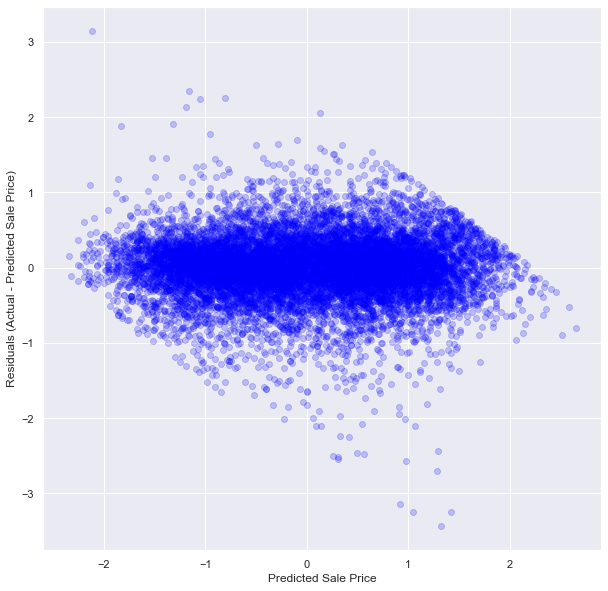

In [615]:
residual_plot(model8, y8)

In [546]:
final_wft_view.Bedrooms.value_counts()

3    6348
4    3709
2    1627
5     625
6      75
1      69
7       7
0       4
8       4
Name: Bedrooms, dtype: int64

In [588]:
final_wft_view.dist_to_exp.unique()

array([3.000e+01, 4.000e+00, 1.000e+00, 8.000e+00, 2.000e+00, 2.000e+01,
       3.500e+01, 9.000e+00, 1.400e+01, 2.900e+01, 7.000e+00, 3.100e+01,
       2.200e+01, 1.000e+01, 2.100e+01, 2.400e+01, 1.100e+01, 1.500e+01,
       1.800e+01, 1.000e-02, 1.600e+01, 2.600e+01, 2.500e+01, 6.000e+00,
       2.700e+01, 1.300e+01, 3.200e+01, 1.200e+01, 2.300e+01, 1.700e+01,
       3.000e+00, 5.000e+00, 3.600e+01, 2.800e+01, 3.700e+01, 4.000e+01,
       1.900e+01, 4.200e+01, 3.800e+01, 3.300e+01, 3.900e+01, 4.100e+01,
       3.400e+01, 4.400e+01, 4.300e+01, 4.600e+01, 4.500e+01, 4.700e+01,
       5.600e+01, 5.900e+01, 2.395e+03])

In [576]:
final_final_wft_view.dist_to_exp.dtype

dtype('int32')

In [584]:
final_wft_view['dist_to_exp'] = final_wft_view['dist_to_exp'].astype(float)

In [587]:

final_wft_view[final_wft_view['dist_to_exp'] == 0] = 0.01 

In [640]:
final_df['lat_long'] = tuple(zip(final_df.latitude_y, final_df.longitude_y))
final_df['laurelcrest'] = calc_distances(final_df['lat_long'], laurelcrest, final_df)
final_df['medina'] = calc_distances(final_df['lat_long'], medina, final_df)
final_df['mercer'] = calc_distances(final_df['lat_long'], mercer, final_df)


final_df['dist_to_exp'] = final_df[['laurelcrest', 'medina', 'mercer']].min(axis=1, numeric_only=True)

final_df.drop(['laurelcrest', 'medina', 'mercer'], axis=1, inplace=True)

In [604]:
final_wft_view.dist_to_exp.isna().sum()

0

In [629]:
final_wft_view['latitude'].head()

0    47.0
1    47.0
2    47.0
3    47.0
4    47.0
Name: latitude, dtype: float64

In [605]:
final_wft_view.isna().sum()

id                     0
DocumentDate           0
SalePrice              0
Address                0
BuildingNumber         0
DirectionPrefix        0
StreetName             0
StreetType             0
DirectionSuffix        0
ZipCode                0
Stories                0
BldgGrade              0
SqFt1stFloor           0
SqFtHalfFloor          0
SqFt2ndFloor           0
SqFtUpperFloor         0
SqFtTotLiving          0
SqFtTotBasement        0
SqFtGarageBasement     0
SqFtGarageAttached     0
DaylightBasement       0
SqFtOpenPorch          0
SqFtEnclosedPorch      0
SqFtDeck               0
HeatSystem             0
HeatSource             0
BrickStone             0
Bedrooms               0
BathHalfCount          0
Bath3qtrCount          0
BathFullCount          0
YrBuilt                0
YrRenovated            0
Condition              0
Township               0
Section                0
QuarterSection         0
Area                   0
DistrictName           0
SqFtLot                0


In [627]:
final_wft_view['dist_to_exp'].value_counts()

63.901046       11785
110.445550        659
12350.481226       22
2476.544176         1
43.317407           1
Name: dist_to_exp, dtype: int64

In [613]:
final_df = final_wft_view[final_wft_view['dist_to_exp']<1000].copy()

Looking at this model it is clear there is a lot of zipcodes that have a P-value > 0.05. It may be worth exploring the zip code features and dropping some that are erroneous. Likewise the bedroom features make little sense, appearing to lose value vs a 0 bedroom home. I will remove homes with 0 bedrooms from the model. 

In [617]:
np.exp(1)

2.718281828459045

array([[<AxesSubplot:title={'center':'SalePrice_log'}>,
        <AxesSubplot:title={'center':'SqFt1stFloor_log'}>],
       [<AxesSubplot:title={'center':'SqFtTotLiving_log'}>,
        <AxesSubplot:title={'center':'dist_to_exp_log'}>]], dtype=object)

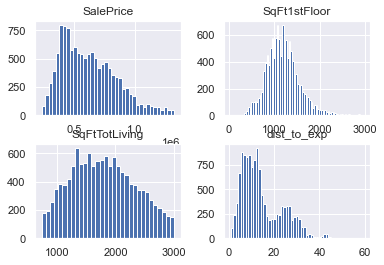

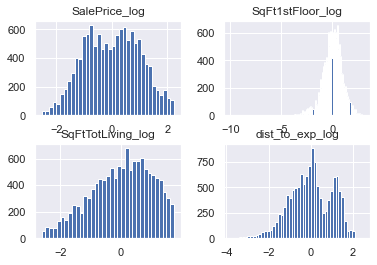

In [649]:
kc_cont = final_df[continuous8]
kc_cont.hist(bins='auto')
log_names = [f'{column}_log' for column in kc_cont.columns]
kc_log = np.log(kc_cont)
kc_log.columns = log_names
kc_log_norm = kc_log.apply(normalize)

kc_log_norm.hist(bins='auto')

In [641]:
final_df.latitude_y

0        47.284930
1        47.284930
2        47.284930
3        47.284930
4        47.634151
           ...    
12650    47.306190
12651    47.307346
12652    47.309836
12653    47.370955
12654    47.617693
Name: latitude_y, Length: 12655, dtype: float64

In [624]:
np.log(110)

4.700480365792417

In [636]:
final_df = final_df.merge(for_map[['id','latitude', 'longitude']].copy(), how='left', on='id')

In [638]:
final_df.drop(columns=['latitude_x', 'longitude_x', 'lat_long'], inplace=True)

In [642]:
final_df.head()

,id,DocumentDate,SalePrice,Address,BuildingNumber,DirectionPrefix,StreetName,StreetType,DirectionSuffix,ZipCode,Stories,BldgGrade,SqFt1stFloor,SqFtHalfFloor,SqFt2ndFloor,SqFtUpperFloor,SqFtTotLiving,SqFtTotBasement,SqFtGarageBasement,SqFtGarageAttached,DaylightBasement,SqFtOpenPorch,SqFtEnclosedPorch,SqFtDeck,HeatSystem,HeatSource,BrickStone,Bedrooms,BathHalfCount,Bath3qtrCount,BathFullCount,YrBuilt,YrRenovated,Condition,Township,Section,QuarterSection,Area,DistrictName,SqFtLot,Access,StreetSurface,InadequateParking,TrafficNoise,address,location,point,renovation,dist_to_exp,has_basement,has_garage,has_porch,has_deck,WfntLocation,MtRainier,Olympics,Cascades,Territorial,SeattleSkyline,PugetSound,LakeWashington,LakeSammamish,SmallLakeRiverCreek,OtherView,latitude_y,longitude_y,lat_long
0,0100500380,12/12/2019,445000.0,2435 S 354TH ST 98003,2435,S,354TH,street,,98003,1,7,1480.0,0.0,0.0,0.0,1480.0,0.0,0.0,440.0,N,80.0,0.0,120.0,forced_air,2.0,0,3,0.0,0.0,2.0,1994.0,0.0,5,21,28,NE,55,KING COUNTY,6446.0,4.0,1.0,2.0,0.0,"2435 S 354TH street , ...","(2435, South 354th Street, Emery Woods, Federa...","(47.28493, -122.30216590825634, 0.0)",0.0,30.902423,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,47.284930,-122.302166,"(47.28493, -122.30216590825634)"
1,0100500380,12/12/2019,445000.0,2435 S 354TH ST 98003,2435,S,354TH,street,,98003,1,7,1480.0,0.0,0.0,0.0,1480.0,0.0,0.0,440.0,N,80.0,0.0,120.0,forced_air,2.0,0,3,0.0,0.0,2.0,1994.0,0.0,5,21,28,NE,55,KING COUNTY,6446.0,4.0,1.0,2.0,0.0,"2435 S 354TH street , ...","(2435, South 354th Street, Emery Woods, Federa...","(47.28493, -122.30216590825634, 0.0)",0.0,30.902423,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,47.284930,-122.302166,"(47.28493, -122.30216590825634)"
2,0100500380,08/16/2019,311000.0,2435 S 354TH ST 98003,2435,S,354TH,street,,98003,1,7,1480.0,0.0,0.0,0.0,1480.0,0.0,0.0,440.0,N,80.0,0.0,120.0,forced_air,2.0,0,3,0.0,0.0,2.0,1994.0,0.0,5,21,28,NE,55,KING COUNTY,6446.0,4.0,1.0,2.0,0.0,"2435 S 354TH street , ...","(2435, South 354th Street, Emery Woods, Federa...","(47.28493, -122.30216590825634, 0.0)",0.0,30.902423,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,47.284930,-122.302166,"(47.28493, -122.30216590825634)"
3,0100500380,08/16/2019,311000.0,2435 S 354TH ST 98003,2435,S,354TH,street,,98003,1,7,1480.0,0.0,0.0,0.0,1480.0,0.0,0.0,440.0,N,80.0,0.0,120.0,forced_air,2.0,0,3,0.0,0.0,2.0,1994.0,0.0,5,21,28,NE,55,KING COUNTY,6446.0,4.0,1.0,2.0,0.0,"2435 S 354TH street , ...","(2435, South 354th Street, Emery Woods, Federa...","(47.28493, -122.30216590825634, 0.0)",0.0,30.902423,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,47.284930,-122.302166,"(47.28493, -122.30216590825634)"
4,0188000095,08/30/2019,730000.0,1602 LAKEVIEW BLVD E 98102,1602,,LAKEVIEW,boulevard,E,98102,2,9,660.0,0.0,595.0,0.0,1540.0,380.0,0.0,0.0,Y,0.0,0.0,155.0,floor_wall,3.0,0,3,1.0,1.0,1.0,1984.0,0.0,3,25,20,SE,13,SEATTLE,3117.0,4.0,1.0,0.0,3.0,1602 LAKEVIEW boulevard E...,"(1602, Lakeview Boulevard East, Capitol Hill, ...","(47.6341511, -122.322067, 0.0)",0.0,4.440804,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,47.634151,-122.322067,"(47.6341511, -122.322067)"


<AxesSubplot:>

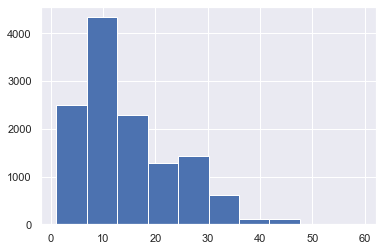

In [645]:
final_df['dist_to_exp'].hist()

Distance to expensive areas seems to be the biggest offender in terms of normality, it looks at if there is a second peak in the distribution indication there is a populous area I have left out. Doing some research I think I could add in distance to most expensive streets in renton and kent. 

148th Ave SE, Kent, WA is the most expensive neighbourhood in kent and quite populous, I think adding this will normalise the dist_to_exp column.

In [652]:
kent_df = final_df.copy()

In [653]:
kent_df['lat_long'] = tuple(zip(kent_df.latitude_y, kent_df.longitude_y))
kent_df['laurelcrest'] = calc_distances(kent_df['lat_long'], laurelcrest, kent_df)
kent_df['medina'] = calc_distances(kent_df['lat_long'], medina, kent_df)
kent_df['mercer'] = calc_distances(kent_df['lat_long'], mercer, final_df)
kent_df['kent'] = calc_distances(kent_df['lat_long'], kent, final_df)


kent_df['dist_to_exp'] = kent_df[['laurelcrest', 'medina', 'mercer', 'kent']].min(axis=1, numeric_only=True)

kent_df.drop(['laurelcrest', 'medina', 'mercer', 'kent'], axis=1, inplace=True)

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:          SalePrice_log   R-squared:                       0.823
Model:                            OLS   Adj. R-squared:                  0.821
Method:                 Least Squares   F-statistic:                     434.1
Date:                Tue, 02 Mar 2021   Prob (F-statistic):               0.00
Time:                        18:12:51   Log-Likelihood:                -7004.0
No. Observations:               12655   AIC:                         1.428e+04
Df Residuals:                   12520   BIC:                         1.528e+04
Df Model:                         134                                         
Covariance Type:            nonrobust                                         
=========================================================================================
                            coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                     0.7796      0.506      1.540      0.124      -0.213       1.772
SqFt1stFloor_log          0.0524      0.005     10.450      0.000       0.043       0.062
SqFtTotLiving_log         0.2919      0.007     43.551      0.000       0.279       0.305
dist_to_exp_log          -0.1247      0.010    -11.936      0.000      -0.145      -0.104
ZipCode_98001            -1.6552      0.424     -3.901      0.000      -2.487      -0.824
ZipCode_98002            -1.8261      0.425     -4.300      0.000      -2.658      -0.994
ZipCode_98003            -1.6414      0.425     -3.866      0.000      -2.474      -0.809
ZipCode_98004             0.8524      0.429      1.989      0.047       0.012       1.692
ZipCode_98005             0.1863      0.428      0.436      0.663      -0.652       1.025
ZipCode_98006            -0.1389      0.424     -0.327      0.743      -0.971       0.693
ZipCode_98007             0.0096      0.426      0.023      0.982      -0.826       0.845
ZipCode_98008             0.1008      0.425      0.237      0.812      -0.732       0.933
ZipCode_98010            -1.4173      0.430     -3.296      0.001      -2.260      -0.574
ZipCode_98011            -0.4774      0.425     -1.123      0.262      -1.311       0.356
ZipCode_98014            -0.4412      0.428     -1.032      0.302      -1.279       0.397
ZipCode_98019            -0.4838      0.427     -1.134      0.257      -1.320       0.352
ZipCode_98022            -1.4440      0.425     -3.394      0.001      -2.278      -0.610
ZipCode_98023            -1.6696      0.424     -3.934      0.000      -2.501      -0.838
ZipCode_98023-7841       -1.7922      0.599     -2.991      0.003      -2.967      -0.618
ZipCode_98024            -0.1896      0.430     -0.440      0.660      -1.033       0.654
ZipCode_98027            -0.2734      0.425     -0.643      0.520      -1.107       0.560
ZipCode_98028            -0.5203      0.425     -1.225      0.221      -1.353       0.312
ZipCode_98028-6100       -0.3659      0.599     -0.611      0.541      -1.540       0.808
ZipCode_98029            -0.0315      0.425     -0.074      0.941      -0.865       0.802
ZipCode_98030            -1.7325      0.424     -4.081      0.000      -2.565      -0.900
ZipCode_98031            -1.6900      0.424     -3.984      0.000      -2.521      -0.859
ZipCode_98032            -1.7175      0.426     -4.036      0.000      -2.552      -0.883
ZipCode_98033             0.3199      0.424      0.754      0.451      -0.512       1.152
ZipCode_98034            -0.2326      0.424     -0.549      0.583      -1.064       0.599
ZipCode_98034-2540       -0.2588      0.599     -0.432      0.666      -1.432       0.915
ZipCode_98038            -1.3360      0.424     -3.151      0.002      -2.167      -0.505
ZipCode_98039          

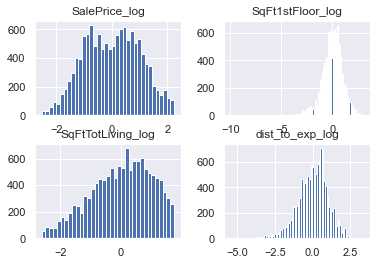

In [654]:
model9, y9 = get_model(continuous8, binary_cols8, categoricals8, kent_df)
model9.summary()

lets inspect the 1st floor square footage, seems to be something strange happening in the transformation

In [658]:
kent_df.SqFt1stFloor.min()

50.0

In [659]:
kent_df.SqFtTotLiving.min()

730.0

<AxesSubplot:>

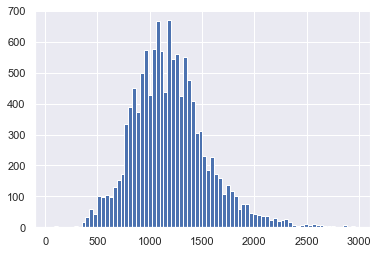

In [661]:
kent_df.SqFt1stFloor.hist(bins='auto')

<AxesSubplot:>

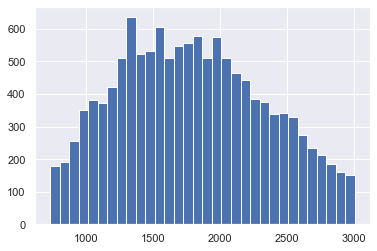

In [662]:
kent_df.SqFtTotLiving.hist(bins='auto')

In [663]:
kent_df.head()

,id,DocumentDate,SalePrice,Address,BuildingNumber,DirectionPrefix,StreetName,StreetType,DirectionSuffix,ZipCode,Stories,BldgGrade,SqFt1stFloor,SqFtHalfFloor,SqFt2ndFloor,SqFtUpperFloor,SqFtTotLiving,SqFtTotBasement,SqFtGarageBasement,SqFtGarageAttached,DaylightBasement,SqFtOpenPorch,SqFtEnclosedPorch,SqFtDeck,HeatSystem,HeatSource,BrickStone,Bedrooms,BathHalfCount,Bath3qtrCount,BathFullCount,YrBuilt,YrRenovated,Condition,Township,Section,QuarterSection,Area,DistrictName,SqFtLot,Access,StreetSurface,InadequateParking,TrafficNoise,address,location,point,renovation,dist_to_exp,has_basement,has_garage,has_porch,has_deck,WfntLocation,MtRainier,Olympics,Cascades,Territorial,SeattleSkyline,PugetSound,LakeWashington,LakeSammamish,SmallLakeRiverCreek,OtherView,latitude_y,longitude_y,lat_long
0,0100500380,12/12/2019,445000.0,2435 S 354TH ST 98003,2435,S,354TH,street,,98003,1,7,1480.0,0.0,0.0,0.0,1480.0,0.0,0.0,440.0,N,80.0,0.0,120.0,forced_air,2.0,0,3,0.0,0.0,2.0,1994.0,0.0,5,21,28,NE,55,KING COUNTY,6446.0,4.0,1.0,2.0,0.0,"2435 S 354TH street , ...","(2435, South 354th Street, Emery Woods, Federa...","(47.28493, -122.30216590825634, 0.0)",0.0,16.340042,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,47.284930,-122.302166,"(47.28493, -122.30216590825634)"
1,0100500380,12/12/2019,445000.0,2435 S 354TH ST 98003,2435,S,354TH,street,,98003,1,7,1480.0,0.0,0.0,0.0,1480.0,0.0,0.0,440.0,N,80.0,0.0,120.0,forced_air,2.0,0,3,0.0,0.0,2.0,1994.0,0.0,5,21,28,NE,55,KING COUNTY,6446.0,4.0,1.0,2.0,0.0,"2435 S 354TH street , ...","(2435, South 354th Street, Emery Woods, Federa...","(47.28493, -122.30216590825634, 0.0)",0.0,16.340042,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,47.284930,-122.302166,"(47.28493, -122.30216590825634)"
2,0100500380,08/16/2019,311000.0,2435 S 354TH ST 98003,2435,S,354TH,street,,98003,1,7,1480.0,0.0,0.0,0.0,1480.0,0.0,0.0,440.0,N,80.0,0.0,120.0,forced_air,2.0,0,3,0.0,0.0,2.0,1994.0,0.0,5,21,28,NE,55,KING COUNTY,6446.0,4.0,1.0,2.0,0.0,"2435 S 354TH street , ...","(2435, South 354th Street, Emery Woods, Federa...","(47.28493, -122.30216590825634, 0.0)",0.0,16.340042,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,47.284930,-122.302166,"(47.28493, -122.30216590825634)"
3,0100500380,08/16/2019,311000.0,2435 S 354TH ST 98003,2435,S,354TH,street,,98003,1,7,1480.0,0.0,0.0,0.0,1480.0,0.0,0.0,440.0,N,80.0,0.0,120.0,forced_air,2.0,0,3,0.0,0.0,2.0,1994.0,0.0,5,21,28,NE,55,KING COUNTY,6446.0,4.0,1.0,2.0,0.0,"2435 S 354TH street , ...","(2435, South 354th Street, Emery Woods, Federa...","(47.28493, -122.30216590825634, 0.0)",0.0,16.340042,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,47.284930,-122.302166,"(47.28493, -122.30216590825634)"
4,0188000095,08/30/2019,730000.0,1602 LAKEVIEW BLVD E 98102,1602,,LAKEVIEW,boulevard,E,98102,2,9,660.0,0.0,595.0,0.0,1540.0,380.0,0.0,0.0,Y,0.0,0.0,155.0,floor_wall,3.0,0,3,1.0,1.0,1.0,1984.0,0.0,3,25,20,SE,13,SEATTLE,3117.0,4.0,1.0,0.0,3.0,1602 LAKEVIEW boulevard E...,"(1602, Lakeview Boulevard East, Capitol Hill, ...","(47.6341511, -122.322067, 0.0)",0.0,4.440804,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,47.634151,-122.322067,"(47.6341511, -122.322067)"


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:          SalePrice_log   R-squared:                       0.824
Model:                            OLS   Adj. R-squared:                  0.822
Method:                 Least Squares   F-statistic:                     432.7
Date:                Tue, 02 Mar 2021   Prob (F-statistic):               0.00
Time:                        19:44:44   Log-Likelihood:                -6981.2
No. Observations:               12655   AIC:                         1.423e+04
Df Residuals:                   12519   BIC:                         1.525e+04
Df Model:                         135                                         
Covariance Type:            nonrobust                                         
=========================================================================================
                            coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                     0.6636      0.506      1.312      0.189      -0.328       1.655
SqFt1stFloor_log          0.0846      0.007     12.212      0.000       0.071       0.098
SqFtTotLiving_log         0.2626      0.008     32.905      0.000       0.247       0.278
dist_to_exp_log          -0.1259      0.010    -12.070      0.000      -0.146      -0.105
ZipCode_98001            -1.6237      0.424     -3.833      0.000      -2.454      -0.793
ZipCode_98002            -1.7958      0.424     -4.236      0.000      -2.627      -0.965
ZipCode_98003            -1.6132      0.424     -3.806      0.000      -2.444      -0.782
ZipCode_98004             0.8860      0.428      2.071      0.038       0.047       1.725
ZipCode_98005             0.2159      0.427      0.506      0.613      -0.621       1.053
ZipCode_98006            -0.1076      0.424     -0.254      0.800      -0.938       0.723
ZipCode_98007             0.0470      0.425      0.110      0.912      -0.787       0.881
ZipCode_98008             0.1328      0.424      0.313      0.754      -0.698       0.964
ZipCode_98010            -1.3935      0.429     -3.246      0.001      -2.235      -0.552
ZipCode_98011            -0.4528      0.424     -1.067      0.286      -1.285       0.379
ZipCode_98014            -0.4118      0.427     -0.965      0.335      -1.249       0.425
ZipCode_98019            -0.4623      0.426     -1.085      0.278      -1.297       0.373
ZipCode_98022            -1.4181      0.425     -3.339      0.001      -2.251      -0.586
ZipCode_98023            -1.6373      0.424     -3.864      0.000      -2.468      -0.807
ZipCode_98023-7841       -1.7439      0.598     -2.916      0.004      -2.916      -0.571
ZipCode_98024            -0.1574      0.430     -0.366      0.714      -1.000       0.685
ZipCode_98027            -0.2501      0.425     -0.589      0.556      -1.082       0.582
ZipCode_98028            -0.4941      0.424     -1.165      0.244      -1.325       0.337
ZipCode_98028-6100       -0.3149      0.598     -0.527      0.598      -1.487       0.857
ZipCode_98029            -0.0131      0.425     -0.031      0.975      -0.845       0.819
ZipCode_98030            -1.7084      0.424     -4.031      0.000      -2.539      -0.878
ZipCode_98031            -1.6639      0.423     -3.929      0.000      -2.494      -0.834
ZipCode_98032            -1.6830      0.425     -3.962      0.000      -2.516      -0.850
ZipCode_98033             0.3459      0.424      0.817      0.414      -0.485       1.176
ZipCode_98034            -0.2034      0.423     -0.480      0.631      -1.033       0.626
ZipCode_98034-2540       -0.2215      0.598     -0.371      0.711      -1.393       0.950
ZipCode_98038            -1.3145      0.423     -3.105      0.002      -2.144      -0.485
ZipCode_98039          

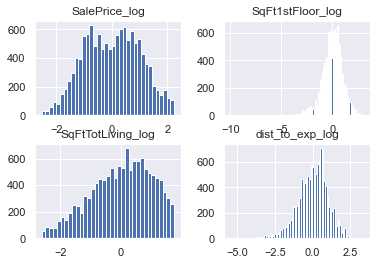

In [680]:
model10, y10 = get_model(continuous8, binary_cols9, categoricals8, kent_df)
model10.summary()

In [675]:
continuous8 = ['SalePrice', 'SqFt1stFloor', 'SqFtTotLiving', 'dist_to_exp']

In [679]:
binary_cols9 = ['has_porch',
 'has_basement',
 'has_garage',
 'renovation',
 'has_deck',
 'MtRainier',
 'Olympics',
 'Cascades',
 'Territorial',
 'SeattleSkyline',
 'PugetSound',
 'LakeWashington',
 'LakeSammamish',
 'SmallLakeRiverCreek',
 'OtherView',
 'WfntLocation', 'duplex']

In [668]:
kent_df['duplex'] = kent_df.SqFt2ndFloor.apply(transform)

In [683]:
kent_df['age'] = 2019-kent_df.YrBuilt

<AxesSubplot:>

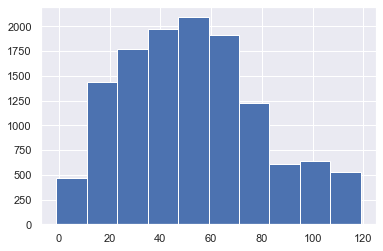

In [684]:
kent_df['age'].hist()

In [685]:
kent_df['age'].min()

-1.0

In [687]:
kent_df['YrBuilt'].describe()

count    12655.000000
mean      1966.716871
std         27.313106
min       1900.000000
25%       1950.000000
50%       1968.000000
75%       1987.000000
max       2020.000000
Name: YrBuilt, dtype: float64

In [691]:
kent_df = kent_df[kent_df['YrBuilt']!=2020]

In [692]:
kent_df['YrBuilt'].describe()

count    12654.000000
mean      1966.712660
std         27.310077
min       1900.000000
25%       1950.000000
50%       1968.000000
75%       1987.000000
max       2019.000000
Name: YrBuilt, dtype: float64

In [697]:
kent_df['age_norm'] = normalize(kent_df['age']) 

In [698]:
kent_df.head()

,id,DocumentDate,SalePrice,Address,BuildingNumber,DirectionPrefix,StreetName,StreetType,DirectionSuffix,ZipCode,Stories,BldgGrade,SqFt1stFloor,SqFtHalfFloor,SqFt2ndFloor,SqFtUpperFloor,SqFtTotLiving,SqFtTotBasement,SqFtGarageBasement,SqFtGarageAttached,DaylightBasement,SqFtOpenPorch,SqFtEnclosedPorch,SqFtDeck,HeatSystem,HeatSource,BrickStone,Bedrooms,BathHalfCount,Bath3qtrCount,BathFullCount,YrBuilt,YrRenovated,Condition,Township,Section,QuarterSection,Area,DistrictName,SqFtLot,Access,StreetSurface,InadequateParking,TrafficNoise,address,location,point,renovation,dist_to_exp,has_basement,has_garage,has_porch,has_deck,WfntLocation,MtRainier,Olympics,Cascades,Territorial,SeattleSkyline,PugetSound,LakeWashington,LakeSammamish,SmallLakeRiverCreek,OtherView,latitude_y,longitude_y,lat_long,duplex,age,age_norm
0,0100500380,12/12/2019,445000.0,2435 S 354TH ST 98003,2435,S,354TH,street,,98003,1,7,1480.0,0.0,0.0,0.0,1480.0,0.0,0.0,440.0,N,80.0,0.0,120.0,forced_air,2.0,0,3,0.0,0.0,2.0,1994.0,0.0,5,21,28,NE,55,KING COUNTY,6446.0,4.0,1.0,2.0,0.0,"2435 S 354TH street , ...","(2435, South 354th Street, Emery Woods, Federa...","(47.28493, -122.30216590825634, 0.0)",0.0,16.340042,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,47.284930,-122.302166,"(47.28493, -122.30216590825634)",0,25.0,-0.999167
1,0100500380,12/12/2019,445000.0,2435 S 354TH ST 98003,2435,S,354TH,street,,98003,1,7,1480.0,0.0,0.0,0.0,1480.0,0.0,0.0,440.0,N,80.0,0.0,120.0,forced_air,2.0,0,3,0.0,0.0,2.0,1994.0,0.0,5,21,28,NE,55,KING COUNTY,6446.0,4.0,1.0,2.0,0.0,"2435 S 354TH street , ...","(2435, South 354th Street, Emery Woods, Federa...","(47.28493, -122.30216590825634, 0.0)",0.0,16.340042,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,47.284930,-122.302166,"(47.28493, -122.30216590825634)",0,25.0,-0.999167
2,0100500380,08/16/2019,311000.0,2435 S 354TH ST 98003,2435,S,354TH,street,,98003,1,7,1480.0,0.0,0.0,0.0,1480.0,0.0,0.0,440.0,N,80.0,0.0,120.0,forced_air,2.0,0,3,0.0,0.0,2.0,1994.0,0.0,5,21,28,NE,55,KING COUNTY,6446.0,4.0,1.0,2.0,0.0,"2435 S 354TH street , ...","(2435, South 354th Street, Emery Woods, Federa...","(47.28493, -122.30216590825634, 0.0)",0.0,16.340042,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,47.284930,-122.302166,"(47.28493, -122.30216590825634)",0,25.0,-0.999167
3,0100500380,08/16/2019,311000.0,2435 S 354TH ST 98003,2435,S,354TH,street,,98003,1,7,1480.0,0.0,0.0,0.0,1480.0,0.0,0.0,440.0,N,80.0,0.0,120.0,forced_air,2.0,0,3,0.0,0.0,2.0,1994.0,0.0,5,21,28,NE,55,KING COUNTY,6446.0,4.0,1.0,2.0,0.0,"2435 S 354TH street , ...","(2435, South 354th Street, Emery Woods, Federa...","(47.28493, -122.30216590825634, 0.0)",0.0,16.340042,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,47.284930,-122.302166,"(47.28493, -122.30216590825634)",0,25.0,-0.999167
4,0188000095,08/30/2019,730000.0,1602 LAKEVIEW BLVD E 98102,1602,,LAKEVIEW,boulevard,E,98102,2,9,660.0,0.0,595.0,0.0,1540.0,380.0,0.0,0.0,Y,0.0,0.0,155.0,floor_wall,3.0,0,3,1.0,1.0,1.0,1984.0,0.0,3,25,20,SE,13,SEATTLE,3117.0,4.0,1.0,0.0,3.0,1602 LAKEVIEW boulevard E...,"(1602, Lakeview Boulevard East, Capitol Hill, ...","(47.6341511, -122.322067, 0.0)",0.0,4.440804,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,47.634151,-122.322067,"(47.6341511, -122.322067)",1,35.0,-0.633002


<AxesSubplot:>

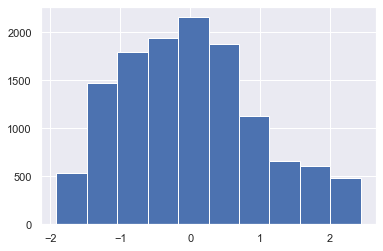

In [701]:
kent_df['age_norm'].hist()

<AxesSubplot:>

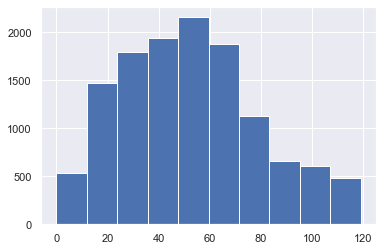

In [702]:
kent_df['age'].hist()

In [703]:
def min_max(feature):
    return (feature - feature.min()) / (feature.max()- feature.min())

In [704]:
kent_df['age_mm'] = min_max(kent_df['age'])

In [715]:
binary_cols11 = ['has_porch',
 'has_basement',
 'has_garage',
 'renovation',
 'has_deck',
 'MtRainier',
 'Olympics',
 'Cascades',
 'Territorial',
 'SeattleSkyline',
 'PugetSound',
 'LakeWashington',
 'LakeSammamish',
 'SmallLakeRiverCreek',
 'OtherView',
 'WfntLocation',
 'duplex', 'age_norm'] 

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:          SalePrice_log   R-squared:                       0.824
Model:                            OLS   Adj. R-squared:                  0.822
Method:                 Least Squares   F-statistic:                     430.4
Date:                Tue, 02 Mar 2021   Prob (F-statistic):               0.00
Time:                        20:18:39   Log-Likelihood:                -6969.4
No. Observations:               12654   AIC:                         1.421e+04
Df Residuals:                   12517   BIC:                         1.523e+04
Df Model:                         136                                         
Covariance Type:            nonrobust                                         
=========================================================================================
                            coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                     0.6752      0.505      1.336      0.181      -0.315       1.666
SqFt1stFloor_log          0.0779      0.007     11.027      0.000       0.064       0.092
SqFtTotLiving_log         0.2661      0.008     33.234      0.000       0.250       0.282
dist_to_exp_log          -0.1244      0.010    -11.929      0.000      -0.145      -0.104
ZipCode_98001            -1.6286      0.423     -3.848      0.000      -2.458      -0.799
ZipCode_98002            -1.8044      0.424     -4.260      0.000      -2.635      -0.974
ZipCode_98003            -1.6203      0.423     -3.826      0.000      -2.450      -0.790
ZipCode_98004             0.8709      0.427      2.037      0.042       0.033       1.709
ZipCode_98005             0.2043      0.427      0.479      0.632      -0.632       1.041
ZipCode_98006            -0.1181      0.423     -0.279      0.780      -0.948       0.712
ZipCode_98007             0.0377      0.425      0.089      0.929      -0.796       0.871
ZipCode_98008             0.1194      0.424      0.282      0.778      -0.711       0.950
ZipCode_98010            -1.3946      0.429     -3.252      0.001      -2.235      -0.554
ZipCode_98011            -0.4616      0.424     -1.089      0.276      -1.293       0.370
ZipCode_98014            -0.4084      0.427     -0.957      0.338      -1.245       0.428
ZipCode_98019            -0.4619      0.426     -1.086      0.278      -1.296       0.372
ZipCode_98022            -1.4260      0.424     -3.360      0.001      -2.258      -0.594
ZipCode_98023            -1.6442      0.423     -3.884      0.000      -2.474      -0.814
ZipCode_98023-7841       -1.7474      0.598     -2.924      0.003      -2.919      -0.576
ZipCode_98024            -0.1640      0.429     -0.382      0.703      -1.006       0.678
ZipCode_98027            -0.2570      0.424     -0.606      0.545      -1.088       0.575
ZipCode_98028            -0.5035      0.424     -1.189      0.235      -1.334       0.327
ZipCode_98028-6100       -0.3136      0.597     -0.525      0.600      -1.484       0.857
ZipCode_98029            -0.0220      0.424     -0.052      0.959      -0.854       0.810
ZipCode_98030            -1.7091      0.423     -4.037      0.000      -2.539      -0.879
ZipCode_98031            -1.6654      0.423     -3.936      0.000      -2.495      -0.836
ZipCode_98032            -1.6906      0.424     -3.983      0.000      -2.523      -0.859
ZipCode_98033             0.3369      0.423      0.796      0.426      -0.493       1.167
ZipCode_98034            -0.2092      0.423     -0.495      0.621      -1.038       0.620
ZipCode_98034-2540       -0.2307      0.597     -0.386      0.699      -1.401       0.940
ZipCode_98038            -1.3111      0.423     -3.100      0.002      -2.140      -0.482
ZipCode_98039          

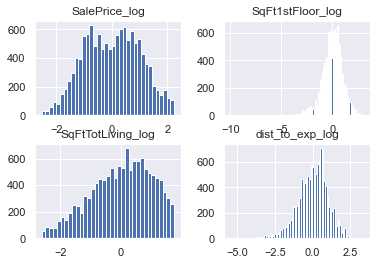

In [716]:
model11, y11 = get_model(continuous8, binary_cols11, categoricals8, kent_df)
model11.summary()

In [721]:
# save absolute value of correlation matrix as a data frame
# converts all values to absolute value
# stacks the row:column pairs into a multindex
# reset the index to set the multindex to seperate columns
# sort values. 0 is the column automatically generated by the stacking

def get_multicol(df):
    
    new_df=df.corr().abs().stack().reset_index().sort_values(0, ascending=False)

# zip the variable name columns (Which were only named level_0 and level_1 by default) in a new column named "pairs"
    new_df['pairs'] = list(zip(new_df.level_0, new_df.level_1))

# set index to pairs
    new_df.set_index(['pairs'], inplace = True)

#d rop level columns
    new_df.drop(columns=['level_1', 'level_0'], inplace = True)

# rename correlation column as cc rather than 0
    new_df.columns = ['cc']

# drop duplicates. This could be dangerous if you have variables perfectly correlated with variables other than themselves.
# for the sake of exercise, kept it in.
    new_df.drop_duplicates(inplace=True)

    return new_df[(new_df.cc>.70) & (new_df.cc <1)]

In [722]:
get_multicol(kent_df)

,cc
pairs,
"(age_norm, age_mm)",1.000000
"(renovation, YrRenovated)",0.999954
"(SqFt2ndFloor, duplex)",0.929454
"(SqFtTotBasement, has_basement)",0.895146
"(age_mm_log, age)",0.878650
"(age_mm_log, YrBuilt)",0.878650
"(age_mm_log, age_norm)",0.878650
"(age_mm, age_mm_log)",0.878650
"(has_deck, SqFtDeck)",0.702797


In [723]:
print(continuous8)
print(binary_cols11)
print(categoricals8)

['SalePrice', 'SqFt1stFloor', 'SqFtTotLiving', 'dist_to_exp']
['has_porch', 'has_basement', 'has_garage', 'renovation', 'has_deck', 'MtRainier', 'Olympics', 'Cascades', 'Territorial', 'SeattleSkyline', 'PugetSound', 'LakeWashington', 'LakeSammamish', 'SmallLakeRiverCreek', 'OtherView', 'WfntLocation', 'duplex', 'age_norm']
['ZipCode', 'HeatSystem', 'Condition', 'BldgGrade', 'Bedrooms']


None of the highly collerated feature pairs appeared in the latest model together, I will look for other possible errors and features

time to look at bathrooms, must be important somehow...

In [724]:
kent_df.head()

,id,DocumentDate,SalePrice,Address,BuildingNumber,DirectionPrefix,StreetName,StreetType,DirectionSuffix,ZipCode,Stories,BldgGrade,SqFt1stFloor,SqFtHalfFloor,SqFt2ndFloor,SqFtUpperFloor,SqFtTotLiving,SqFtTotBasement,SqFtGarageBasement,SqFtGarageAttached,DaylightBasement,SqFtOpenPorch,SqFtEnclosedPorch,SqFtDeck,HeatSystem,HeatSource,BrickStone,Bedrooms,BathHalfCount,Bath3qtrCount,BathFullCount,YrBuilt,YrRenovated,Condition,Township,Section,QuarterSection,Area,DistrictName,SqFtLot,Access,StreetSurface,InadequateParking,TrafficNoise,address,location,point,renovation,dist_to_exp,has_basement,has_garage,has_porch,has_deck,WfntLocation,MtRainier,Olympics,Cascades,Territorial,SeattleSkyline,PugetSound,LakeWashington,LakeSammamish,SmallLakeRiverCreek,OtherView,latitude_y,longitude_y,lat_long,duplex,age,age_norm,age_mm,age_mm_log
0,0100500380,12/12/2019,445000.0,2435 S 354TH ST 98003,2435,S,354TH,street,,98003,1,7,1480.0,0.0,0.0,0.0,1480.0,0.0,0.0,440.0,N,80.0,0.0,120.0,forced_air,2.0,0,3,0.0,0.0,2.0,1994.0,0.0,5,21,28,NE,55,KING COUNTY,6446.0,4.0,1.0,2.0,0.0,"2435 S 354TH street , ...","(2435, South 354th Street, Emery Woods, Federa...","(47.28493, -122.30216590825634, 0.0)",0.0,16.340042,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,47.284930,-122.302166,"(47.28493, -122.30216590825634)",0,25.0,-0.999167,0.210084,-1.560248
1,0100500380,12/12/2019,445000.0,2435 S 354TH ST 98003,2435,S,354TH,street,,98003,1,7,1480.0,0.0,0.0,0.0,1480.0,0.0,0.0,440.0,N,80.0,0.0,120.0,forced_air,2.0,0,3,0.0,0.0,2.0,1994.0,0.0,5,21,28,NE,55,KING COUNTY,6446.0,4.0,1.0,2.0,0.0,"2435 S 354TH street , ...","(2435, South 354th Street, Emery Woods, Federa...","(47.28493, -122.30216590825634, 0.0)",0.0,16.340042,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,47.284930,-122.302166,"(47.28493, -122.30216590825634)",0,25.0,-0.999167,0.210084,-1.560248
2,0100500380,08/16/2019,311000.0,2435 S 354TH ST 98003,2435,S,354TH,street,,98003,1,7,1480.0,0.0,0.0,0.0,1480.0,0.0,0.0,440.0,N,80.0,0.0,120.0,forced_air,2.0,0,3,0.0,0.0,2.0,1994.0,0.0,5,21,28,NE,55,KING COUNTY,6446.0,4.0,1.0,2.0,0.0,"2435 S 354TH street , ...","(2435, South 354th Street, Emery Woods, Federa...","(47.28493, -122.30216590825634, 0.0)",0.0,16.340042,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,47.284930,-122.302166,"(47.28493, -122.30216590825634)",0,25.0,-0.999167,0.210084,-1.560248
3,0100500380,08/16/2019,311000.0,2435 S 354TH ST 98003,2435,S,354TH,street,,98003,1,7,1480.0,0.0,0.0,0.0,1480.0,0.0,0.0,440.0,N,80.0,0.0,120.0,forced_air,2.0,0,3,0.0,0.0,2.0,1994.0,0.0,5,21,28,NE,55,KING COUNTY,6446.0,4.0,1.0,2.0,0.0,"2435 S 354TH street , ...","(2435, South 354th Street, Emery Woods, Federa...","(47.28493, -122.30216590825634, 0.0)",0.0,16.340042,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,47.284930,-122.302166,"(47.28493, -122.30216590825634)",0,25.0,-0.999167,0.210084,-1.560248
4,0188000095,08/30/2019,730000.0,1602 LAKEVIEW BLVD E 98102,1602,,LAKEVIEW,boulevard,E,98102,2,9,660.0,0.0,595.0,0.0,1540.0,380.0,0.0,0.0,Y,0.0,0.0,155.0,floor_wall,3.0,0,3,1.0,1.0,1.0,1984.0,0.0,3,25,20,SE,13,SEATTLE,3117.0,4.0,1.0,0.0,3.0,1602 LAKEVIEW boulevard E...,"(1602, Lakeview Boulevard East, Capitol Hill, ...","(47.6341511, -122.322067, 0.0)",0.0,4.440804,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,47.634151,-122.322067,"(47.6341511, -122.322067)",1,35.0,-0.633002,0.294118,-1.223775


In [725]:
kent_df['bathrooms'] = kent_df['BathHalfCount']*0.5 + kent_df['Bath3qtrCount']*0.75 + kent_df['BathFullCount']

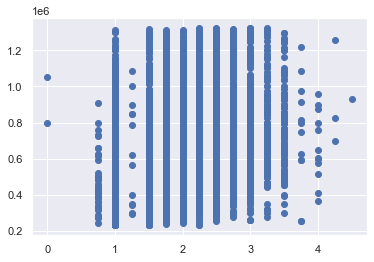

In [729]:
sns.plot(kent_df['bathrooms'], kent_df['SalePrice'])

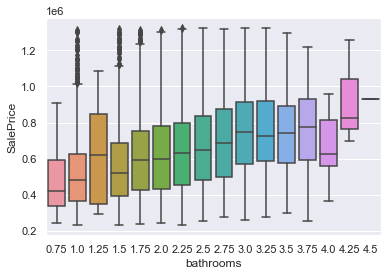

In [779]:
ax = sns.boxplot(x='bathrooms', y="SalePrice", data=zip_cull)

In [736]:
kent_df[kent_df['bathrooms']==0]['bathrooms']

3232    0.0
6683    0.0
Name: bathrooms, dtype: float64

In [737]:
kent_df['bathrooms'].median()

2.0

In [748]:
kent_df.loc[kent_df['bathrooms']==0, 'bathrooms'] = 2.0

Series([], Name: bathrooms, dtype: float64)

<function __main__.<lambda>(x)>

In [751]:
binary_cols12 = ['has_porch',
 'has_basement',
 'has_garage',
 'renovation',
 'has_deck',
 'MtRainier',
 'Olympics',
 'Cascades',
 'Territorial',
 'SeattleSkyline',
 'PugetSound',
 'LakeWashington',
 'LakeSammamish',
 'SmallLakeRiverCreek',
 'OtherView',
 'WfntLocation',
 'duplex', 'age_norm', 'bathrooms'] 

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:          SalePrice_log   R-squared:                       0.824
Model:                            OLS   Adj. R-squared:                  0.822
Method:                 Least Squares   F-statistic:                     428.9
Date:                Tue, 02 Mar 2021   Prob (F-statistic):               0.00
Time:                        21:03:29   Log-Likelihood:                -6949.2
No. Observations:               12654   AIC:                         1.417e+04
Df Residuals:                   12516   BIC:                         1.520e+04
Df Model:                         137                                         
Covariance Type:            nonrobust                                         
=========================================================================================
                            coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                     0.5809      0.505      1.151      0.250      -0.408       1.570
SqFt1stFloor_log          0.0798      0.007     11.299      0.000       0.066       0.094
SqFtTotLiving_log         0.2487      0.008     29.422      0.000       0.232       0.265
dist_to_exp_log          -0.1224      0.010    -11.754      0.000      -0.143      -0.102
ZipCode_98001            -1.6115      0.423     -3.813      0.000      -2.440      -0.783
ZipCode_98002            -1.7808      0.423     -4.211      0.000      -2.610      -0.952
ZipCode_98003            -1.6040      0.423     -3.794      0.000      -2.433      -0.775
ZipCode_98004             0.8930      0.427      2.092      0.036       0.056       1.730
ZipCode_98005             0.2177      0.426      0.511      0.609      -0.617       1.053
ZipCode_98006            -0.0959      0.423     -0.227      0.821      -0.924       0.733
ZipCode_98007             0.0551      0.424      0.130      0.897      -0.777       0.887
ZipCode_98008             0.1377      0.423      0.326      0.745      -0.691       0.967
ZipCode_98010            -1.3687      0.428     -3.196      0.001      -2.208      -0.529
ZipCode_98011            -0.4457      0.423     -1.053      0.293      -1.276       0.384
ZipCode_98014            -0.3886      0.426     -0.912      0.362      -1.224       0.446
ZipCode_98019            -0.4467      0.425     -1.051      0.293      -1.280       0.386
ZipCode_98022            -1.4088      0.424     -3.325      0.001      -2.239      -0.578
ZipCode_98023            -1.6286      0.423     -3.853      0.000      -2.457      -0.800
ZipCode_98023-7841       -1.7643      0.597     -2.957      0.003      -2.934      -0.595
ZipCode_98024            -0.1465      0.429     -0.342      0.733      -0.987       0.694
ZipCode_98027            -0.2393      0.424     -0.565      0.572      -1.070       0.591
ZipCode_98028            -0.4836      0.423     -1.143      0.253      -1.313       0.346
ZipCode_98028-6100       -0.2808      0.596     -0.471      0.638      -1.450       0.888
ZipCode_98029            -0.0098      0.424     -0.023      0.982      -0.840       0.821
ZipCode_98030            -1.6862      0.423     -3.989      0.000      -2.515      -0.858
ZipCode_98031            -1.6455      0.422     -3.895      0.000      -2.474      -0.817
ZipCode_98032            -1.6690      0.424     -3.938      0.000      -2.500      -0.838
ZipCode_98033             0.3605      0.423      0.853      0.394      -0.468       1.189
ZipCode_98034            -0.1923      0.422     -0.455      0.649      -1.020       0.635
ZipCode_98034-2540       -0.1895      0.596     -0.318      0.751      -1.358       0.979
ZipCode_98038            -1.2944      0.422     -3.065      0.002      -2.122      -0.467
ZipCode_98039          

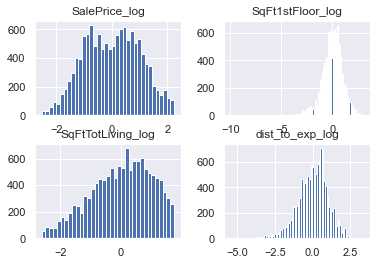

In [752]:
model12, y12 = get_model(continuous8, binary_cols12, categoricals8, kent_df)
model12.summary()

In [757]:
zipcodes = pd.DataFrame(kent_df['ZipCode'].value_counts())

In [755]:
zip_cull = kent_df.copy()

In [769]:
zip_cull = zip_cull[zip_cull['ZipCode'].isin(zips_to_keep)]


In [759]:
zipcodes.index

Index(['98042', '98023', '98058', '98117', '98115', '98034', '98038', '98133',
       '98001', '98118', '98103', '98155', '98052', '98003', '98031', '98059',
       '98125', '98056', '98168', '98106', '98126', '98092', '98146', '98198',
       '98006', '98178', '98116', '98002', '98033', '98030', '98074', '98022',
       '98177', '98008', '98028', '98055', '98122', '98144', '98199', '98136',
       '98045', '98107', '98072', '98108', '98166', '98011', '98029', '98027',
       '98053', '98105', '98188', '98112', '98032', '98065', '98075', '98119',
       '98019', '98077', '98007', '98070', '98014', '98040', '98148', '98005',
       '98109', '98004', '98102', '98024', '98010', '98047', '98051', '98354',
       '98057', '98050', '98113', '98224', '98058 ', '98039', '98028-6100',
       '98034-2540', '98074-6745', '988122', '98058-5344', '91844', '98134',
       '98075-8010', '98042-3001', '98103-8173', '98074-3908', '98023-7841'],
      dtype='object')

In [760]:
zipcodes

,ZipCode
98042,448
98023,442
98058,384
98117,356
98115,353
98034,348
98038,338
98133,316
98001,305
98118,302


In [761]:
zip_to_delete = ['98354','98057', '98050', '98113', '98224', '98058 ', '98039', '98028-6100','98034-2540', '98074-6745',\
                 '988122', '98058-5344', '91844', '98134','98075-8010', '98042-3001', '98103-8173', '98074-3908', '98023-7841']

In [767]:
zips_to_keep = ['98042', '98023', '98058', '98117', '98115', '98034', '98038', '98133',
       '98001', '98118', '98103', '98155', '98052', '98003', '98031', '98059',
       '98125', '98056', '98168', '98106', '98126', '98092', '98146', '98198',
       '98006', '98178', '98116', '98002', '98033', '98030', '98074', '98022',
       '98177', '98008', '98028', '98055', '98122', '98144', '98199', '98136',
       '98045', '98107', '98072', '98108', '98166', '98011', '98029', '98027',
       '98053', '98105', '98188', '98112', '98032', '98065', '98075', '98119',
       '98019', '98077', '98007', '98070', '98014', '98040', '98148', '98005',
       '98109', '98004', '98102', '98024', '98010', '98047', '98051']

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:          SalePrice_log   R-squared:                       0.824
Model:                            OLS   Adj. R-squared:                  0.823
Method:                 Least Squares   F-statistic:                     496.7
Date:                Tue, 02 Mar 2021   Prob (F-statistic):               0.00
Time:                        21:19:00   Log-Likelihood:                -6937.3
No. Observations:               12620   AIC:                         1.411e+04
Df Residuals:                   12501   BIC:                         1.500e+04
Df Model:                         118                                         
Covariance Type:            nonrobust                                         
=========================================================================================
                            coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                    -1.0315      0.278     -3.707      0.000      -1.577      -0.486
SqFt1stFloor_log          0.0798      0.007     11.296      0.000       0.066       0.094
SqFtTotLiving_log         0.2491      0.008     29.455      0.000       0.233       0.266
dist_to_exp_log          -0.1224      0.010    -11.771      0.000      -0.143      -0.102
ZipCode_98002            -0.1693      0.039     -4.326      0.000      -0.246      -0.093
ZipCode_98003             0.0078      0.036      0.215      0.830      -0.063       0.079
ZipCode_98004             2.5045      0.074     33.626      0.000       2.359       2.651
ZipCode_98005             1.8295      0.068     26.982      0.000       1.697       1.962
ZipCode_98006             1.5159      0.043     35.003      0.000       1.431       1.601
ZipCode_98007             1.6669      0.056     29.778      0.000       1.557       1.777
ZipCode_98008             1.7494      0.041     42.656      0.000       1.669       1.830
ZipCode_98010             0.2421      0.078      3.107      0.002       0.089       0.395
ZipCode_98011             1.1661      0.044     26.587      0.000       1.080       1.252
ZipCode_98014             1.2228      0.060     20.256      0.000       1.105       1.341
ZipCode_98019             1.1652      0.053     22.006      0.000       1.061       1.269
ZipCode_98022             0.2027      0.042      4.834      0.000       0.121       0.285
ZipCode_98023            -0.0167      0.033     -0.513      0.608      -0.080       0.047
ZipCode_98024             1.4650      0.078     18.734      0.000       1.312       1.618
ZipCode_98027             1.3725      0.045     30.561      0.000       1.285       1.461
ZipCode_98028             1.1281      0.040     28.148      0.000       1.050       1.207
ZipCode_98029             1.6023      0.045     35.635      0.000       1.514       1.690
ZipCode_98030            -0.0748      0.044     -1.682      0.093      -0.162       0.012
ZipCode_98031            -0.0341      0.041     -0.824      0.410      -0.115       0.047
ZipCode_98032            -0.0575      0.048     -1.190      0.234      -0.152       0.037
ZipCode_98033             1.9721      0.040     49.189      0.000       1.893       2.051
ZipCode_98034             1.4195      0.034     42.077      0.000       1.353       1.486
ZipCode_98038             0.3172      0.034      9.236      0.000       0.250       0.385
ZipCode_98040             2.0688      0.071     28.964      0.000       1.929       2.209
ZipCode_98042            -0.1178      0.039     -2.994      0.003      -0.195      -0.041
ZipCode_98045             1.1222      0.047     24.115      0.000       1.031       1.213
ZipCode_98047            -0.0396      0.085     -0.467      0.641      -0.206       0.127
ZipCode_98051          

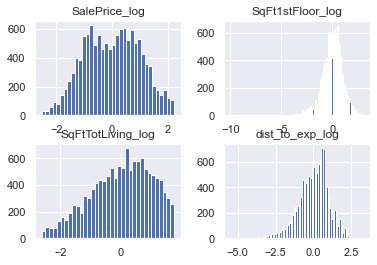

In [770]:
model13, y13 = get_model(continuous8, binary_cols12, categoricals8, zip_cull)
model13.summary()

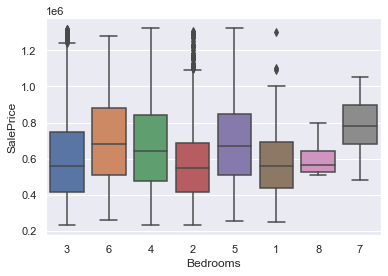

In [782]:
ax2 = sns.boxplot(x='Bedrooms', y="SalePrice", data=zip_cull)

In [775]:
zip_cull[zip_cull['Bedrooms'] == '0']

,id,DocumentDate,SalePrice,Address,BuildingNumber,DirectionPrefix,StreetName,StreetType,DirectionSuffix,ZipCode,Stories,BldgGrade,SqFt1stFloor,SqFtHalfFloor,SqFt2ndFloor,SqFtUpperFloor,SqFtTotLiving,SqFtTotBasement,SqFtGarageBasement,SqFtGarageAttached,DaylightBasement,SqFtOpenPorch,SqFtEnclosedPorch,SqFtDeck,HeatSystem,HeatSource,BrickStone,Bedrooms,BathHalfCount,Bath3qtrCount,BathFullCount,YrBuilt,YrRenovated,Condition,Township,Section,QuarterSection,Area,DistrictName,SqFtLot,Access,StreetSurface,InadequateParking,TrafficNoise,address,location,point,renovation,dist_to_exp,has_basement,has_garage,has_porch,has_deck,WfntLocation,MtRainier,Olympics,Cascades,Territorial,SeattleSkyline,PugetSound,LakeWashington,LakeSammamish,SmallLakeRiverCreek,OtherView,latitude_y,longitude_y,lat_long,duplex,age,age_norm,age_mm,age_mm_log,bathrooms
1179,1428000685,12/30/2019,958000.0,4521 268TH AVE NE 98053,4521,,268TH,avenue,NE,98053,1,7,820.0,0.0,0.0,0.0,820.0,60.0,0.0,0.0,N,0.0,0.0,350.0,elec_bb,3.0,0,0,0.0,0.0,1.0,2000.0,0.0,3,25,13,SW,71,KING COUNTY,44236.0,4.0,1.0,2.0,0.0,"4521 268TH avenue NE, ...","(4521, 268th Avenue Northeast, Union Hill-Nove...","(47.64804853061224, -121.98157828571428, 0.0)",0.0,19.218521,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,47.648049,-121.981578,"(47.64804853061224, -121.98157828571428)",0,19.0,-1.218867,0.159664,-1.834685,1.0
3232,3649100242,07/17/2019,799950.0,77313 NE 155TH ST 98028,77313,NE,155TH,street,,98028,2,8,1160.0,0.0,1150.0,0.0,2310.0,0.0,0.0,620.0,N,0.0,0.0,0.0,forced_air,2.0,0,0,0.0,0.0,0.0,2012.0,0.0,3,26,13,SW,37,KENMORE,5402.0,3.0,1.0,2.0,0.0,"77313 NE 155TH street , ...","(Northeast 155th Street, Kenmore, King County,...","(47.7405296, -122.2263514, 0.0)",0.0,10.006588,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,47.740530,-122.226351,"(47.7405296, -122.2263514)",1,7.0,-1.658265,0.058824,-2.833213,2.0
6683,5141000190,01/07/2019,1050000.0,4951 13TH AVE S 98108,4951,,13TH,avenue,S,98108,1,7,2110.0,0.0,0.0,0.0,2110.0,0.0,0.0,0.0,N,0.0,0.0,0.0,forced_air,2.0,0,0,0.0,0.0,0.0,1916.0,0.0,4,24,20,NE,79,SEATTLE,4550.0,4.0,1.0,2.0,0.0,"4951 13TH avenue S , ...","(4951, 13th Avenue South, South Seattle, Georg...","(47.5577472, -122.316350857267, 0.0)",0.0,7.758365,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,47.557747,-122.316351,"(47.5577472, -122.316350857267)",0,103.0,1.856921,0.865546,-0.144395,2.0
8004,6840700161,03/22/2019,290000.0,702 26TH AVE 98122,702,,26TH,avenue,,98122,1,7,390.0,0.0,0.0,0.0,780.0,390.0,0.0,0.0,N,0.0,0.0,0.0,elec_bb,3.0,0,0,0.0,0.0,1.0,1926.0,0.0,4,25,33,SE,15,SEATTLE,1354.0,4.0,1.0,2.0,1.0,"702 26TH avenue , ...","(702, 26th Avenue, Madison Valley, Seattle, Ki...","(47.608299, -122.2986308, 0.0)",0.0,4.948909,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,47.608299,-122.298631,"(47.608299, -122.2986308)",0,93.0,1.490756,0.781513,-0.246524,1.0


remove 0 bedrooms

In [776]:
zip_cull.QuarterSection.value_counts()

NE    3243
SE    3140
SW    3131
NW    3106
Name: QuarterSection, dtype: int64

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:          SalePrice_log   R-squared:                       0.824
Model:                            OLS   Adj. R-squared:                  0.823
Method:                 Least Squares   F-statistic:                     488.4
Date:                Wed, 03 Mar 2021   Prob (F-statistic):               0.00
Time:                        10:52:30   Log-Likelihood:                -6936.2
No. Observations:               12620   AIC:                         1.411e+04
Df Residuals:                   12499   BIC:                         1.502e+04
Df Model:                         120                                         
Covariance Type:            nonrobust                                         
=========================================================================================
                            coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                    -1.3315      0.189     -7.027      0.000      -1.703      -0.960
SqFt1stFloor_log          0.0798      0.007     11.301      0.000       0.066       0.094
SqFtTotLiving_log         0.2490      0.008     29.440      0.000       0.232       0.266
dist_to_exp_log          -0.1231      0.010    -11.826      0.000      -0.143      -0.103
ZipCode_98002            -0.1678      0.039     -4.284      0.000      -0.245      -0.091
ZipCode_98003             0.0081      0.036      0.225      0.822      -0.063       0.079
ZipCode_98004             2.5023      0.074     33.593      0.000       2.356       2.648
ZipCode_98005             1.8287      0.068     26.970      0.000       1.696       1.962
ZipCode_98006             1.5148      0.043     34.967      0.000       1.430       1.600
ZipCode_98007             1.6650      0.056     29.738      0.000       1.555       1.775
ZipCode_98008             1.7471      0.041     42.577      0.000       1.667       1.828
ZipCode_98010             0.2473      0.078      3.170      0.002       0.094       0.400
ZipCode_98011             1.1651      0.044     26.556      0.000       1.079       1.251
ZipCode_98014             1.2280      0.060     20.320      0.000       1.110       1.346
ZipCode_98019             1.1650      0.053     21.999      0.000       1.061       1.269
ZipCode_98022             0.2035      0.042      4.850      0.000       0.121       0.286
ZipCode_98023            -0.0162      0.033     -0.499      0.618      -0.080       0.048
ZipCode_98024             1.4667      0.078     18.753      0.000       1.313       1.620
ZipCode_98027             1.3718      0.045     30.538      0.000       1.284       1.460
ZipCode_98028             1.1296      0.040     28.196      0.000       1.051       1.208
ZipCode_98029             1.6054      0.045     35.683      0.000       1.517       1.694
ZipCode_98030            -0.0762      0.044     -1.712      0.087      -0.163       0.011
ZipCode_98031            -0.0339      0.041     -0.819      0.413      -0.115       0.047
ZipCode_98032            -0.0583      0.048     -1.208      0.227      -0.153       0.036
ZipCode_98033             1.9727      0.040     49.171      0.000       1.894       2.051
ZipCode_98034             1.4193      0.034     42.063      0.000       1.353       1.485
ZipCode_98038             0.3162      0.034      9.205      0.000       0.249       0.384
ZipCode_98040             2.0647      0.071     28.897      0.000       1.925       2.205
ZipCode_98042            -0.1191      0.039     -3.028      0.002      -0.196      -0.042
ZipCode_98045             1.1219      0.047     24.102      0.000       1.031       1.213
ZipCode_98047            -0.0415      0.085     -0.489      0.625      -0.208       0.125
ZipCode_98051          

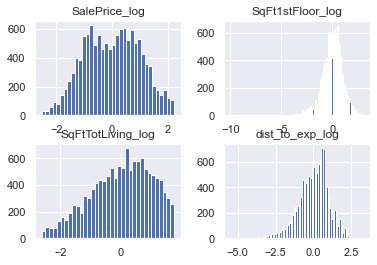

In [786]:
categoricals13 = ['ZipCode', 'HeatSystem', 'Condition', 'BldgGrade', 'Bedrooms', 'QuarterSection']

model13, y13 = get_model(continuous8, binary_cols12, categoricals13, zip_cull)
model13.summary()

In [781]:
zip_cull.loc[zip_cull['Bedrooms']=='0', 'Bedrooms'] = '3'

In [784]:
zip_cull.Bedrooms.value_counts()

3    6426
4    3743
2    1654
5     642
6      75
1      67
7       7
8       6
Name: Bedrooms, dtype: int64

In [787]:
categoricals14 = ['HeatSystem', 'Condition', 'BldgGrade', 'Bedrooms', 'QuarterSection']

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:          SalePrice_log   R-squared:                       0.440
Model:                            OLS   Adj. R-squared:                  0.438
Method:                 Least Squares   F-statistic:                     197.8
Date:                Wed, 03 Mar 2021   Prob (F-statistic):               0.00
Time:                        10:56:10   Log-Likelihood:                -14244.
No. Observations:               12620   AIC:                         2.859e+04
Df Residuals:                   12569   BIC:                         2.897e+04
Df Model:                          50                                         
Covariance Type:            nonrobust                                         
=========================================================================================
                            coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                     0.8815      0.333      2.650      0.008       0.229       1.534
SqFt1stFloor_log         -0.0460      0.012     -3.845      0.000      -0.070      -0.023
SqFtTotLiving_log         0.2534      0.015     16.973      0.000       0.224       0.283
dist_to_exp_log          -0.1110      0.007    -15.702      0.000      -0.125      -0.097
HeatSystem_floor_wall     0.0483      0.045      1.081      0.280      -0.039       0.136
HeatSystem_forced_air     0.0484      0.026      1.832      0.067      -0.003       0.100
HeatSystem_gravity        0.3695      0.134      2.765      0.006       0.108       0.631
HeatSystem_heat_pump      0.1238      0.039      3.208      0.001       0.048       0.200
HeatSystem_hot_water      0.0691      0.055      1.253      0.210      -0.039       0.177
HeatSystem_other          0.7116      0.267      2.663      0.008       0.188       1.235
HeatSystem_radiant        0.3600      0.074      4.843      0.000       0.214       0.506
Condition_2               0.2275      0.316      0.720      0.471      -0.392       0.847
Condition_3               0.4721      0.307      1.538      0.124      -0.130       1.074
Condition_4               0.4641      0.307      1.511      0.131      -0.138       1.066
Condition_5               0.5342      0.307      1.738      0.082      -0.068       1.137
BldgGrade_11             -0.0251      0.768     -0.033      0.974      -1.531       1.481
BldgGrade_4              -2.2377      0.760     -2.946      0.003      -3.727      -0.749
BldgGrade_5              -2.5764      0.107    -24.102      0.000      -2.786      -2.367
BldgGrade_6              -2.1953      0.078    -28.299      0.000      -2.347      -2.043
BldgGrade_7              -1.6265      0.073    -22.263      0.000      -1.770      -1.483
BldgGrade_8              -1.0996      0.072    -15.296      0.000      -1.240      -0.959
BldgGrade_9              -0.5193      0.075     -6.907      0.000      -0.667      -0.372
Bedrooms_2               -0.1493      0.095     -1.578      0.115      -0.335       0.036
Bedrooms_3               -0.3052      0.095     -3.228      0.001      -0.491      -0.120
Bedrooms_4               -0.3481      0.096     -3.625      0.000      -0.536      -0.160
Bedrooms_5               -0.4144      0.101     -4.122      0.000      -0.611      -0.217
Bedrooms_6               -0.5346      0.130     -4.117      0.000      -0.789      -0.280
Bedrooms_7               -0.1622      0.300     -0.541      0.589      -0.750       0.426
Bedrooms_8               -0.0093      0.323     -0.029      0.977      -0.643       0.624
QuarterSection_NW         0.0128      0.019      0.676      0.499      -0.024       0.050
QuarterSection_SE        -0.0200      0.019     -1.061      0.289      -0.057       0.017
QuarterSection_SW      

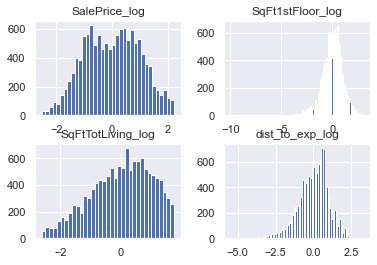

In [788]:
model14, y14 = get_model(continuous8, binary_cols12, categoricals14, zip_cull)
model14.summary()

In [789]:
zip_cull.head()

,id,DocumentDate,SalePrice,Address,BuildingNumber,DirectionPrefix,StreetName,StreetType,DirectionSuffix,ZipCode,Stories,BldgGrade,SqFt1stFloor,SqFtHalfFloor,SqFt2ndFloor,SqFtUpperFloor,SqFtTotLiving,SqFtTotBasement,SqFtGarageBasement,SqFtGarageAttached,DaylightBasement,SqFtOpenPorch,SqFtEnclosedPorch,SqFtDeck,HeatSystem,HeatSource,BrickStone,Bedrooms,BathHalfCount,Bath3qtrCount,BathFullCount,YrBuilt,YrRenovated,Condition,Township,Section,QuarterSection,Area,DistrictName,SqFtLot,Access,StreetSurface,InadequateParking,TrafficNoise,address,location,point,renovation,dist_to_exp,has_basement,has_garage,has_porch,has_deck,WfntLocation,MtRainier,Olympics,Cascades,Territorial,SeattleSkyline,PugetSound,LakeWashington,LakeSammamish,SmallLakeRiverCreek,OtherView,latitude_y,longitude_y,lat_long,duplex,age,age_norm,age_mm,age_mm_log,bathrooms
0,0100500380,12/12/2019,445000.0,2435 S 354TH ST 98003,2435,S,354TH,street,,98003,1,7,1480.0,0.0,0.0,0.0,1480.0,0.0,0.0,440.0,N,80.0,0.0,120.0,forced_air,2.0,0,3,0.0,0.0,2.0,1994.0,0.0,5,21,28,NE,55,KING COUNTY,6446.0,4.0,1.0,2.0,0.0,"2435 S 354TH street , ...","(2435, South 354th Street, Emery Woods, Federa...","(47.28493, -122.30216590825634, 0.0)",0.0,16.340042,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,47.284930,-122.302166,"(47.28493, -122.30216590825634)",0,25.0,-0.999167,0.210084,-1.560248,2.00
1,0100500380,12/12/2019,445000.0,2435 S 354TH ST 98003,2435,S,354TH,street,,98003,1,7,1480.0,0.0,0.0,0.0,1480.0,0.0,0.0,440.0,N,80.0,0.0,120.0,forced_air,2.0,0,3,0.0,0.0,2.0,1994.0,0.0,5,21,28,NE,55,KING COUNTY,6446.0,4.0,1.0,2.0,0.0,"2435 S 354TH street , ...","(2435, South 354th Street, Emery Woods, Federa...","(47.28493, -122.30216590825634, 0.0)",0.0,16.340042,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,47.284930,-122.302166,"(47.28493, -122.30216590825634)",0,25.0,-0.999167,0.210084,-1.560248,2.00
2,0100500380,08/16/2019,311000.0,2435 S 354TH ST 98003,2435,S,354TH,street,,98003,1,7,1480.0,0.0,0.0,0.0,1480.0,0.0,0.0,440.0,N,80.0,0.0,120.0,forced_air,2.0,0,3,0.0,0.0,2.0,1994.0,0.0,5,21,28,NE,55,KING COUNTY,6446.0,4.0,1.0,2.0,0.0,"2435 S 354TH street , ...","(2435, South 354th Street, Emery Woods, Federa...","(47.28493, -122.30216590825634, 0.0)",0.0,16.340042,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,47.284930,-122.302166,"(47.28493, -122.30216590825634)",0,25.0,-0.999167,0.210084,-1.560248,2.00
3,0100500380,08/16/2019,311000.0,2435 S 354TH ST 98003,2435,S,354TH,street,,98003,1,7,1480.0,0.0,0.0,0.0,1480.0,0.0,0.0,440.0,N,80.0,0.0,120.0,forced_air,2.0,0,3,0.0,0.0,2.0,1994.0,0.0,5,21,28,NE,55,KING COUNTY,6446.0,4.0,1.0,2.0,0.0,"2435 S 354TH street , ...","(2435, South 354th Street, Emery Woods, Federa...","(47.28493, -122.30216590825634, 0.0)",0.0,16.340042,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,47.284930,-122.302166,"(47.28493, -122.30216590825634)",0,25.0,-0.999167,0.210084,-1.560248,2.00
4,0188000095,08/30/2019,730000.0,1602 LAKEVIEW BLVD E 98102,1602,,LAKEVIEW,boulevard,E,98102,2,9,660.0,0.0,595.0,0.0,1540.0,380.0,0.0,0.0,Y,0.0,0.0,155.0,floor_wall,3.0,0,3,1.0,1.0,1.0,1984.0,0.0,3,25,20,SE,13,SEATTLE,3117.0,4.0,1.0,0.0,3.0,1602 LAKEVIEW boulevard E...,"(1602, Lakeview Boulevard East, Capitol Hill, ...","(47.6341511, -122.322067, 0.0)",0.0,4.440804,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,47.634151,-122.322067,"(47.6341511, -122.322067)",1,35.0,-0.633002,0.294118,-1.223775,2.25


In [791]:
zip_cull['total_living_norm'] = normalize(zip_cull['SqFtTotLiving'])

<AxesSubplot:>

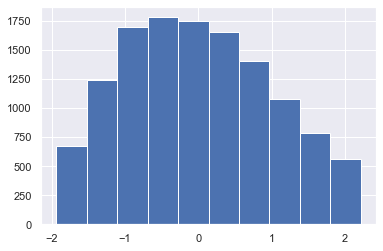

In [792]:
zip_cull['total_living_norm'].hist()

add this into binary_cols so it does not undergo log transformation, remove SqFtTotLiving from continuous

In [795]:
binary_cols15 = ['has_porch',
 'has_basement',
 'has_garage',
 'renovation',
 'has_deck',
 'MtRainier',
 'Olympics',
 'Cascades',
 'Territorial',
 'SeattleSkyline',
 'PugetSound',
 'LakeWashington',
 'LakeSammamish',
 'SmallLakeRiverCreek',
 'OtherView',
 'WfntLocation',
 'duplex',
 'age_norm',
 'bathrooms', 'total_living_norm']

In [797]:
continuous15 = ['SalePrice', 'SqFt1stFloor', 'dist_to_exp']

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:          SalePrice_log   R-squared:                       0.825
Model:                            OLS   Adj. R-squared:                  0.823
Method:                 Least Squares   F-statistic:                     489.8
Date:                Wed, 03 Mar 2021   Prob (F-statistic):               0.00
Time:                        11:25:36   Log-Likelihood:                -6921.0
No. Observations:               12620   AIC:                         1.408e+04
Df Residuals:                   12499   BIC:                         1.498e+04
Df Model:                         120                                         
Covariance Type:            nonrobust                                         
=========================================================================================
                            coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                    -1.4704      0.189     -7.783      0.000      -1.841      -1.100
SqFt1stFloor_log          0.0819      0.007     11.760      0.000       0.068       0.096
dist_to_exp_log          -0.1225      0.010    -11.786      0.000      -0.143      -0.102
ZipCode_98002            -0.1701      0.039     -4.348      0.000      -0.247      -0.093
ZipCode_98003             0.0103      0.036      0.286      0.775      -0.060       0.081
ZipCode_98004             2.5146      0.074     33.798      0.000       2.369       2.660
ZipCode_98005             1.8280      0.068     26.992      0.000       1.695       1.961
ZipCode_98006             1.5102      0.043     34.906      0.000       1.425       1.595
ZipCode_98007             1.6679      0.056     29.826      0.000       1.558       1.777
ZipCode_98008             1.7510      0.041     42.720      0.000       1.671       1.831
ZipCode_98010             0.2456      0.078      3.152      0.002       0.093       0.398
ZipCode_98011             1.1617      0.044     26.510      0.000       1.076       1.248
ZipCode_98014             1.2258      0.060     20.307      0.000       1.107       1.344
ZipCode_98019             1.1596      0.053     21.922      0.000       1.056       1.263
ZipCode_98022             0.2059      0.042      4.913      0.000       0.124       0.288
ZipCode_98023            -0.0210      0.032     -0.646      0.518      -0.085       0.043
ZipCode_98024             1.4675      0.078     18.786      0.000       1.314       1.621
ZipCode_98027             1.3669      0.045     30.466      0.000       1.279       1.455
ZipCode_98028             1.1271      0.040     28.165      0.000       1.049       1.206
ZipCode_98029             1.6180      0.045     36.002      0.000       1.530       1.706
ZipCode_98030            -0.0754      0.044     -1.698      0.090      -0.163       0.012
ZipCode_98031            -0.0352      0.041     -0.851      0.395      -0.116       0.046
ZipCode_98032            -0.0601      0.048     -1.247      0.213      -0.155       0.034
ZipCode_98033             1.9763      0.040     49.322      0.000       1.898       2.055
ZipCode_98034             1.4160      0.034     42.017      0.000       1.350       1.482
ZipCode_98038             0.3195      0.034      9.313      0.000       0.252       0.387
ZipCode_98040             2.0659      0.071     28.948      0.000       1.926       2.206
ZipCode_98042            -0.1260      0.039     -3.207      0.001      -0.203      -0.049
ZipCode_98045             1.1178      0.046     24.043      0.000       1.027       1.209
ZipCode_98047            -0.0469      0.085     -0.554      0.580      -0.213       0.119
ZipCode_98051             0.7944      0.085      9.360      0.000       0.628       0.961
ZipCode_98052          

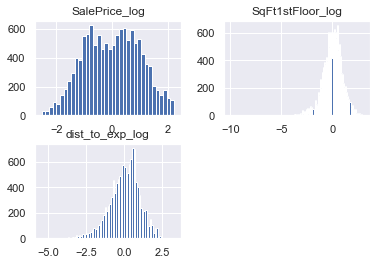

In [801]:
model15, y15 = get_model(continuous15, binary_cols15, categoricals15, zip_cull)
model15.summary()

In [800]:
categoricals15 = ['ZipCode','HeatSystem', 'Condition', 'BldgGrade', 'Bedrooms', 'QuarterSection']

In [802]:
get_multicol(zip_cull)

,cc
pairs,
"(age_norm, age)",1.000000
"(YrBuilt, age_norm)",1.000000
"(age_mm, age_norm)",1.000000
"(renovation, YrRenovated)",0.999955
"(duplex, SqFt2ndFloor)",0.929539
"(has_basement, SqFtTotBasement)",0.895132
"(age_mm_log, age_norm)",0.879160
"(age, age_mm_log)",0.879160
"(age_mm, age_mm_log)",0.879160


<AxesSubplot:>

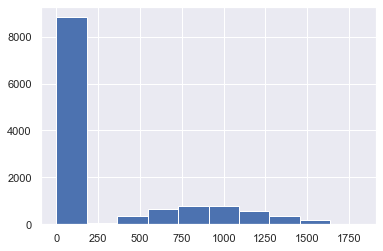

In [803]:
zip_cull.SqFt2ndFloor.hist()

In [805]:
import statsmodels.api as sm

def stepwise_selection(X, y, 
                       initial_list=[], 
                       threshold_in=0.01, 
                       threshold_out = 0.05, 
                       verbose=True):
    """ 
    Perform a forward-backward feature selection 
    based on p-value from statsmodels.api.OLS
    Arguments:
        X - pandas.DataFrame with candidate features
        y - list-like with the target
        initial_list - list of features to start with (column names of X)
        threshold_in - include a feature if its p-value < threshold_in
        threshold_out - exclude a feature if its p-value > threshold_out
        verbose - whether to print the sequence of inclusions and exclusions
    Returns: list of selected features 
    Always set threshold_in < threshold_out to avoid infinite looping.
    See https://en.wikipedia.org/wiki/Stepwise_regression for the details
    """
    included = list(initial_list)
    while True:
        changed=False
        # forward step
        excluded = list(set(X.columns)-set(included))
        new_pval = pd.Series(index=excluded)
        for new_column in excluded:
            model = sm.OLS(y, sm.add_constant(pd.DataFrame(X[included+[new_column]]))).fit()
            new_pval[new_column] = model.pvalues[new_column]
        best_pval = new_pval.min()
        if best_pval < threshold_in:
            best_feature = new_pval.idxmin()
            included.append(best_feature)
            changed=True
            if verbose:
                print('Add  {:30} with p-value {:.6}'.format(best_feature, best_pval))

        # backward step
        model = sm.OLS(y, sm.add_constant(pd.DataFrame(X[included]))).fit()
        # use all coefs except intercept
        pvalues = model.pvalues.iloc[1:]
        worst_pval = pvalues.max() # null if pvalues is empty
        if worst_pval > threshold_out:
            changed=True
            worst_feature = pvalues.idxmax()
            included.remove(worst_feature)
            if verbose:
                print('Drop {:30} with p-value {:.6}'.format(worst_feature, worst_pval))
        if not changed:
            break
    return included

<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  total_living_norm              with p-value 0.0


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98023                  with p-value 1.62863e-169


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  has_basement                   with p-value 6.73368e-156


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98042                  with p-value 2.23914e-109


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  dist_to_exp_log                with p-value 3.21898e-120


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98031                  with p-value 2.30287e-136


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98030                  with p-value 3.01644e-126


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98058                  with p-value 7.44293e-113


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98002                  with p-value 3.61476e-123


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98038                  with p-value 7.35983e-112


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98092                  with p-value 4.62197e-126


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98003                  with p-value 5.02638e-121


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98168                  with p-value 3.61277e-111


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98198                  with p-value 1.06328e-98


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98178                  with p-value 9.55072e-104


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98032                  with p-value 4.06035e-105


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98055                  with p-value 4.21694e-110


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98056                  with p-value 7.09345e-102


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  BldgGrade_9                    with p-value 1.57104e-80


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  BldgGrade_8                    with p-value 9.65614e-129


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98022                  with p-value 5.8168e-68


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98059                  with p-value 7.13679e-68


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98188                  with p-value 2.79193e-72


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98118                  with p-value 6.36207e-72


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  Territorial                    with p-value 2.35845e-52


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98146                  with p-value 6.6746e-51


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  BldgGrade_6                    with p-value 2.80245e-45


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  age_norm                       with p-value 1.33163e-61
Drop has_basement                   with p-value 0.125406


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98052                  with p-value 6.34772e-42


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98108                  with p-value 3.54301e-37


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98033                  with p-value 1.87768e-34


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98116                  with p-value 6.72999e-35


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  WfntLocation                   with p-value 1.04728e-34


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98117                  with p-value 3.62869e-33


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98199                  with p-value 3.65964e-33


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98047                  with p-value 6.15365e-32


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98010                  with p-value 3.80122e-30


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98053                  with p-value 6.35589e-25


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98103                  with p-value 4.10433e-24


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98107                  with p-value 1.89562e-25


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98004                  with p-value 1.02522e-25


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98074                  with p-value 2.37604e-25


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98029                  with p-value 1.46401e-26


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98008                  with p-value 6.35232e-28


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98119                  with p-value 3.18108e-27


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98136                  with p-value 2.90013e-24


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98075                  with p-value 1.95857e-22


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  BldgGrade_5                    with p-value 2.61237e-22


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  BldgGrade_7                    with p-value 6.24802e-58


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  Condition_3                    with p-value 2.33435e-24


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98112                  with p-value 7.28416e-21


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98109                  with p-value 1.60056e-20


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  Condition_2                    with p-value 1.77361e-19


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98148                  with p-value 5.44549e-18


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98122                  with p-value 1.46593e-15


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  has_porch                      with p-value 3.9977e-14


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98102                  with p-value 5.5046e-13


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98115                  with p-value 4.67745e-12


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98040                  with p-value 3.44295e-14


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98034                  with p-value 2.71995e-15


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98126                  with p-value 1.50372e-14


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98177                  with p-value 7.83679e-16


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98144                  with p-value 2.53172e-17


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98007                  with p-value 1.07118e-15


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98105                  with p-value 7.9178e-18


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98006                  with p-value 9.35299e-24


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98005                  with p-value 9.2226e-27
Drop ZipCode_98118                  with p-value 0.218508


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98125                  with p-value 2.34004e-32
Drop ZipCode_98108                  with p-value 0.124087


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98027                  with p-value 2.38573e-18


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98072                  with p-value 1.04862e-15


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98133                  with p-value 1.5885e-17


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98077                  with p-value 1.58725e-14


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98155                  with p-value 1.31887e-14


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  bathrooms                      with p-value 6.20435e-14


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  SqFt1stFloor_log               with p-value 2.79611e-14


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98118                  with p-value 2.16711e-14
Drop ZipCode_98146                  with p-value 0.0667412


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98028                  with p-value 2.52732e-18
Drop ZipCode_98056                  with p-value 0.150811


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98106                  with p-value 2.33197e-21
Drop ZipCode_98059                  with p-value 0.816048


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98011                  with p-value 4.29628e-23


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98065                  with p-value 1.20269e-17


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98024                  with p-value 5.57398e-16


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98019                  with p-value 2.76626e-15


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98045                  with p-value 7.32879e-19
Drop ZipCode_98148                  with p-value 0.0501485


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98070                  with p-value 6.62288e-22


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98014                  with p-value 5.22211e-26


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98166                  with p-value 9.07402e-26


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98108                  with p-value 1.46437e-23


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98146                  with p-value 3.48379e-32
Drop ZipCode_98178                  with p-value 0.621247


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98059                  with p-value 1.31038e-30
Drop ZipCode_98168                  with p-value 0.895957


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98056                  with p-value 4.95254e-30
Drop ZipCode_98010                  with p-value 0.992939


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  LakeWashington                 with p-value 8.19181e-13
Drop ZipCode_98022                  with p-value 0.777131


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  PugetSound                     with p-value 8.45015e-16
Drop ZipCode_98058                  with p-value 0.326523


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98051                  with p-value 1.45832e-11
Drop ZipCode_98198                  with p-value 0.114526


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  MtRainier                      with p-value 3.90281e-10


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  duplex                         with p-value 8.81774e-10


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  Condition_5                    with p-value 4.1961e-09


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98178                  with p-value 3.95131e-08


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98148                  with p-value 1.87168e-08


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98168                  with p-value 1.24294e-08


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98058                  with p-value 6.45141e-11


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  Bedrooms_6                     with p-value 2.25833e-08
Drop ZipCode_98047                  with p-value 0.0501418


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  HeatSystem_forced_air          with p-value 8.70717e-07


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  HeatSystem_heat_pump           with p-value 3.28574e-15


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  renovation                     with p-value 2.83284e-06


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  Condition_4                    with p-value 4.74974e-06


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  Bedrooms_5                     with p-value 4.99805e-06


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  Bedrooms_2                     with p-value 1.27411e-05


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98198                  with p-value 7.01139e-05
Drop ZipCode_98092                  with p-value 0.128691


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98022                  with p-value 1.23955e-06
Drop ZipCode_98003                  with p-value 0.828991


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  SeattleSkyline                 with p-value 0.000152738
Drop ZipCode_98023                  with p-value 0.19989


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  HeatSystem_gravity             with p-value 0.000235363
Drop ZipCode_98031                  with p-value 0.163574


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Add  ZipCode_98010                  with p-value 0.000697832
Drop ZipCode_98032                  with p-value 0.252617


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


Drop ZipCode_98030                  with p-value 0.0933772


<ipython-input-805-470561526870>:27: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  new_pval = pd.Series(index=excluded)


resulting features:
['total_living_norm', 'ZipCode_98042', 'dist_to_exp_log', 'ZipCode_98002', 'ZipCode_98038', 'ZipCode_98055', 'BldgGrade_9', 'BldgGrade_8', 'ZipCode_98188', 'Territorial', 'BldgGrade_6', 'age_norm', 'ZipCode_98052', 'ZipCode_98033', 'ZipCode_98116', 'WfntLocation', 'ZipCode_98117', 'ZipCode_98199', 'ZipCode_98053', 'ZipCode_98103', 'ZipCode_98107', 'ZipCode_98004', 'ZipCode_98074', 'ZipCode_98029', 'ZipCode_98008', 'ZipCode_98119', 'ZipCode_98136', 'ZipCode_98075', 'BldgGrade_5', 'BldgGrade_7', 'Condition_3', 'ZipCode_98112', 'ZipCode_98109', 'Condition_2', 'ZipCode_98122', 'has_porch', 'ZipCode_98102', 'ZipCode_98115', 'ZipCode_98040', 'ZipCode_98034', 'ZipCode_98126', 'ZipCode_98177', 'ZipCode_98144', 'ZipCode_98007', 'ZipCode_98105', 'ZipCode_98006', 'ZipCode_98005', 'ZipCode_98125', 'ZipCode_98027', 'ZipCode_98072', 'ZipCode_98133', 'ZipCode_98077', 'ZipCode_98155', 'bathrooms', 'SqFt1stFloor_log', 'ZipCode_98118', 'ZipCode_98028', 'ZipCode_98106', 'ZipCode_98011

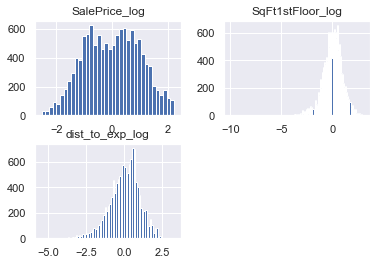

In [807]:
model16, X16, y16 = get_model(continuous15, binary_cols15, categoricals15, zip_cull)



# Your code here
result = stepwise_selection(X16, y16, verbose=True)
print('resulting features:')
print(result)

In [809]:
features_to_keep = ['total_living_norm', 'ZipCode_98042', 'dist_to_exp_log', 'ZipCode_98002', 'ZipCode_98038',\
                    'ZipCode_98055', 'BldgGrade_9', 'BldgGrade_8', 'ZipCode_98188', 'Territorial', 'BldgGrade_6',\
                    'age_norm', 'ZipCode_98052', 'ZipCode_98033', 'ZipCode_98116', 'WfntLocation', 'ZipCode_98117',\
                    'ZipCode_98199', 'ZipCode_98053', 'ZipCode_98103', 'ZipCode_98107', 'ZipCode_98004', 'ZipCode_98074',\
                    'ZipCode_98029', 'ZipCode_98008', 'ZipCode_98119', 'ZipCode_98136', 'ZipCode_98075', 'BldgGrade_5',\
                    'BldgGrade_7', 'Condition_3', 'ZipCode_98112', 'ZipCode_98109', 'Condition_2', 'ZipCode_98122',\
                    'has_porch', 'ZipCode_98102', 'ZipCode_98115', 'ZipCode_98040', 'ZipCode_98034', 'ZipCode_98126', \
                    'ZipCode_98177', 'ZipCode_98144', 'ZipCode_98007', 'ZipCode_98105', 'ZipCode_98006', 'ZipCode_98005',\
                    'ZipCode_98125', 'ZipCode_98027', 'ZipCode_98072', 'ZipCode_98133', 'ZipCode_98077', 'ZipCode_98155',\
                    'bathrooms', 'SqFt1stFloor_log', 'ZipCode_98118', 'ZipCode_98028', 'ZipCode_98106', 'ZipCode_98011',\
                    'ZipCode_98065', 'ZipCode_98024', 'ZipCode_98019', 'ZipCode_98045', 'ZipCode_98070', 'ZipCode_98014',\
                    'ZipCode_98166', 'ZipCode_98108', 'ZipCode_98146', 'ZipCode_98059', 'ZipCode_98056', 'LakeWashington',\
                    'PugetSound', 'ZipCode_98051', 'MtRainier', 'duplex', 'Condition_5', 'ZipCode_98178', 'ZipCode_98148',\
                    'ZipCode_98168', 'ZipCode_98058', 'Bedrooms_6', 'HeatSystem_forced_air', 'HeatSystem_heat_pump',\
                    'renovation', 'Condition_4', 'Bedrooms_5', 'Bedrooms_2', 'ZipCode_98198', 'ZipCode_98022', \
                    'SeattleSkyline', 'HeatSystem_gravity', 'ZipCode_98010']

In [808]:
def get_stepwise_model(cont, binary, cat, df, features):
    
    ''' takes in list of continuous features (cont)
        list of binary features (binary) a list of categorical features (cat)
        and a dataframe, it returns a linear regression model using sm.OLS'''
    for col in cat:
        df[col] = df[col].astype(str)
    
    kc_cont = df[cont]
    log_names = [f'{column}_log' for column in kc_cont.columns]
    kc_log = np.log(kc_cont)
    kc_log.columns = log_names
    kc_log_norm = kc_log.apply(normalize)
    
    kc_bin = df[binary]
    
    kc_ohe = pd.get_dummies(df[cat], prefix=cat, drop_first=True)
    
    kc_log_norm.hist(bins='auto')
    
    preprocessed = pd.concat([kc_log_norm, kc_ohe, kc_bin], axis=1)
    X = preprocessed.drop('SalePrice_log', axis=1)
    X = X[features]
    y = preprocessed['SalePrice_log']
    
    predictors_int = sm.add_constant(X)
    
    model = sm.OLS(y,predictors_int).fit()
    
    return model, X, y

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:          SalePrice_log   R-squared:                       0.824
Model:                            OLS   Adj. R-squared:                  0.823
Method:                 Least Squares   F-statistic:                     637.2
Date:                Wed, 03 Mar 2021   Prob (F-statistic):               0.00
Time:                        11:56:35   Log-Likelihood:                -6947.0
No. Observations:               12620   AIC:                         1.408e+04
Df Residuals:                   12527   BIC:                         1.477e+04
Df Model:                          92                                         
Covariance Type:            nonrobust                                         
=========================================================================================
                            coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                    -1.5222      0.179     -8.502      0.000      -1.873      -1.171
total_living_norm         0.2489      0.007     35.394      0.000       0.235       0.263
ZipCode_98042            -0.0928      0.026     -3.523      0.000      -0.144      -0.041
dist_to_exp_log          -0.1136      0.007    -15.803      0.000      -0.128      -0.100
ZipCode_98002            -0.1585      0.032     -4.934      0.000      -0.221      -0.096
ZipCode_98038             0.3406      0.025     13.380      0.000       0.291       0.391
ZipCode_98055             0.3700      0.034     10.812      0.000       0.303       0.437
BldgGrade_9              -0.1833      0.042     -4.316      0.000      -0.267      -0.100
BldgGrade_8              -0.4432      0.041    -10.767      0.000      -0.524      -0.363
ZipCode_98188             0.3908      0.041      9.622      0.000       0.311       0.470
Territorial               0.1077      0.019      5.735      0.000       0.071       0.145
BldgGrade_6              -0.8243      0.045    -18.255      0.000      -0.913      -0.736
age_norm                  0.0406      0.006      6.273      0.000       0.028       0.053
ZipCode_98052             1.8466      0.027     67.374      0.000       1.793       1.900
ZipCode_98033             2.0013      0.032     62.022      0.000       1.938       2.065
ZipCode_98116             1.9205      0.033     58.176      0.000       1.856       1.985
WfntLocation              0.8021      0.046     17.354      0.000       0.712       0.893
ZipCode_98117             1.9175      0.026     72.543      0.000       1.866       1.969
ZipCode_98199             2.0339      0.037     54.560      0.000       1.961       2.107
ZipCode_98053             1.6817      0.040     41.947      0.000       1.603       1.760
ZipCode_98103             1.9627      0.029     67.004      0.000       1.905       2.020
ZipCode_98107             2.0032      0.038     52.784      0.000       1.929       2.078
ZipCode_98004             2.5532      0.068     37.361      0.000       2.419       2.687
ZipCode_98074             1.5727      0.034     46.278      0.000       1.506       1.639
ZipCode_98029             1.6245      0.039     41.457      0.000       1.548       1.701
ZipCode_98008             1.7805      0.033     53.264      0.000       1.715       1.846
ZipCode_98119             2.1093      0.048     43.644      0.000       2.015       2.204
ZipCode_98136             1.6988      0.038     45.011      0.000       1.625       1.773
ZipCode_98075             1.5973      0.045     35.129      0.000       1.508       1.686
BldgGrade_5              -0.9810      0.062    -15.887      0.000      -1.102      -0.860
BldgGrade_7              -0.6427      0.042    -15.198      0.000      -0.726      -0.560
Condition_3            

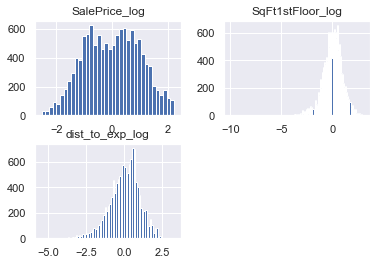

In [810]:
model17, X17, y17 = get_stepwise_model(continuous15, binary_cols15, categoricals15, zip_cull, features_to_keep)
model17.summary()

In [811]:
features_to_keep.sort()

In [812]:
features_to_keep

['Bedrooms_2',
 'Bedrooms_5',
 'Bedrooms_6',
 'BldgGrade_5',
 'BldgGrade_6',
 'BldgGrade_7',
 'BldgGrade_8',
 'BldgGrade_9',
 'Condition_2',
 'Condition_3',
 'Condition_4',
 'Condition_5',
 'HeatSystem_forced_air',
 'HeatSystem_gravity',
 'HeatSystem_heat_pump',
 'LakeWashington',
 'MtRainier',
 'PugetSound',
 'SeattleSkyline',
 'SqFt1stFloor_log',
 'Territorial',
 'WfntLocation',
 'ZipCode_98002',
 'ZipCode_98004',
 'ZipCode_98005',
 'ZipCode_98006',
 'ZipCode_98007',
 'ZipCode_98008',
 'ZipCode_98010',
 'ZipCode_98011',
 'ZipCode_98014',
 'ZipCode_98019',
 'ZipCode_98022',
 'ZipCode_98024',
 'ZipCode_98027',
 'ZipCode_98028',
 'ZipCode_98029',
 'ZipCode_98033',
 'ZipCode_98034',
 'ZipCode_98038',
 'ZipCode_98040',
 'ZipCode_98042',
 'ZipCode_98045',
 'ZipCode_98051',
 'ZipCode_98052',
 'ZipCode_98053',
 'ZipCode_98055',
 'ZipCode_98056',
 'ZipCode_98058',
 'ZipCode_98059',
 'ZipCode_98065',
 'ZipCode_98070',
 'ZipCode_98072',
 'ZipCode_98074',
 'ZipCode_98075',
 'ZipCode_98077',
 'Zi

Dropping more than one dummy variable makes interpretation of the final results not possible. I will reinstate these. 

In [813]:
rainbow_statistic, rainbow_p_value = linear_rainbow(model15)
print("Rainbow statistic:", rainbow_statistic)
print("Rainbow p-value:", rainbow_p_value)

Rainbow statistic: 1.0526742301639702
Rainbow p-value: 0.021244513748768803


In [822]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

rows = zip_cull[['has_porch', 'has_basement', 'has_garage', 'renovation', 'has_deck', 'MtRainier', 'Olympics', 'Cascades',\
                  'Territorial', 'SeattleSkyline', 'PugetSound', 'LakeWashington', 'LakeSammamish', 'SmallLakeRiverCreek',\
                  'OtherView', 'WfntLocation', 'duplex', 'age_norm', 'bathrooms', 'total_living_norm', \
                 'SqFt1stFloor', 'dist_to_exp']].values

vif_df = pd.DataFrame()
vif_df["VIF"] = [variance_inflation_factor(rows, i) for i in range(22)]
vif_df["feature"] = ['has_porch', 'has_basement', 'has_garage', 'renovation', 'has_deck', 'MtRainier', 'Olympics', 'Cascades',\
                  'Territorial', 'SeattleSkyline', 'PugetSound', 'LakeWashington', 'LakeSammamish', 'SmallLakeRiverCreek',\
                  'OtherView', 'WfntLocation', 'duplex', 'age_norm', 'bathrooms', 'total_living_norm',\
                 'SqFt1stFloor', 'dist_to_exp']

vif_df

,VIF,feature
0,1.991538,has_porch
1,3.097680,has_basement
2,4.189992,has_garage
3,1.152070,renovation
4,2.261546,has_deck
5,1.137326,MtRainier
6,1.589566,Olympics
7,1.502691,Cascades
8,2.207888,Territorial
9,1.071533,SeattleSkyline


In [814]:
binary_cols15

['has_porch',
 'has_basement',
 'has_garage',
 'renovation',
 'has_deck',
 'MtRainier',
 'Olympics',
 'Cascades',
 'Territorial',
 'SeattleSkyline',
 'PugetSound',
 'LakeWashington',
 'LakeSammamish',
 'SmallLakeRiverCreek',
 'OtherView',
 'WfntLocation',
 'duplex',
 'age_norm',
 'bathrooms',
 'total_living_norm']

In [817]:
continuous15

['SalePrice', 'SqFt1stFloor', 'dist_to_exp']

going to add a bedroom to bathroom ratio feature and then going to remove one features with high VIF

In [823]:
zip_cull['bedbath'] = zip_cull['bathrooms'] / zip_cull['Bedrooms'].astype(int) 

<AxesSubplot:>

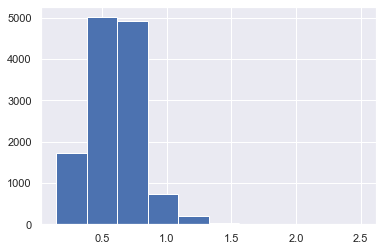

In [824]:
zip_cull['bedbath'].hist()

<AxesSubplot:>

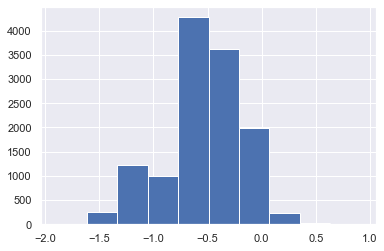

In [827]:
np.log(zip_cull['bedbath']).hist()

In [832]:
continuous17 = ['SalePrice', 'SqFt1stFloor', 'dist_to_exp', 'bedbath']

In [829]:
binary_cols15

['has_porch',
 'has_basement',
 'has_garage',
 'renovation',
 'has_deck',
 'MtRainier',
 'Olympics',
 'Cascades',
 'Territorial',
 'SeattleSkyline',
 'PugetSound',
 'LakeWashington',
 'LakeSammamish',
 'SmallLakeRiverCreek',
 'OtherView',
 'WfntLocation',
 'duplex',
 'age_norm',
 'bathrooms',
 'total_living_norm']

In [830]:
categoricals15

['ZipCode',
 'HeatSystem',
 'Condition',
 'BldgGrade',
 'Bedrooms',
 'QuarterSection']

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:          SalePrice_log   R-squared:                       0.825
Model:                            OLS   Adj. R-squared:                  0.823
Method:                 Least Squares   F-statistic:                     485.9
Date:                Wed, 03 Mar 2021   Prob (F-statistic):               0.00
Time:                        14:25:27   Log-Likelihood:                -6919.8
No. Observations:               12620   AIC:                         1.408e+04
Df Residuals:                   12498   BIC:                         1.499e+04
Df Model:                         121                                         
Covariance Type:            nonrobust                                         
=========================================================================================
                            coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                    -1.4678      0.189     -7.769      0.000      -1.838      -1.097
SqFt1stFloor_log          0.0819      0.007     11.748      0.000       0.068       0.096
dist_to_exp_log          -0.1225      0.010    -11.789      0.000      -0.143      -0.102
bedbath_log               0.0324      0.020      1.588      0.112      -0.008       0.072
ZipCode_98002            -0.1690      0.039     -4.321      0.000      -0.246      -0.092
ZipCode_98003             0.0101      0.036      0.279      0.780      -0.061       0.081
ZipCode_98004             2.5135      0.074     33.784      0.000       2.368       2.659
ZipCode_98005             1.8272      0.068     26.981      0.000       1.694       1.960
ZipCode_98006             1.5102      0.043     34.907      0.000       1.425       1.595
ZipCode_98007             1.6674      0.056     29.819      0.000       1.558       1.777
ZipCode_98008             1.7503      0.041     42.705      0.000       1.670       1.831
ZipCode_98010             0.2453      0.078      3.148      0.002       0.093       0.398
ZipCode_98011             1.1617      0.044     26.511      0.000       1.076       1.248
ZipCode_98014             1.2258      0.060     20.309      0.000       1.107       1.344
ZipCode_98019             1.1602      0.053     21.934      0.000       1.056       1.264
ZipCode_98022             0.2061      0.042      4.917      0.000       0.124       0.288
ZipCode_98023            -0.0212      0.032     -0.654      0.513      -0.085       0.042
ZipCode_98024             1.4672      0.078     18.783      0.000       1.314       1.620
ZipCode_98027             1.3672      0.045     30.475      0.000       1.279       1.455
ZipCode_98028             1.1266      0.040     28.156      0.000       1.048       1.205
ZipCode_98029             1.6178      0.045     36.001      0.000       1.530       1.706
ZipCode_98030            -0.0749      0.044     -1.687      0.092      -0.162       0.012
ZipCode_98031            -0.0353      0.041     -0.853      0.393      -0.116       0.046
ZipCode_98032            -0.0594      0.048     -1.231      0.218      -0.154       0.035
ZipCode_98033             1.9753      0.040     49.293      0.000       1.897       2.054
ZipCode_98034             1.4155      0.034     42.006      0.000       1.349       1.482
ZipCode_98038             0.3190      0.034      9.299      0.000       0.252       0.386
ZipCode_98040             2.0649      0.071     28.935      0.000       1.925       2.205
ZipCode_98042            -0.1256      0.039     -3.198      0.001      -0.203      -0.049
ZipCode_98045             1.1179      0.046     24.048      0.000       1.027       1.209
ZipCode_98047            -0.0461      0.085     -0.544      0.586      -0.212       0.120
ZipCode_98051          

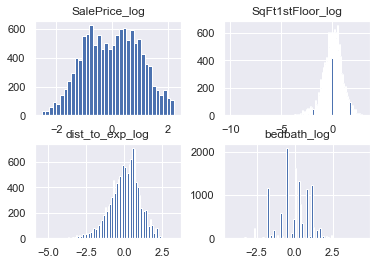

In [833]:
model17, X17, y17 = get_model(continuous17, binary_cols15, categoricals15, zip_cull)
model17.summary()

In [845]:
np.log(zip_cull.SqFt1stFloor).min()

3.912023005428146

In [843]:
np.log(-3.15)

<ipython-input-843-0ff5285534cb>:1: RuntimeWarning: invalid value encountered in log
  np.log(-3.15)


nan

<AxesSubplot:>

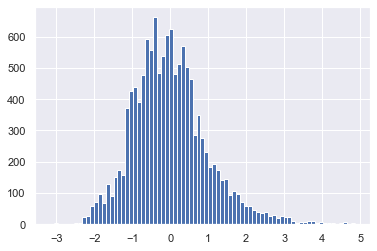

In [849]:
normalize(zip_cull.SqFt1stFloor).hist(bins='auto')

<AxesSubplot:>

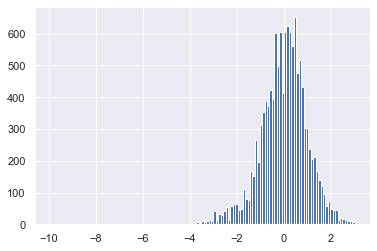

In [848]:
normalize(np.log(zip_cull.SqFt1stFloor)).hist(bins='auto')

there is a tail to the 

<AxesSubplot:>

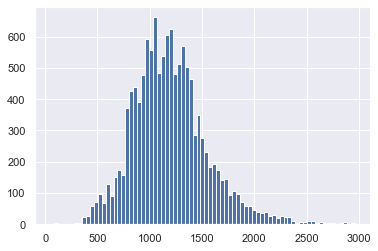

In [850]:
zip_cull.SqFt1stFloor.hist(bins='auto')

In [853]:
zip_cull[zip_cull['SqFt1stFloor']>zip_cull['SqFtTotLiving']]

,id,DocumentDate,SalePrice,Address,BuildingNumber,DirectionPrefix,StreetName,StreetType,DirectionSuffix,ZipCode,Stories,BldgGrade,SqFt1stFloor,SqFtHalfFloor,SqFt2ndFloor,SqFtUpperFloor,SqFtTotLiving,SqFtTotBasement,SqFtGarageBasement,SqFtGarageAttached,DaylightBasement,SqFtOpenPorch,SqFtEnclosedPorch,SqFtDeck,HeatSystem,HeatSource,BrickStone,Bedrooms,BathHalfCount,Bath3qtrCount,BathFullCount,YrBuilt,YrRenovated,Condition,Township,Section,QuarterSection,Area,DistrictName,SqFtLot,Access,StreetSurface,InadequateParking,TrafficNoise,address,location,point,renovation,dist_to_exp,has_basement,has_garage,has_porch,has_deck,WfntLocation,MtRainier,Olympics,Cascades,Territorial,SeattleSkyline,PugetSound,LakeWashington,LakeSammamish,SmallLakeRiverCreek,OtherView,latitude_y,longitude_y,lat_long,duplex,age,age_norm,age_mm,age_mm_log,bathrooms,total_living_norm,bedbath
845,1471620380,08/22/2019,440500.0,44411 SE 142ND ST 98045,44411,SE,142ND,street,,98045,1,7,1390.0,0.0,0.0,0.0,1250.0,0.0,0.0,0.0,N,0.0,0.0,540.0,forced_air,2.0,0,3,1.0,0.0,1.0,1982.0,0.0,4,23,14,SE,80,KING COUNTY,15012.0,4.0,1.0,2.0,3.0,"44411 SE 142ND street , ...","(44411, Southeast 142nd Street, Riverbend, Kin...","(47.47274047994216, -121.7464356218814, 0.0)",0.0,31.381590,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,47.472740,-121.746436,"(47.47274047994216, -121.7464356218814)",0,37.0,-0.559769,0.310924,-1.168206,1.50,-0.987385,0.500000
3061,1615900050,03/07/2019,325000.0,718 MARION ST 98030,718,,MARION,street,,98030,1,7,1280.0,0.0,0.0,0.0,980.0,0.0,0.0,530.0,N,0.0,120.0,0.0,forced_air,1.0,0,2,0.0,0.0,1.0,1958.0,0.0,4,22,19,SW,61,KENT,14859.0,4.0,1.0,0.0,0.0,"718 MARION street , ...","(718, Marion Street, Kent, King County, Washin...","(47.373216299999996, -122.22485281950672, 0.0)",0.0,6.312225,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,47.373216,-122.224853,"(47.373216299999996, -122.22485281950672)",0,61.0,0.319027,0.512605,-0.668250,1.00,-1.479541,0.500000
4985,3886903150,07/24/2019,980000.0,663 11TH AVE 98033,663,,11TH,avenue,,98033,2,8,2350.0,0.0,1060.0,0.0,2060.0,0.0,0.0,0.0,N,0.0,0.0,0.0,hot_water,2.0,0,3,0.0,0.0,2.0,1983.0,1998.0,3,25,5,NE,74,KIRKLAND,7200.0,4.0,1.0,2.0,0.0,"663 11TH avenue , ...","(663, 11th Avenue, Kirkland, King County, Wash...","(47.68377635, -122.19433290097041, 0.0)",1.0,6.615344,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,47.683776,-122.194333,"(47.68377635, -122.19433290097041)",1,36.0,-0.596386,0.302521,-1.195605,2.00,0.489082,0.666667
6058,3339901110,07/30/2019,450000.0,1215 M ST NE 98002,1215,,M,street,NE,98002,1,7,2430.0,0.0,0.0,0.0,2010.0,0.0,0.0,0.0,N,90.0,0.0,0.0,forced_air,2.0,0,4,0.0,1.0,1.0,1953.0,0.0,5,21,7,SE,28,AUBURN,14400.0,4.0,1.0,2.0,0.0,"1215 M street NE, ...","(1215, M Street Northeast, Rivers Bend, Auburn...","(47.3192339, -122.21383558075175, 0.0)",0.0,9.021382,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,47.319234,-122.213836,"(47.3192339, -122.21383558075175)",0,66.0,0.502110,0.554622,-0.589469,1.75,0.397942,0.437500
7012,7116500745,11/22/2019,319000.0,815 7TH ST SE 98002,815,,7TH,street,SE,98002,1,5,1550.0,0.0,0.0,0.0,1330.0,820.0,0.0,0.0,N,40.0,0.0,140.0,forced_air,1.0,0,3,0.0,0.0,1.0,1947.0,0.0,4,21,18,SE,28,AUBURN,7828.0,4.0,1.0,2.0,0.0,"815 7TH street SE, ...","(815, 7th Street Southeast, South Auburn, Aubu...","(47.3018552, -122.21791837427341, 0.0)",0.0,10.796664,1.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,47.301855,-122.217918,"(47.3018552, -122.21791837427341)",0,72.0,0.721809,0.605042,-0.502457,1.00,-0.841562,0.333333
7151,3521059110,07/26/2019,650000.0,15706 SE 376TH ST 98092,15706,SE,376TH,street,,98092,1,9,2330.0,0.0,0.0,0.0,2160.0,0.0,0.0,870.0,N,180.0,0.0,230.0,heat_pump,3.0,0,3,0.0,1.0,1.0,1987.0,0.0,3,21,35,NE,28,KING COUNTY,207781.0,4.0,1.0,2.0,0.0,"15706 SE 376TH street , ...","(15706, Southeast 376th Street, Muckleshoot, A...","(47.2662685, -122.13215601785714, 0.0)",0.0,13.170199,0.0,1.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0

In [856]:
zip_cull[zip_cull['SqFt1stFloor']> 2500]

,id,DocumentDate,SalePrice,Address,BuildingNumber,DirectionPrefix,StreetName,StreetType,DirectionSuffix,ZipCode,Stories,BldgGrade,SqFt1stFloor,SqFtHalfFloor,SqFt2ndFloor,SqFtUpperFloor,SqFtTotLiving,SqFtTotBasement,SqFtGarageBasement,SqFtGarageAttached,DaylightBasement,SqFtOpenPorch,SqFtEnclosedPorch,SqFtDeck,HeatSystem,HeatSource,BrickStone,Bedrooms,BathHalfCount,Bath3qtrCount,BathFullCount,YrBuilt,YrRenovated,Condition,Township,Section,QuarterSection,Area,DistrictName,SqFtLot,Access,StreetSurface,InadequateParking,TrafficNoise,address,location,point,renovation,dist_to_exp,has_basement,has_garage,has_porch,has_deck,WfntLocation,MtRainier,Olympics,Cascades,Territorial,SeattleSkyline,PugetSound,LakeWashington,LakeSammamish,SmallLakeRiverCreek,OtherView,latitude_y,longitude_y,lat_long,duplex,age,age_norm,age_mm,age_mm_log,bathrooms,total_living_norm,bedbath
170,0217700300,11/25/2019,669000.0,705 N 203RD PL 98133,705,N,203RD,place,,98133,1,8,2570.0,0.0,0.0,0.0,2930.0,2150.0,1090.0,0.0,Y,0.0,0.0,500.0,forced_air,2.0,0,4,0.0,1.0,1.0,1959.0,0.0,3,26,6,NW,1,SHORELINE,9744.0,4.0,1.0,0.0,1.0,"705 N 203RD place , S...","(705, North 203rd Place, Shoreline, King Count...","(47.77678808163266, -122.35126679591836, 0.0)",0.0,14.658997,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,47.776788,-122.351267,"(47.77678808163266, -122.35126679591836)",0,60.0,0.282411,0.504202,-0.684779,1.75,2.074917,0.437500
254,0221049160,02/07/2019,528000.0,29003 55TH AVE S 98001,29003,,55TH,avenue,S,98001,1,9,2750.0,0.0,0.0,0.0,2750.0,0.0,0.0,440.0,N,280.0,0.0,0.0,forced_air,2.0,100,4,1.0,1.0,1.0,1971.0,0.0,3,21,2,NW,27,AUBURN,49813.0,4.0,1.0,0.0,0.0,"29003 55TH avenue S , ...","(29003, 55th Avenue South, Auburn, King County...","(47.3416718, -122.2664531440895, 0.0)",0.0,10.467298,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,47.341672,-122.266453,"(47.3416718, -122.2664531440895)",0,48.0,-0.156987,0.403361,-0.907922,2.25,1.746813,0.562500
387,1397510040,10/04/2019,650000.0,15711 SE 143RD ST 98059,15711,SE,143RD,street,,98059,1,8,2510.0,0.0,0.0,0.0,2510.0,0.0,0.0,620.0,N,0.0,0.0,200.0,forced_air,3.0,0,4,1.0,1.0,1.0,1982.0,0.0,4,23,14,SE,32,KING COUNTY,15000.0,4.0,1.0,0.0,0.0,"15711 SE 143RD street , ...","(15711, Southeast 143rd Street, East Renton Hi...","(47.4744452, -122.13024675060241, 0.0)",0.0,10.045699,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,47.474445,-122.130247,"(47.4744452, -122.13024675060241)",0,37.0,-0.559769,0.310924,-1.168206,2.25,1.309342,0.562500
406,1422069084,03/08/2019,745000.0,22708 251ST AVE SE 98038,22708,,251ST,avenue,SE,98038,1,8,2850.0,0.0,0.0,0.0,2850.0,0.0,0.0,0.0,N,40.0,0.0,520.0,heat_pump,3.0,0,3,0.0,1.0,1.0,1980.0,0.0,5,22,14,NW,84,KING COUNTY,53143.0,3.0,0.0,0.0,0.0,"22708 251ST avenue SE, ...","(22708, 251st Avenue Southeast, Maple Valley, ...","(47.3981485, -122.00635435267091, 0.0)",0.0,10.374821,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,47.398148,-122.006354,"(47.3981485, -122.00635435267091)",0,39.0,-0.486536,0.327731,-1.115562,1.75,1.929093,0.583333
434,1122069137,04/30/2019,760000.0,22100 255TH AVE SE 98038,22100,,255TH,avenue,SE,98038,1,9,2560.0,0.0,0.0,0.0,2560.0,0.0,0.0,500.0,N,0.0,0.0,350.0,forced_air,2.0,0,3,1.0,0.0,2.0,1989.0,0.0,4,22,11,SE,84,KING COUNTY,103672.0,3.0,2.0,0.0,0.0,"22100 255TH avenue SE, ...","(255th Avenue Southeast, Maple Ridge Highlands...","(47.3541738, -122.0004457, 0.0)",0.0,11.230457,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,47.354174,-122.000446,"(47.3541738, -122.0004457)",0,30.0,-0.816085,0.252101,-1.377926,2.50,1.400481,0.833333
448,0622069129,08/01/2019,900000.0,20640 190TH AVE SE 98058,20640,,190TH,avenue,SE,98058,1,9,2580.0,0.0,0.0,0.0,2580.0,0.0,0.0,870.0,N,50.0,0.0,130.0,forced_air,2.0,0,3,0.0,0.0,2.0,1996.0,0.0,3,22,6,SE,60,KING COUNTY,433549.0,3.0,1.0,2.0,0.0,"20640 190TH avenue SE, ...","(20640, 190th Avenue Southeast, The Grove at S...","(47.4163432, -122.08804585103292, 0.0)",0.0,5.427417,0.0,1.0,1

In [861]:
no_outliers = zip_cull[np.abs(zip_cull.SqFt1stFloor - zip_cull.SqFt1stFloor.mean()) <= (3*zip_cull.SqFt1stFloor.std())].copy()

In [858]:
len(zip_cull)

12620

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:          SalePrice_log   R-squared:                       0.826
Model:                            OLS   Adj. R-squared:                  0.824
Method:                 Least Squares   F-statistic:                     484.1
Date:                Wed, 03 Mar 2021   Prob (F-statistic):               0.00
Time:                        14:42:55   Log-Likelihood:                -6807.8
No. Observations:               12484   AIC:                         1.386e+04
Df Residuals:                   12362   BIC:                         1.477e+04
Df Model:                         121                                         
Covariance Type:            nonrobust                                         
=========================================================================================
                            coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                    -1.4789      0.189     -7.839      0.000      -1.849      -1.109
SqFt1stFloor_log          0.0821      0.007     11.982      0.000       0.069       0.096
dist_to_exp_log          -0.1210      0.010    -11.607      0.000      -0.141      -0.101
bedbath_log               0.0369      0.020      1.803      0.071      -0.003       0.077
ZipCode_98002            -0.1628      0.039     -4.130      0.000      -0.240      -0.086
ZipCode_98003             0.0112      0.036      0.311      0.756      -0.059       0.082
ZipCode_98004             2.5219      0.074     33.927      0.000       2.376       2.668
ZipCode_98005             1.8208      0.069     26.237      0.000       1.685       1.957
ZipCode_98006             1.5143      0.044     34.746      0.000       1.429       1.600
ZipCode_98007             1.6665      0.056     29.522      0.000       1.556       1.777
ZipCode_98008             1.7547      0.041     42.794      0.000       1.674       1.835
ZipCode_98010             0.2114      0.079      2.686      0.007       0.057       0.366
ZipCode_98011             1.1621      0.044     26.406      0.000       1.076       1.248
ZipCode_98014             1.2366      0.061     20.378      0.000       1.118       1.355
ZipCode_98019             1.1594      0.053     21.939      0.000       1.056       1.263
ZipCode_98022             0.1994      0.042      4.702      0.000       0.116       0.282
ZipCode_98023            -0.0177      0.033     -0.542      0.588      -0.081       0.046
ZipCode_98024             1.4642      0.079     18.535      0.000       1.309       1.619
ZipCode_98027             1.3616      0.045     30.121      0.000       1.273       1.450
ZipCode_98028             1.1278      0.040     28.192      0.000       1.049       1.206
ZipCode_98029             1.6234      0.045     36.152      0.000       1.535       1.711
ZipCode_98030            -0.0749      0.045     -1.681      0.093      -0.162       0.012
ZipCode_98031            -0.0319      0.041     -0.771      0.441      -0.113       0.049
ZipCode_98032            -0.0572      0.048     -1.188      0.235      -0.152       0.037
ZipCode_98033             1.9843      0.040     49.367      0.000       1.906       2.063
ZipCode_98034             1.4230      0.034     42.114      0.000       1.357       1.489
ZipCode_98038             0.3160      0.034      9.173      0.000       0.248       0.384
ZipCode_98040             2.0887      0.073     28.544      0.000       1.945       2.232
ZipCode_98042            -0.1251      0.039     -3.176      0.001      -0.202      -0.048
ZipCode_98045             1.1104      0.047     23.789      0.000       1.019       1.202
ZipCode_98047            -0.0458      0.084     -0.542      0.588      -0.211       0.120
ZipCode_98051          

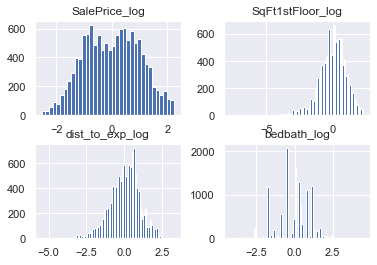

In [862]:
model18, X18, y18 = get_model(continuous17, binary_cols15, categoricals15, no_outliers)
model18.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:          SalePrice_log   R-squared:                       0.826
Model:                            OLS   Adj. R-squared:                  0.824
Method:                 Least Squares   F-statistic:                     484.1
Date:                Wed, 03 Mar 2021   Prob (F-statistic):               0.00
Time:                        14:54:57   Log-Likelihood:                -6807.8
No. Observations:               12484   AIC:                         1.386e+04
Df Residuals:                   12362   BIC:                         1.477e+04
Df Model:                         121                                         
Covariance Type:            nonrobust                                         
=========================================================================================
                            coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                    -1.4789      0.189     -7.839      0.000      -1.849      -1.109
SqFt1stFloor_log          0.0821      0.007     11.982      0.000       0.069       0.096
dist_to_exp_log          -0.1210      0.010    -11.607      0.000      -0.141      -0.101
bedbath_log               0.0369      0.020      1.803      0.071      -0.003       0.077
ZipCode_98002            -0.1628      0.039     -4.130      0.000      -0.240      -0.086
ZipCode_98003             0.0112      0.036      0.311      0.756      -0.059       0.082
ZipCode_98004             2.5219      0.074     33.927      0.000       2.376       2.668
ZipCode_98005             1.8208      0.069     26.237      0.000       1.685       1.957
ZipCode_98006             1.5143      0.044     34.746      0.000       1.429       1.600
ZipCode_98007             1.6665      0.056     29.522      0.000       1.556       1.777
ZipCode_98008             1.7547      0.041     42.794      0.000       1.674       1.835
ZipCode_98010             0.2114      0.079      2.686      0.007       0.057       0.366
ZipCode_98011             1.1621      0.044     26.406      0.000       1.076       1.248
ZipCode_98014             1.2366      0.061     20.378      0.000       1.118       1.355
ZipCode_98019             1.1594      0.053     21.939      0.000       1.056       1.263
ZipCode_98022             0.1994      0.042      4.702      0.000       0.116       0.282
ZipCode_98023            -0.0177      0.033     -0.542      0.588      -0.081       0.046
ZipCode_98024             1.4642      0.079     18.535      0.000       1.309       1.619
ZipCode_98027             1.3616      0.045     30.121      0.000       1.273       1.450
ZipCode_98028             1.1278      0.040     28.192      0.000       1.049       1.206
ZipCode_98029             1.6234      0.045     36.152      0.000       1.535       1.711
ZipCode_98030            -0.0749      0.045     -1.681      0.093      -0.162       0.012
ZipCode_98031            -0.0319      0.041     -0.771      0.441      -0.113       0.049
ZipCode_98032            -0.0572      0.048     -1.188      0.235      -0.152       0.037
ZipCode_98033             1.9843      0.040     49.367      0.000       1.906       2.063
ZipCode_98034             1.4230      0.034     42.114      0.000       1.357       1.489
ZipCode_98038             0.3160      0.034      9.173      0.000       0.248       0.384
ZipCode_98040             2.0887      0.073     28.544      0.000       1.945       2.232
ZipCode_98042            -0.1251      0.039     -3.176      0.001      -0.202      -0.048
ZipCode_98045             1.1104      0.047     23.789      0.000       1.019       1.202
ZipCode_98047            -0.0458      0.084     -0.542      0.588      -0.211       0.120
ZipCode_98051          

<AxesSubplot:>

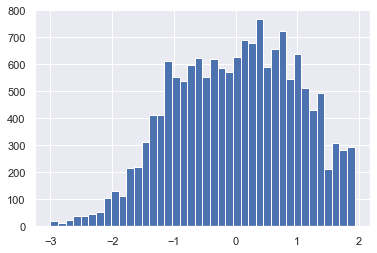

In [880]:
sns.set()
normalize(np.log(data_2019_homes[(data_2019_homes['SalePrice'] >200000) &(data_2019_homes['SalePrice'] <1200000)]['SalePrice'])).hist(bins='auto')

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:          SalePrice_log   R-squared:                       0.824
Model:                            OLS   Adj. R-squared:                  0.822
Method:                 Least Squares   F-statistic:                     485.5
Date:                Wed, 03 Mar 2021   Prob (F-statistic):               0.00
Time:                        15:39:09   Log-Likelihood:                -6879.9
No. Observations:               12484   AIC:                         1.400e+04
Df Residuals:                   12364   BIC:                         1.489e+04
Df Model:                         119                                         
Covariance Type:            nonrobust                                         
=========================================================================================
                            coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                    -1.3773      0.189     -7.269      0.000      -1.749      -1.006
dist_to_exp_log          -0.1176      0.010    -11.223      0.000      -0.138      -0.097
bedbath_log               0.0378      0.006      6.545      0.000       0.026       0.049
ZipCode_98002            -0.1624      0.040     -4.097      0.000      -0.240      -0.085
ZipCode_98003             0.0143      0.036      0.395      0.693      -0.057       0.085
ZipCode_98004             2.5358      0.075     33.926      0.000       2.389       2.682
ZipCode_98005             1.8442      0.070     26.433      0.000       1.707       1.981
ZipCode_98006             1.5247      0.044     34.793      0.000       1.439       1.611
ZipCode_98007             1.6605      0.057     29.251      0.000       1.549       1.772
ZipCode_98008             1.7655      0.041     42.824      0.000       1.685       1.846
ZipCode_98010             0.2241      0.079      2.831      0.005       0.069       0.379
ZipCode_98011             1.1736      0.044     26.524      0.000       1.087       1.260
ZipCode_98014             1.2452      0.061     20.405      0.000       1.126       1.365
ZipCode_98019             1.1666      0.053     21.953      0.000       1.062       1.271
ZipCode_98022             0.2084      0.043      4.887      0.000       0.125       0.292
ZipCode_98023            -0.0156      0.033     -0.475      0.634      -0.080       0.049
ZipCode_98024             1.4710      0.079     18.515      0.000       1.315       1.627
ZipCode_98027             1.3772      0.045     30.307      0.000       1.288       1.466
ZipCode_98028             1.1382      0.040     28.301      0.000       1.059       1.217
ZipCode_98029             1.6229      0.045     35.937      0.000       1.534       1.711
ZipCode_98030            -0.0672      0.045     -1.499      0.134      -0.155       0.021
ZipCode_98031            -0.0197      0.042     -0.473      0.636      -0.101       0.062
ZipCode_98032            -0.0591      0.048     -1.220      0.223      -0.154       0.036
ZipCode_98033             1.9939      0.040     49.345      0.000       1.915       2.073
ZipCode_98034             1.4254      0.034     41.948      0.000       1.359       1.492
ZipCode_98038             0.3189      0.035      9.204      0.000       0.251       0.387
ZipCode_98040             2.1070      0.074     28.639      0.000       1.963       2.251
ZipCode_98042            -0.1132      0.040     -2.858      0.004      -0.191      -0.036
ZipCode_98045             1.1126      0.047     23.702      0.000       1.021       1.205
ZipCode_98047            -0.0403      0.085     -0.474      0.636      -0.207       0.126
ZipCode_98051             0.8202      0.085      9.634      0.000       0.653       0.987
ZipCode_98052          

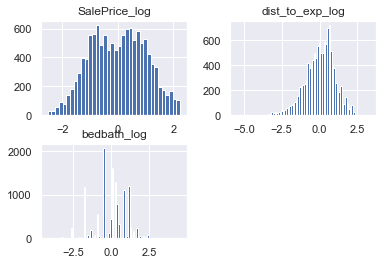

In [887]:
model19, X19, y19 = get_model(continuous18, binary_cols18, categoricals15, no_outliers)
model19.summary()

In [881]:
categoricals15

['ZipCode',
 'HeatSystem',
 'Condition',
 'BldgGrade',
 'Bedrooms',
 'QuarterSection']

In [882]:
continuous17

['SalePrice', 'SqFt1stFloor', 'dist_to_exp', 'bedbath']

In [883]:
binary_cols15

['has_porch',
 'has_basement',
 'has_garage',
 'renovation',
 'has_deck',
 'MtRainier',
 'Olympics',
 'Cascades',
 'Territorial',
 'SeattleSkyline',
 'PugetSound',
 'LakeWashington',
 'LakeSammamish',
 'SmallLakeRiverCreek',
 'OtherView',
 'WfntLocation',
 'duplex',
 'age_norm',
 'bathrooms',
 'total_living_norm']

In [885]:
continuous18 = ['SalePrice', 'dist_to_exp', 'bedbath']

In [886]:
binary_cols18 =  ['has_porch',
 'has_basement',
 'has_garage',
 'renovation',
 'has_deck',
 'MtRainier',
 'Olympics',
 'Cascades',
 'Territorial',
 'SeattleSkyline',
 'PugetSound',
 'LakeWashington',
 'LakeSammamish',
 'SmallLakeRiverCreek',
 'OtherView',
 'WfntLocation',
 'duplex',
 'age_norm',
 'total_living_norm']

In [889]:
from itertools import combinations
regression = LinearRegression()
crossvalidation = KFold(n_splits=10, shuffle=True, random_state=1)

interactions = []

combs = combinations(X19.columns, 2)

data = X19.copy()

for i, (a,b) in enumerate(combs):
    data['interaction'] = data[a]*data[b]
    crossval = np.mean(cross_val_score(regression, data, y19, scoring='r2', cv=crossvalidation))
    interactions.append([a,b,crossval])

interactions

[['dist_to_exp_log', 'bedbath_log', -1.2642406090615395e+22],
 ['dist_to_exp_log', 'ZipCode_98002', -1.0595719305959758e+22],
 ['dist_to_exp_log', 'ZipCode_98003', -1.1003163211054396e+22],
 ['dist_to_exp_log', 'ZipCode_98004', -1.0880167627720137e+22],
 ['dist_to_exp_log', 'ZipCode_98005', -1.0798280441770155e+22],
 ['dist_to_exp_log', 'ZipCode_98006', -1.1696645523947559e+22],
 ['dist_to_exp_log', 'ZipCode_98007', -1.07513331859938e+22],
 ['dist_to_exp_log', 'ZipCode_98008', -1.074348842826559e+22],
 ['dist_to_exp_log', 'ZipCode_98010', -1.0814567128803272e+22],
 ['dist_to_exp_log', 'ZipCode_98011', -1.0673222830719767e+22],
 ['dist_to_exp_log', 'ZipCode_98014', -1.0585293808255623e+22],
 ['dist_to_exp_log', 'ZipCode_98019', -1.0543683990829134e+22],
 ['dist_to_exp_log', 'ZipCode_98022', -1.1009919403838472e+22],
 ['dist_to_exp_log', 'ZipCode_98023', -1.0600133709223848e+22],
 ['dist_to_exp_log', 'ZipCode_98024', -1.081106175189786e+22],
 ['dist_to_exp_log', 'ZipCode_98027', -2.92054

In [891]:
print('Top 3 interactions: %s' %sorted(interactions, key=lambda x: x[2], reverse=True)[:150])

Top 3 interactions: [['HeatSystem_forced_air', 'Bedrooms_8', -140368040153660.45], ['Condition_3', 'Bedrooms_8', -140368040153660.45], ['BldgGrade_7', 'Bedrooms_8', -140368040153660.45], ['Bedrooms_8', 'has_basement', -140368040153660.45], ['Bedrooms_8', 'has_deck', -140368040153660.45], ['ZipCode_98074', 'BldgGrade_11', -2.1327009089455286e+20], ['HeatSystem_forced_air', 'BldgGrade_11', -2.1327009089455286e+20], ['Condition_3', 'BldgGrade_11', -2.1327009089455286e+20], ['BldgGrade_11', 'Bedrooms_3', -2.1327009089455286e+20], ['BldgGrade_11', 'has_garage', -2.1327009089455286e+20], ['BldgGrade_11', 'has_deck', -2.1327009089455286e+20], ['BldgGrade_11', 'Territorial', -2.1327009089455286e+20], ['BldgGrade_11', 'LakeSammamish', -2.1327009089455286e+20], ['BldgGrade_11', 'duplex', -2.1327009089455286e+20], ['bedbath_log', 'BldgGrade_11', -2.1327047954589522e+20], ['BldgGrade_11', 'total_living_norm', -2.132713307306416e+20], ['dist_to_exp_log', 'BldgGrade_11', -2.132720360371306e+20], ['B

In [892]:
zip_cull.columns

Index(['id', 'DocumentDate', 'SalePrice', 'Address', 'BuildingNumber',
       'DirectionPrefix', 'StreetName', 'StreetType', 'DirectionSuffix',
       'ZipCode', 'Stories', 'BldgGrade', 'SqFt1stFloor', 'SqFtHalfFloor',
       'SqFt2ndFloor', 'SqFtUpperFloor', 'SqFtTotLiving', 'SqFtTotBasement',
       'SqFtGarageBasement', 'SqFtGarageAttached', 'DaylightBasement',
       'SqFtOpenPorch', 'SqFtEnclosedPorch', 'SqFtDeck', 'HeatSystem',
       'HeatSource', 'BrickStone', 'Bedrooms', 'BathHalfCount',
       'Bath3qtrCount', 'BathFullCount', 'YrBuilt', 'YrRenovated', 'Condition',
       'Township', 'Section', 'QuarterSection', 'Area', 'DistrictName',
       'SqFtLot', 'Access', 'StreetSurface', 'InadequateParking',
       'TrafficNoise', 'address', 'location', 'point', 'renovation',
       'dist_to_exp', 'has_basement', 'has_garage', 'has_porch', 'has_deck',
       'WfntLocation', 'MtRainier', 'Olympics', 'Cascades', 'Territorial',
       'SeattleSkyline', 'PugetSound', 'LakeWashington', 'L

In [1]:
zip_cull.SqFtTotLiving.max()

NameError: name 'zip_cull' is not defined